In [1]:
import pandas as pd
import numpy as np
import os
import matplotlib.pyplot as plt
import seaborn as sns
import datetime
import matplotlib.font_manager as fm
import matplotlib as mpl
from matplotlib import rc
from scipy.stats import mannwhitneyu
import datetime
import json
import pickle
from tqdm import tqdm
import warnings
import lightgbm as lgb
import math
import random
import pdb
import re
from collections import defaultdict
from sklearn.model_selection import StratifiedKFold

from sklearn.metrics import *
from sklearn.model_selection import KFold
from imblearn.over_sampling import SMOTE

warnings.filterwarnings(action='ignore')




def make_datetime(x):
    # string 타입의 Time column을 datetime 타입으로 변경
    x     = str(x)
    year  = int(x[:4])
    month = int(x[4:6])
    day   = int(x[6:8])
    hour  = int(x[8:10])
    #mim  = int(x[10:12])
    #sec  = int(x[12:])
    return dt.datetime(year, month, day, hour)

def string2num(x):
    # (,)( )과 같은 불필요한 데이터 정제
    x = re.sub(r"[^0-9]+", '', str(x))
    if x =='':
        return 0
    else:
        return int(x)

def split_time(x):
    x = str(x)
    year = x[:4]
    month = x[4:6]
    day = x[6:8]
    hour = x[8:10]
    minute = x[10:12]
    second = x[12:14]
    return year, month, day, hour, minute, second

def make_time_cols(df_):
    years, months, days, hours, minutes, seconds, dates = [], [], [], [], [], [], []
    times = df_['time'].tolist()
    for i in range(len(times)):
        x = times[i]
        year, month, day, hour, minute, second = split_time(x)
        years.append(int(year))
        months.append(int(month))
        days.append(int(day))
        hours.append(int(hour))
        minutes.append(int(minute))
        seconds.append(int(second))
        dates.append(datetime.datetime.strptime(str(x), "%Y%m%d%H%M%S"))
    
    df_['year'] = years
    df_['month'] = months
    df_['day'] = days
    df_['hour']=hours
    df_['minute'] = minutes
    df_['second']= seconds
    df_['date'] = dates
    return df_


def add_time_cols(df_):
    df_ = make_time_cols(df_)
    df_['weeknum'] = df_['date'].apply(lambda x: x.weekday())
    df_['weekend'] = df_['weeknum'].apply(lambda x: 1 if x >=5 else 0)
    df_['md'] = df_['month'].apply(lambda x: str(x).zfill(2)) + df_['day'].apply(lambda x: str(x).zfill(2))
    return df_

def assign_md(x):
    return int(str(x.month).zfill(2)+str(x.day).zfill(2))

In [2]:
default_path = os.getcwd()
data_path = os.path.join(default_path,'data')

In [3]:
def processing_train_test(data_path, option='train'):
    """
    raw file들에 data 객체를 넣어주고 quality의 경우 fwver값이 nan인 경우 수정함
    
    input
    ----------------------------
    data_path : data가 있는 path
    option : train or test
    """
    if option == 'train':
        err_name = 'train_err_data'
        qua_name = 'train_quality_data'
        prob_name = 'train_problem_data'
    elif option == 'test':
        err_name = 'test_err_data'
        qua_name = 'test_quality_data'
    
    df_err = pd.read_csv(data_path+f'/{err_name}.csv')
    df_err['errcode'] = df_err['errcode'].astype('str')
    df_qua = pd.read_csv(data_path+f'/{qua_name}.csv')
    
    # quality 값들에서 쉼표 없애고 숫자 형태로 만드는 과정
    for i in range(13):
        df_qua[f'quality_{i}'] = df_qua[f'quality_{i}'].apply(lambda x: re.sub(r"[^-0-9]+", '', str(x)) if type(x) == str else x)
        df_qua[f'quality_{i}'] = df_qua[f'quality_{i}'].astype(float)
    
    # 타입 변환
    df_err['errcode'] = df_err['errcode'].astype(str)
    df_err['fwver'] = df_err['fwver'].astype(str)
    df_err['model_nm'] = df_err['model_nm'].astype(str)
    
    df_qua['fwver'] = df_qua['fwver'].astype(str)
    
    
    files = [f'{err_name}_c', f'{qua_name}_c']
    temp_dfs = [df_err, df_qua]
    
    if option == 'train':
        files.append(f'{prob_name}_c')
        
        df_prob = pd.read_csv(data_path+f'/{prob_name}.csv')
        temp_dfs.append(df_prob)
    
    for i in range(len(files)):
        file = files[i]
        if not os.path.isfile(f'{data_path}/{file}.csv'):
            temp_dfs[i] = add_time_cols(temp_dfs[i])
            
            # quality data 처리
            if 'quality_data' in file:
                temp_dfs[i]['md'] = temp_dfs[i]['md'].astype(int)
                
                # 나온 결과들을 가지고 quality 데이터의 fwver 수정함
                qua_result_df = processing_quality_data_fwver(temp_dfs[0], temp_dfs[i])
                for j in range(len(qua_result_df)):
                    t_user_id = qua_result_df.iloc[j]['user_id']
                    t_date = qua_result_df.iloc[j]['date']
                    t_fwver = qua_result_df.iloc[j]['fwver']
                    
                    target_inds = temp_dfs[i][(temp_dfs[i]['user_id']==t_user_id)&(df_qua['date']==t_date)].index.tolist()
                    temp_dfs[i].loc[target_inds,'fwver'] = t_fwver
            
            
            temp_dfs[i].to_csv(f'{data_path}/{file}.csv', index=False)
            temp_dfs[i] = pd.read_csv(f'{data_path}/{file}.csv', parse_dates=['date'])
        
        # i번째 파일까지만 만들어진 경우 : 만들어진 파일을 불러옴
        else:
            temp_dfs[i] = pd.read_csv(f'{data_path}/{file}.csv', parse_dates=['date'])

In [4]:
def processing_quality_data_fwver(err_df, qua_df):
    """
    quality 데이터 처리, error 데이터에 없고 quality data에만 있는 user의 경우를 찾아 fwver 값을 다시 넣음
    
    input
    ---------------------
    err_df : error 데이터
    qua_df : quality 데이터
    
    """
    
    # 각 user_id 중 quality data와 error data의 fwver가 다른 경우 검사 대상으로 함
    errs = []
    
    g_temp_qua = qua_df.groupby(['date','md','fwver','user_id']).size().to_frame('size').reset_index()
    errs = np.unique(g_temp_qua[g_temp_qua['fwver']=='nan']['user_id']).tolist()
    
    result_qua_df = pd.DataFrame({'user_id':[],'date':[],'fwver':[]})
    
    # 각 id에 대해 검사함
    for id_ in tqdm(errs):
        
        # 각 id에서 error data의 fwver, quality data의 unique한 fwver를 구함
        temp_err = err_df[err_df['user_id']==id_]
        
        temp_qua = g_temp_qua[(g_temp_qua['user_id']==id_)]
        fwver_err = np.unique(temp_err['fwver'])
        fwver_qua = np.unique(temp_qua['fwver'])
        
        if len(fwver_err) == 0:
            if len(fwver_qua) == 1 and fwver_qua[0] == 'nan':
                continue
        
        # quality의 fwver에 nan이 존재할 경우# 나온 결과들을 가지고 quality 데이터의 fwver 수정함
        dates = np.unique(temp_qua['date'])
        for date in dates:
            
            # 현재 fwver이 nan인 quality의 date보다 이전 시기에 있던 error의 fwver를 분석
            t_temp_qua = temp_qua[temp_qua['date']==date]
            t_temp_err = temp_err[temp_err['date']<date].sort_values('date').reset_index(drop=True)
            
            # 만약 error 데이터에서도 해당 date 이전에 fwver이 1개였다면 해당 quality data의 fwver은 지금 나온 error의 fwver로 교체
            if len(t_temp_err) > 0 :
                result_qua_df = result_qua_df.append({'user_id':id_, 'date':date, 
                                                      'fwver':t_temp_err.iloc[-1]['fwver']},
                                                    ignore_index=True)
            
            # 만약 일치하는 error 데이터가 아예 없을 경우
            else :
                # 해당 quality 데이터의 date 이후 기준, 가장 근접한 error date를 기준으로 fwver로 만듦
                t_temp_err = temp_err[temp_err['date']>date].sort_values('date').reset_index(drop=True)
                t_temp_err_fwver = np.unique(t_temp_err['fwver'])
                

                result_qua_df = result_qua_df.append({'user_id':id_, 'date':date, 
                                                      'fwver':t_temp_err.iloc[0]['fwver']},
                                                    ignore_index=True)

    
    return result_qua_df




def processing_not_fwver_in_errors_but_quality(err_df, qua_df):
    """
    특정 user에 대해 err에는 없으나 quality 데이터에서 새로운 fwver이 나온 기록이 있을 경우 찾아주는 함수
    
    input
    ---------------------
    err_df : error 데이터
    qua_df : quality 데이터
    
    """
    

    errs = []
    
    g_temp_qua = qua_df.groupby(['date','md','fwver','user_id']).size().to_frame('size').reset_index()
    
    # 해당하는 user_id의 quality fwver와 error fwver의 합집합(unique) 개수와 error fwver의 개수가 
    # 일치하지 않을 경우 검사 대상에 추가함  
    for id_ in tqdm(np.unique(g_temp_qua['user_id'])):
        fwver_err = np.unique(err_df[err_df['user_id']==id_]['fwver'])
        len_err_fwver = len(fwver_err)
        
        fwver_qua = np.unique(g_temp_qua[g_temp_qua['user_id']==id_]['fwver'])

        try:
            if len(np.union1d(fwver_err, fwver_qua)) != len_err_fwver :

                errs.append(id_)
        except:
            pdb.set_trace()
         
    return errs




def processing_temp_change_df(err_df, qua_df, temp_list):
    """
    특정 user에 대해 err에는 없으나 quality 데이터에서 새로운 fwver이 나온 기록이 있을 경우
    
    input
    ---------------------------------------
    
    err_df : err data
    
    qua_df : quality data
    
    temp_list : processing_not_fwver_in_errors_but_quality 함수로 나온 결과값
    """
    
    temp_change_df = pd.DataFrame({'id':[],'upgrade':[],'downgrade':[],
                                  'change_model':[],'change_version':[],
                                  'change_all':[], 'model':[], 'version':[]})
    
    model_fwver_df = err_df.groupby(['model_nm','fwver']).size().to_frame('size').reset_index().drop('size',axis=1)
    
    for id_ in tqdm(temp_list):
        temp_err = err_df[err_df['user_id']==id_]
        temp_qua = qua_df[qua_df['user_id']==id_]
        fwver_err = np.unique(temp_err['fwver'])
        fwver_qua = np.unique(temp_qua['fwver'])
        
        # quality error의 fwver을 순서대로 나열함
        fwvers = []
        t_temp_err = temp_err[temp_err['user_id']==id_][['date','fwver']].sort_values('date').reset_index(drop=True)
        fwvers = t_temp_err.drop('date',axis=1).drop_duplicates()['fwver'].tolist()
        
        t_temp_qua = temp_qua[temp_qua['user_id']==id_][['date','fwver']].sort_values('date').reset_index(drop=True)
        qua_fwvers = t_temp_qua.drop('date',axis=1).drop_duplicates()['fwver'].tolist()
        
        # 만약 quality data의 fwver이 error data의 fwver를 포함하는 경우 quality로 fwver 값을 취급함
        if len(np.intersect1d(fwvers, qua_fwvers)) == len(fwvers):
            fwvers = qua_fwvers[:]
            
        # 서로 교차하는 경우
        else:
            
            target_fwver_qua = np.setdiff1d(fwver_qua, fwvers)
            
            for fwver in target_fwver_qua:
                
                if fwver in fwvers:
                    continue
                
                # error data에 포함되지 않은 fwver이 quality에서 최초로 나온 날
                date = temp_qua[temp_qua['fwver']==fwver].iloc[0]['date']
                
                # 특정 quality fwver을 error에서 나온 fwver의 날짜와 비교함
                for i in range(len(fwvers)):
                    fwver_err = fwvers[i]

                    # 만약 error에서 나온 fwver의 마지막 날보다 quality data에서 나온 fwver값이 작으면 그 값 사이에 fwver를 넣음
                    err_date = temp_err[temp_err['fwver']==fwver_err].iloc[-1]['date']
                    if date < err_date:
                        fwvers = fwvers[:i] + [fwver] + fwvers[i:]
                        break
                        
            # 다 처리했는데도 남은경우 : 맨 끝에 있는 값들이므로 뒤에 넣음
            if len(np.setdiff1d(fwver_qua, fwvers)) > 0:
                for fwver in np.setdiff1d(fwver_qua, fwvers):
                    if fwver != 'nan':
                        fwvers.append(fwver)
        
        
        upgrade = 0
        downgrade = 0
        change_model = 0
        change_version = 0
        change_all = 0
        
        # 만약 past version이 09.17.1431인 경우 : train err에서 아예 없던 version이므로 model_100이라는 새로운 데이터로 전환함
        past_version = fwvers[0]
        
        if past_version == '09.17.1431':

            past_model = 'model_100'
        else:
            past_model = model_fwver_df[model_fwver_df['fwver']==past_version]['model_nm'].squeeze()
        
        models = []
        models.append(past_model)
        for i in range(1,len(fwvers)):

            cur_version = fwvers[i]
            if cur_version == '09.17.1431':
                cur_model = 'model_100'
            else:
                cur_model = model_fwver_df[model_fwver_df['fwver']==cur_version]['model_nm'].squeeze()
            
            
            if past_model != cur_model:
                models.append(cur_model)
                change_model +=1
                change_all +=1


            if past_version != cur_version:
                change_version +=1

                past_version_f = past_version.split('.')
                past_version_f = float(past_version_f[0] + '.' + ''.join(past_version_f[1:]))

                cur_version_f = cur_version.split('.')
                cur_version_f = float(cur_version_f[0] + '.' + ''.join(cur_version_f[1:]))

                if past_model == cur_model and past_version_f > cur_version_f:
                    downgrade +=1
                elif past_model == cur_model and past_version_f < cur_version_f:
                    upgrade +=1
                change_all +=1  

            past_version = cur_version
            past_model = cur_model
        
        fwvers = '_'.join(fwvers)
        models = '_'.join(models)

        temp_change_df = temp_change_df.append({'id':id_,'upgrade':upgrade,'downgrade':downgrade,
                                  'change_model':change_model,'change_version':change_version,
                                  'change_all':change_all, 'version':fwvers, 'model':models}, ignore_index=True)
    return temp_change_df

In [5]:
def make_change_dict(err_df, qua_df, data_path, option = 'train'):

    change_dict = {}
    change_dict['id'] = []
    change_dict['upgrade'] = []
    change_dict['downgrade'] = []
    change_dict['change_model'] = []
    change_dict['change_version'] = []
    change_dict['change_all'] = []
    change_dict['model'] = []
    change_dict['version'] = []
    all_ids = np.unique(err_df['user_id'])
    
    if not os.path.isfile(f"{data_path}/{option}_upgrade_dict.json"):
        for id_ in tqdm(all_ids):
            temp_df = err_df[err_df['user_id']==id_].sort_values('date').reset_index(drop=True)
            
            unique_model = np.unique(temp_df['model_nm'])
            unique_version = np.unique(temp_df['fwver'])
            
            if len(unique_model) != 1 or len(unique_version)!=1:
                
                past_version = temp_df.loc[0,'fwver']
                past_model = temp_df.loc[0,'model_nm']
                upgrade = 0
                downgrade = 0
                change_model = 0
                change_version = 0
                change_all = 0

                for i in range(1,len(temp_df)):
                    cur_version = temp_df.loc[i,'fwver']
                    cur_model = temp_df.loc[i,'model_nm']

                    if past_model != cur_model:
                        change_model +=1
                        change_all +=1

                        
                    if past_version != cur_version:
                        change_version +=1
                        
                        past_version_f = past_version.split('.')
                        past_version_f = float(past_version_f[0] + '.' + ''.join(past_version_f[1:]))

                        cur_version_f = cur_version.split('.')
                        cur_version_f = float(cur_version_f[0] + '.' + ''.join(cur_version_f[1:]))
                        if past_model == cur_model and past_version_f > cur_version_f:
                            downgrade +=1
                        elif past_model == cur_model and past_version_f < cur_version_f:
                            upgrade +=1
                        change_all +=1  
                        
                    past_version = cur_version
                    past_model = cur_model
                
                versions = '_'.join(temp_df['fwver'].drop_duplicates().tolist())
                models = '_'.join(temp_df['model_nm'].drop_duplicates().tolist())
                
                change_dict['id'].append(id_)
                change_dict['upgrade'].append(upgrade)
                change_dict['downgrade'].append(downgrade)
                change_dict['change_model'].append(change_model)
                change_dict['change_version'].append(change_version)
                change_dict['change_all'].append(change_all)
                change_dict['version'].append(versions)
                change_dict['model'].append(models)
        

        temp_list = processing_not_fwver_in_errors_but_quality(err_df, qua_df)

        temp_change_df = processing_temp_change_df(err_df, qua_df, temp_list)
        
        change_dict['id'] =list(map(int, change_dict['id']))
        
        for i in range(len(temp_change_df)):
            t_id = int(temp_change_df.iloc[i]['id'])
            upgrade = temp_change_df.iloc[i]['upgrade']
            downgrade = temp_change_df.iloc[i]['downgrade']
            change_model = temp_change_df.iloc[i]['change_model']
            change_version = temp_change_df.iloc[i]['change_version']
            change_all = temp_change_df.iloc[i]['change_all']
            versions = temp_change_df.iloc[i]['version']
            models = temp_change_df.iloc[i]['model']
            
            try:
                t_ind = change_dict['id'].index(t_id)
                change_dict['id'][t_ind] = t_id
                change_dict['upgrade'][t_ind] = upgrade
                change_dict['downgrade'][t_ind] = downgrade
                change_dict['change_model'][t_ind] = change_model
                change_dict['change_version'][t_ind] = change_version
                change_dict['change_all'][t_ind] = change_all
                change_dict['version'][t_ind] = versions
                change_dict['model'][t_ind] = models
                
            except ValueError :
                change_dict['id'].append(t_id)
                change_dict['upgrade'].append(upgrade)
                change_dict['downgrade'].append(downgrade)
                change_dict['change_model'].append(change_model)
                change_dict['change_version'].append(change_version)
                change_dict['change_all'].append(change_all)
                change_dict['version'].append(versions)
                change_dict['model'].append(models)
            
            
        
        with open(f"{data_path}/{option}_upgrade_dict.json", "w") as f:
            json.dump(change_dict, f)
    else:
        pass

def assign_hour_cluster(x):
    if x in [19,20,21,22,23,0,1]:
        return 0
    elif x in [2,3,4,5,6]:
        return 1
    else :
        return 2
    
def assign_week(x):
    if int(str(x)[1]) == 0 or x == 1101:
        return -1
    elif int(str(x)[1]) == 1:
        return (int(str(x)[2:]) -2)//7 
    else:
        if x <= 1202:
            return 4
        else:
            return 5

In [6]:
processing_train_test(data_path, 'train')
processing_train_test(data_path, 'test')

In [7]:
train_err = pd.read_csv(data_path+'/train_err_data_c.csv', parse_dates=['date'])
train_err['hour_cluster'] = train_err['hour'].apply(lambda x: assign_hour_cluster(x))
train_err['week_cluster'] = train_err['md'].apply(lambda x: assign_week(x))

test_err = pd.read_csv(data_path+'/test_err_data_c.csv', parse_dates=['date'])
test_err['hour_cluster'] = test_err['hour'].apply(lambda x: assign_hour_cluster(x))
test_err['week_cluster'] = test_err['md'].apply(lambda x: assign_week(x))

train_qua = pd.read_csv(data_path+'/train_quality_data_c.csv', parse_dates=['date'])
test_qua = pd.read_csv(data_path+'/test_quality_data_c.csv', parse_dates=['date'])

train_qua = train_qua.fillna(0)
test_qua = test_qua.fillna(0)

train_qua['hour_cluster'] = train_qua['hour'].apply(lambda x: assign_hour_cluster(x))
train_qua['week_cluster'] = train_qua['md'].apply(lambda x: assign_week(x))

test_qua['hour_cluster'] = test_qua['hour'].apply(lambda x: assign_hour_cluster(x))
test_qua['week_cluster'] = test_qua['md'].apply(lambda x: assign_week(x))

In [8]:

if not os.path.isfile(f"{data_path}/train_upgrade_dict.json"):
    make_change_dict(train_err, train_qua, data_path, option = 'train')

if not os.path.isfile(f"{data_path}/test_upgrade_dict.json"):
    make_change_dict(test_err, test_qua, data_path, option = 'test')

In [9]:
with open(f"{data_path}/train_upgrade_dict.json", "r") as f:
    train_change_dict = json.load(f)
with open(f"{data_path}/test_upgrade_dict.json", "r") as f:
    test_change_dict = json.load(f)

In [10]:
def extract_change_df(change_dict):

    change_df = pd.DataFrame({'user_id':change_dict['id'], 'upgrade':change_dict['upgrade'],
                         'downgrade':change_dict['downgrade'], 'change_model':change_dict['change_model'],
                         'change_version':change_dict['change_version'],
                         'change_all':change_dict['change_all'], 
                             'model':change_dict['model'],
                             'version':change_dict['version']})
    return change_df

In [11]:
train_change_df = extract_change_df(train_change_dict)
test_change_df = extract_change_df(test_change_dict)

In [12]:
"""
if 'err' not in train_err.columns:
    train_err['err'] = train_err['errtype'].astype(str)+ '_' + train_err['errcode'].astype(str)
errcode_delete_cols = make_delete_errcode_dict(train_err)

if 'err' not in test_err.columns:
    test_err['err'] = test_err['errtype'].astype(str)+ '_' + test_err['errcode'].astype(str)
"""

"\nif 'err' not in train_err.columns:\n    train_err['err'] = train_err['errtype'].astype(str)+ '_' + train_err['errcode'].astype(str)\nerrcode_delete_cols = make_delete_errcode_dict(train_err)\n\nif 'err' not in test_err.columns:\n    test_err['err'] = test_err['errtype'].astype(str)+ '_' + test_err['errcode'].astype(str)\n"

In [13]:
"""
ok_err_list = np.intersect1d(np.unique(train_err['err']), np.unique(test_err['err']))
ok_err_list = np.setdiff1d(ok_err_list, errcode_delete_cols)
"""

"\nok_err_list = np.intersect1d(np.unique(train_err['err']), np.unique(test_err['err']))\nok_err_list = np.setdiff1d(ok_err_list, errcode_delete_cols)\n"

In [14]:
"""
train_err['err'] = train_err['err'].apply(lambda x : x if x in ok_err_list else 'nan_nan')
test_err['err'] = test_err['err'].apply(lambda x : x if x in ok_err_list else 'nan_nan')
"""

"\ntrain_err['err'] = train_err['err'].apply(lambda x : x if x in ok_err_list else 'nan_nan')\ntest_err['err'] = test_err['err'].apply(lambda x : x if x in ok_err_list else 'nan_nan')\n"

## 모델링

In [15]:
def processing_qua(qua_df):
    quality_cols = [f'quality_{i}' for i in range(13)]
    temp_size_qua = qua_df.groupby(['user_id','date']).sum().reset_index()
    temp_size_qua = temp_size_qua.groupby(['user_id']).size().to_frame('quality_num').reset_index()
    temp_size_qua['quality_num'] = temp_size_qua['quality_num'].apply(lambda x: 1 if x != 0 else 0)
    
    temp_mean_qua = qua_df.copy()
    temp_mean_qua = temp_mean_qua.fillna(0)
    temp_mean_qua = temp_mean_qua.groupby(['user_id']).mean().reset_index()[['user_id']+quality_cols]
    f_qua_df = pd.merge(temp_size_qua, temp_mean_qua, on='user_id', how='left')
    return f_qua_df

def make_pivot_table(err_df, col, appear_option = False, test_err_df=None, test_option=False):
    err_pivot = err_df.groupby(['user_id',col]).size().to_frame('size').reset_index()
    err_pivot= pd.pivot_table(err_pivot, index='user_id', columns=[col], values='size').add_prefix(f'col_{col}_')
    err_pivot.index.name = None
    err_pivot.columns.name = None
    err_pivot = err_pivot.fillna(0)
    err_pivot['user_id'] = err_pivot.index.tolist()
    err_pivot = err_pivot.reset_index(drop=True)
    if test_option == True:
        test_unique_values = np.unique(test_err_df[col])
        need_cols = np.setdiff1d(test_unique_values, np.unique(err_df[col]))
        for t_col in need_cols:
            err_pivot[f'col_{col}_{t_col}'] = 0
    
    if appear_option == True:
        for t_col in err_pivot:
            if t_col =='user_id':
                continue
            err_pivot[t_col] = err_pivot[t_col].apply(lambda x: 1 if x != 0 else 0)
    
    return err_pivot


def make_quality_pivot_table(qua_df, date_col, operation1='sum', operation2='mean'):
    quality_cols = ['quality_%s'%(i) for i in range(13)]
    if operation1 == 'sum':
        g_qua_df = qua_df.groupby(['user_id','date',date_col]).sum().reset_index()
    elif operation1 == 'mean':
        g_qua_df = qua_df.groupby(['user_id','date',date_col]).mean().reset_index()
    elif operation1 == 'max':
        g_qua_df = qua_df.groupby(['user_id','date',date_col]).max().reset_index()
    elif operation1 == 'min':
        g_qua_df = qua_df.groupby(['user_id','date',date_col]).min().reset_index()
    elif operation1 == 'std':
        g_qua_df = qua_df.groupby(['user_id','date',date_col]).std().reset_index()

    if operation2 == 'sum':
        t_g_qua_df = g_qua_df.groupby(['user_id',date_col]).sum().reset_index().fillna(0)

    elif operation2 == 'mean':
        t_g_qua_df = g_qua_df.groupby(['user_id',date_col]).mean().reset_index().fillna(0)

    elif operation2 == 'min':
        
        t_g_qua_df = g_qua_df.groupby(['user_id',date_col]).min().reset_index().fillna(0)
    
    elif operation2 == 'max':
        t_g_qua_df = g_qua_df.groupby(['user_id',date_col]).max().reset_index().fillna(0)
    elif operation2 == 'std':
        t_g_qua_df = g_qua_df.groupby(['user_id',date_col]).std().reset_index().fillna(0)
    return t_g_qua_df[['user_id',date_col]+quality_cols]

In [16]:
# 모델 추출
def make_model_df(train_err, col):
    temp_df = train_err.groupby([col,'user_id']).sum().reset_index()
    temp_df = temp_df.groupby([col,'user_id']).size().to_frame('size').reset_index()
    model_pivot = pd.pivot_table(temp_df, index='user_id', columns=col, values='size').fillna(0)
    model_pivot.index.name = None
    model_pivot.columns.name = None
    model_pivot['user_id'] = model_pivot.index.tolist()
    model_pivot = model_pivot.reset_index(drop=True)
    return model_pivot
#model_pivot = make_model_df(train_err, 'model_nm')


def processing_col(test_df, train_df):
    not_train_cols = np.setdiff1d(test_df.columns, train_df.columns)
    add_train_cols = np.setdiff1d(train_df.columns, test_df.columns)
    
    for col in not_train_cols:
        test_df = test_df.drop(col, axis=1)
    for col in add_train_cols:
        test_df[col] = 0
    return test_df


def processing_outliers(err_df, num=5):
    
    # 전체 error기준으로 처리
    all_error_df = err_df.groupby(['user_id']).size().to_frame('size').reset_index()
    mean = np.mean(all_error_df['size'])
    std = np.std(all_error_df['size'])

    all_err_ids = all_error_df[all_error_df['size']>=mean+num*std]['user_id'].tolist()
    
    
    t1 = err_df.groupby(['user_id','errtype']).size().to_frame('size').reset_index()
    f_ids = []
    for i in np.unique(err_df['errtype']):
        t_t1 = t1[t1['errtype']==i]
        mean = np.mean(t_t1['size'])
        std = np.std(t_t1['size'])

        t_ids = t_t1[t_t1['size']>=mean+num*std]['user_id'].tolist()

        f_ids += t_ids
    err_df = err_df[~err_df['user_id'].isin(f_ids)].reset_index(drop=True)
    #err_df = err_df[~err_df['user_id'].isin(all_err_ids)].reset_index(drop=True)
    
    
    return err_df

In [17]:
def check_quality_in_error(err_df, err_qua):
    
    """
    quality 검사를 할 때 검사 중에 error가 포함된 id를 추출함
    """
    
    targets = []
    targets_ids = []
    for t_id in tqdm(np.unique(err_df['user_id'])):
        temp_qua = err_qua[err_qua['user_id']==t_id].reset_index(drop=True)
        temp_err = err_df[err_df['user_id']==t_id].reset_index(drop=True)
        dates = np.unique(temp_qua['date'])
        for date in dates:
            t_temp_qua = temp_qua[temp_qua['date']==date]
            start = date
            end = date + pd.Timedelta(datetime.timedelta(minutes=10*len(t_temp_qua)-1))
            length = len(temp_err[(temp_err['date']>=start)&(temp_err['date']<=end)])
            if  length > 0:
                fwver = t_temp_qua.iloc[0]['fwver']
                targets.append((t_id, pd.to_datetime(date), length, fwver))
                targets_ids.append(t_id)
    
    return targets, targets_ids

def processing_quality_data(err_df, qua_df):
    
    """
    quality 검사 중간에 포함된 error에 대해 각 id별 평균 포함 개수를 구함
    """
    
    targets, _ = check_quality_in_error(err_df, qua_df)
    length_dict = defaultdict(int)
    size_dict = defaultdict(int)
    for i in range(len(targets)):
        id_, _, length, _ = targets[i]
        length_dict[id_] +=length
        size_dict[id_] +=1

    for key in size_dict.keys():

        length_dict[key] /= size_dict[key]
    
    user_df = pd.DataFrame({'user_id':np.unique(err_df['user_id'])})
    result_df = pd.DataFrame({'user_id':[i for i in length_dict.keys()], 'ok_err_size':[i for i in length_dict.values()]})
    result_df = pd.merge(user_df, result_df, on='user_id', how='left').fillna(0)
    

    # 각 등장횟수 추가
    temp_df = qua_df.groupby(['user_id','date','weeknum']).mean().reset_index()
    temp_df = temp_df.groupby(['user_id','weeknum']).size().to_frame('size').reset_index()

    temp_pivot = pd.pivot_table(temp_df, values='size', columns='weeknum', index='user_id').fillna(0).add_prefix('weeknum_size_')
    temp_pivot.index.name = None
    temp_pivot.columns.name = None
    temp_pivot['user_id'] = temp_pivot.index.tolist()
    temp_pivot = temp_pivot.reset_index(drop=True)
    result_df = pd.merge(result_df, temp_pivot, on='user_id', how='left').fillna(0)



    # 주간 quality 값
    temp_df = qua_df.groupby(['user_id','date','weeknum']).sum().reset_index()
    temp_df = temp_df.groupby(['user_id','weeknum']).mean().reset_index()
    quality_cols = ['quality_%s'%i for i in range(13)]
    for q_col in quality_cols:
        
        temp_pivot = pd.pivot_table(temp_df, index='user_id', values=q_col, columns='weeknum').fillna(0)
        temp_pivot.columns = ['%s_weeknum_%s'%(q_col, i) for i in range(7)]
        temp_pivot.index.name = None
        temp_pivot.columns.name = None
        temp_pivot['user_id'] = temp_pivot.index.tolist()
        temp_pivot = temp_pivot.reset_index(drop=True)
        result_df = pd.merge(result_df, temp_pivot, on='user_id', how='left').fillna(0)
    
    
    # week_cluster, hour_cluster 값 추가
        # week
    week_cluster_df = make_quality_pivot_table(qua_df, 'week_cluster', operation1='sum', operation2='mean')
    for t_num in np.unique(week_cluster_df['week_cluster']):
        temp_df = week_cluster_df[week_cluster_df['week_cluster']==t_num]
        temp_df = temp_df[['user_id']+quality_cols]
        temp_df.columns = ['user_id'] + [f'week_cluster_%s_%s'%(t_num,i) for i in quality_cols]
        result_df = pd.merge(result_df, temp_df, on='user_id', how='left').fillna(0)
    
        # hour
    hour_cluster_df = make_quality_pivot_table(qua_df, 'hour_cluster', operation1='sum', operation2='mean')
    for t_num in np.unique(hour_cluster_df['hour_cluster']):
        temp_df = hour_cluster_df[hour_cluster_df['hour_cluster']==t_num]
        temp_df = temp_df[['user_id']+quality_cols]
        temp_df.columns = ['user_id'] + [f'hour_cluster_%s_%s'%(t_num,i) for i in quality_cols]
        result_df = pd.merge(result_df, temp_df, on='user_id', how='left').fillna(0)

    
    return result_df


def processing_err_unit_ratio(err_df, date_col='hour', col='errtype', unique_col_list = ''):
    """
    시간별, 주간별 각 user의 error 비율값을 구함
    """
    
    col_df = ''
    if unique_col_list == '':
        target_errs = np.unique(err_df[col])
    else:
        target_errs = unique_col_list
        
    
    col_df = pd.DataFrame({date_col:np.unique(err_df[date_col])})

    key_col_err = err_df.groupby(['user_id',date_col,col]).size().to_frame('size').reset_index()
    result_df = pd.DataFrame({'user_id':np.unique(err_df['user_id'])})
    
    
    for errtype in np.unique(target_errs):
        temp_df = key_col_err[key_col_err[col]==errtype]
        temp_df = pd.merge(col_df, temp_df, on=date_col, how='left').fillna(0)
        temp_pivot = pd.pivot_table(temp_df, index='user_id', columns=date_col, values='size').add_prefix(f'{col}_{errtype}_{date_col}_').fillna(0)
        #temp_pivot = temp_pivot/np.sum(temp_pivot,axis=1).values.reshape(-1,1)
        temp_pivot.columns.name = None
        temp_pivot.index.name = None
        temp_pivot['user_id'] = temp_pivot.index.tolist()
        temp_pivot = temp_pivot.reset_index(drop=True)
        result_df = pd.merge(result_df, temp_pivot, on='user_id', how='left').fillna(0)
    return result_df


def check_change_model():
    col = 'model_nm'
    user_version_dict = defaultdict(list)
    user_ids = []
    versions = []
    for id_ in tqdm(valid_user_ids):
        temp_err = train_err[train_err['user_id']==id_].sort_values('date')
        temp_err = temp_err[[col]].drop_duplicates()
        result = '_'.join(temp_err[col].tolist())
        user_version_dict[result].append(id_)
        user_ids.append(id_)
        versions.append(result)

In [18]:
def processing_outliers(err_df, num=5):
    
    # 전체 error기준으로 처리
    all_error_df = err_df.groupby(['user_id']).size().to_frame('size').reset_index()
    mean = np.mean(all_error_df['size'])
    std = np.std(all_error_df['size'])

    all_err_ids = all_error_df[all_error_df['size']>=mean+num*std]['user_id'].tolist()
    
    
    t1 = err_df.groupby(['user_id','errtype']).size().to_frame('size').reset_index()
    f_ids = []
    for i in np.unique(err_df['errtype']):
        t_t1 = t1[t1['errtype']==i]
        mean = np.mean(t_t1['size'])
        std = np.std(t_t1['size'])
        
        t_ids = t_t1[t_t1['size']>=mean+num*std]['user_id'].tolist()

        f_ids += t_ids
    err_df = err_df[~err_df['user_id'].isin(f_ids)].reset_index(drop=True)
    #err_df = err_df[~err_df['user_id'].isin(all_err_ids)].reset_index(drop=True)
    
    return err_df

def make_quality_error_data(err_df, qua_df, train_test_option='train'):
    
    unique_qua = qua_df.groupby(['user_id','date']).size().to_frame('size').reset_index()
    unique_qua.columns = ['user_id','date','check_num']
    
    temp_users = unique_qua['user_id'].tolist()
    dates = unique_qua['date'].tolist()
    nums = unique_qua['check_num'].tolist()
    unique_errtypes = np.unique(err_df['errtype'])

    ok_dates = []
    err_dict = defaultdict(list)
    for i in tqdm(range(len(temp_users))):
        target_date = dates[i]
        target_user = temp_users[i]
        target_num = nums[i]
        after = target_date + pd.Timedelta(datetime.timedelta(minutes=10*(target_num-1)))
        result = err_df[(err_df['user_id']==target_user)&(err_df['date']>=target_date)&(err_df['date']<=after)]
        err_results = result.groupby('errtype').size().to_frame('size').reset_index()
        
        no_errs = np.setdiff1d(unique_errtypes, err_results['errtype'])
        for j in range(len(err_results)) :
            errtype = err_results.loc[j,'errtype']
            size = err_results.loc[j,'size']
            err_dict[errtype].append(size)
    
        for errtype in no_errs:
            err_dict[errtype].append(0)

        ok_dates.append((target_user, target_date, target_num, after, len(result)))
    
    target_df = pd.DataFrame({'user_id':[obj[0] for obj in ok_dates],
                         'start_date':[obj[1] for obj in ok_dates],
                         'end_date':[obj[3] for obj in ok_dates],
                         'check_num':[obj[2] for obj in ok_dates],
                         'length':[obj[4] for obj in ok_dates]})
    for key in err_dict.keys():
        target_df[key] = err_dict[key]
        
    with open(data_path+'/%s_target_qua_date.pkl'%(train_test_option), 'wb') as f:
        pickle.dump(target_df, f)
        
def processing_quality_error_data(err_df, qua_df, train_test_option='train') :
    if os.path.isfile(data_path+'/%s_target_qua_date.pkl'%(train_test_option)):
        with open(data_path+'/%s_target_qua_date.pkl'%(train_test_option), 'rb') as f:
            target_df = pickle.load(f)
    else:
        make_quality_error_data(err_df, qua_df, train_test_option=train_test_option)
        with open(data_path+'/%s_target_qua_date.pkl'%(train_test_option), 'rb') as f:
            target_df = pickle.load(f)
    
    quality_cols = ['quality_%s'%(i) for i in range(13)]
    unique_errtypes = np.unique(err_df['errtype'])
    errtype_cols = np.unique(err_df['errtype']).tolist()
    t_qua_df = qua_df.groupby(['user_id','date']).sum().reset_index()
    t_qua_df = t_qua_df[['user_id','date']+quality_cols]
    t_target_df = pd.merge(target_df, t_qua_df, left_on=['user_id','start_date'], right_on=['user_id','date'])
    t_target_df['sum_errs'] = np.sum(t_target_df[unique_errtypes], axis=1)
    
    t_target_df['md'] = t_target_df['start_date'].apply(lambda x: assign_md(x))
    t_target_df['hour'] = t_target_df['start_date'].apply(lambda x: x.hour)
    t_target_df['hour_cluster'] = t_target_df['hour'].apply(lambda x: assign_hour_cluster(x))
    t_target_df['week_cluster'] = t_target_df['md'].apply(lambda x: assign_week(x))
    t_target_df['weeknum'] = t_target_df['start_date'].apply(lambda x: x.weekday())
    
    
    mean_target_df = t_target_df.groupby(['user_id']).mean().reset_index()[['user_id']+quality_cols+errtype_cols+['sum_errs']]
    mean_target_df.columns = ['user_id']+quality_cols+[f'quality_errtype_{i}' for i in errtype_cols]+['sum_errs']
    mean_target_df['quality_checks'] = 1
    
    week_mean_target_df = t_target_df.groupby(['user_id','week_cluster']).mean().reset_index()[['user_id','week_cluster']+quality_cols+errtype_cols+['sum_errs']]
    week_mean_target_df.columns = ['user_id','week_cluster']+quality_cols+[f'quality_errtype_{i}' for i in errtype_cols]+['sum_errs']
    
   
    for i in np.unique(week_mean_target_df['week_cluster']):
        t_week_result_df = week_mean_target_df[week_mean_target_df['week_cluster']==i]
        t_week_result_df = t_week_result_df.drop('week_cluster', axis=1)
        t_week_result_df.columns = ['user_id']+['%s_week_cluster_%s'%(col, i) for col in t_week_result_df.columns[1:]]
        mean_target_df = pd.merge(mean_target_df, t_week_result_df, on='user_id', how='left')
    
    
    
    week_mean_target_df = t_target_df.groupby(['user_id','hour_cluster']).mean().reset_index()[['user_id','hour_cluster']+quality_cols+errtype_cols+['sum_errs']]
    week_mean_target_df.columns = ['user_id','hour_cluster']+quality_cols+[f'quality_errtype_{i}' for i in errtype_cols]+['sum_errs']
    
    for i in np.unique(week_mean_target_df['hour_cluster']):
        t_week_result_df = week_mean_target_df[week_mean_target_df['hour_cluster']==i]
        t_week_result_df = t_week_result_df.drop('hour_cluster', axis=1)
        t_week_result_df.columns = ['user_id']+['%s_hour_cluster_%s'%(col, i) for col in t_week_result_df.columns[1:]]
        mean_target_df = pd.merge(mean_target_df, t_week_result_df, on='user_id', how='left')
    
    
    mean_target_df = mean_target_df.fillna(0)
    
    
    return mean_target_df
    #sum_target_df = t_target_df.groupby(['user_id']).sum().reset_index()[['user_id']+quality_cols+errtype_cols]
    
    
    #sum_target_df.columns = [['user_id']+quality_cols+[f'quality_errtype_{i}' for i in errtype_cols]]
    #sum_target_df['quality_sum_errtype'] = np.sum(sum_target_df[f'quality_errtype_{i}' for i in errtype_cols], axis=1)
    
def make_all_errtype_num_in_periods(err_df):
    errtype_sw_pivot = make_pivot_table(err_df, 'errtype', True)
    errtype_sw_pivot['all_errtype_num_in_periods'] = np.sum(errtype_sw_pivot.iloc[:,:-1], axis=1)
    errtype_sw_pivot = errtype_sw_pivot[['user_id','all_errtype_num_in_periods']]

    t_col_name = 'week_cluster'
    for t_col in np.unique(err_df[t_col_name]):
        t_err_df = err_df[err_df[t_col_name]==t_col].reset_index(drop=True)
        t_errtype_sw_pivot = make_pivot_table(t_err_df, 'errtype', True)
        t_errtype_sw_pivot['t_sum'] = np.sum(t_errtype_sw_pivot.iloc[:,:-1], axis=1)
        t_errtype_sw_pivot = t_errtype_sw_pivot[['user_id','t_sum']]
        t_errtype_sw_pivot.columns = ['user_id','all_errtype_num_in_%s_%s'%(t_col_name, t_col)]
        errtype_sw_pivot = pd.merge(errtype_sw_pivot, t_errtype_sw_pivot,
                                         on='user_id', how='left')
    return errtype_sw_pivot

In [19]:
#train_err = processing_outliers(train_err, num=3)

In [20]:
train_ids = np.unique(train_err['user_id'])
train_users_df = pd.DataFrame({'user_id':train_ids})

In [21]:
#train_err = processing_outliers(train_err)

In [22]:
#train_ids = np.unique(train_err['user_id'])
#train_users_df = pd.DataFrame({'user_id':train_ids})

In [23]:
# errcode 만들기
temp_errcode_df = train_err.groupby(['user_id','errcode']).sum().reset_index()
temp_errcode_df = temp_errcode_df.groupby('errcode').size().to_frame('size').reset_index()
ok_err_codes = temp_errcode_df[temp_errcode_df['size']>100]['errcode'].tolist()
#ok_err_codes = ['scanning timeout','terminate by peer user','Q-64002','P-41007','P-44010','PHONE_ERR','U-82026']
train_errcode = train_err[train_err['errcode'].isin(ok_err_codes)]
train_errcode_pivot = make_pivot_table(train_errcode, 'errcode', False)

In [24]:
train_errtype_pivot = make_pivot_table(train_err, 'errtype')
errtype_cols = [col for col in train_errtype_pivot.columns if 'col_errtype' in col and 'std' not in col and 'mean' not in col]
train_errtype_pivot['col_errtype_std'] = np.std(train_errtype_pivot.loc[:,errtype_cols],axis=1)
#train_errtype_pivot['col_errtype_std'] = np.std(train_errtype_pivot.loc[:,errtype_cols],axis=1) / np.mean(train_errtype_pivot.loc[:,errtype_cols],axis=1)
train_week_cluster_pivot = make_pivot_table(train_err, 'week_cluster', False)
train_hour_cluster_pivot = make_pivot_table(train_err, 'hour_cluster', False)
train_all_error = train_err.groupby(['user_id']).size().to_frame('all_error').reset_index()
#train_model_pivot = make_pivot_table(train_err, 'model_nm', True)
train_fwver_pivot = make_pivot_table(train_err, 'fwver', True)


In [171]:
train_data = pd.DataFrame({'user_id': train_ids})
train_data = pd.merge(train_data, train_errtype_pivot, on='user_id', how='left')
train_data = pd.merge(train_data, train_all_error, on='user_id', how='left')
train_data = pd.merge(train_data, train_week_cluster_pivot, on='user_id', how='left')
train_data = pd.merge(train_data, train_hour_cluster_pivot, on='user_id', how='left')
train_data = pd.merge(train_data, train_fwver_pivot, on='user_id', how='left')
train_data = pd.merge(train_data, train_errcode_pivot, on='user_id', how='left')

#train_data = pd.merge(train_data, train_model_pivot, on='user_id', how='left')
#train_data = pd.merge(train_data, train_model_pivot, on='user_id', how='left')


change 처리

In [172]:
train_data = pd.merge(train_data, train_change_df[['user_id', 'upgrade', 'downgrade', 'change_model', 'change_version', 'change_all']], on='user_id', how='left')

In [173]:
train_change_model_pivot = make_pivot_table(train_change_df, 'model')
train_data = pd.merge(train_data, train_change_model_pivot, on='user_id', how='left')

In [28]:
# qua 합치기
train_qua_pivot1 = processing_quality_data(train_err, train_qua)
#train_qua_pivot2 = processing_quality_error_data(train_err, train_qua, train_test_option='train')

100%|██████████| 15000/15000 [04:11<00:00, 59.53it/s]


In [174]:
train_data = pd.merge(train_data, train_qua_pivot1, on='user_id', how='left').fillna(0)
#train_data = pd.merge(train_data, train_qua_pivot2, on='user_id', how='left').fillna(0)

In [30]:
#train_errtype_sw_pivot = make_all_errtype_num_in_periods(train_err)
#train_data = pd.merge(train_data, train_errtype_sw_pivot, on='user_id', how='left').fillna(0)

In [175]:
# err 시간별, 주간별 만들기
train_hour_cluster_err = processing_err_unit_ratio(train_err, date_col='hour_cluster')
#train_hour_err = processing_err_unit_ratio(train_err, key_col='hour')
train_weeknum_err = processing_err_unit_ratio(train_err, date_col='weeknum')
train_week_cluster_err = processing_err_unit_ratio(train_err, date_col='week_cluster')

train_week_cluster_errcode = processing_err_unit_ratio(train_err, date_col='week_cluster', col='errcode',unique_col_list=ok_err_codes )

In [176]:
train_data = pd.merge(train_data, train_hour_cluster_err, on='user_id', how='left')
train_data = pd.merge(train_data, train_weeknum_err, on='user_id', how='left')
train_data = pd.merge(train_data, train_week_cluster_err, on='user_id', how='left').fillna(0)
train_data = pd.merge(train_data, train_week_cluster_errcode, on='user_id', how='left').fillna(0)

In [177]:
train_prob = pd.read_csv(data_path+'/train_problem_data_c.csv', parse_dates=['date'])
prob_user_ids = np.unique(train_prob['user_id'])

In [178]:
train_data['y'] = train_data['user_id'].apply(lambda x: 1 if x in prob_user_ids else 0)

In [179]:

with open(data_path+'/cv_0.835_features.pkl', 'rb') as f:
    ok_features = pickle.load(f)

train_x = train_data.loc[:,~train_data.columns.isin(['y','user_id'])]
train_x = train_x.loc[:,ok_features]
x_columns = train_x.columns
train_y = train_data[['y']]

In [107]:
"""
with open('columns.pkl', 'wb') as f :
    pickle.dump(train_x, f)
"""

"\nwith open('columns.pkl', 'wb') as f :\n    pickle.dump(train_x, f)\n"

feature importance

In [180]:

train_x

,col_errtype_1,col_errtype_3,col_errtype_4,col_errtype_5,col_errtype_6,col_errtype_7,col_errtype_10,col_errtype_11,col_errtype_12,col_errtype_13,...,errcode_connectionterminated by local host_week_cluster_1,errcode_standby_week_cluster_0,errcode_standby_week_cluster_1,errcode_standby_week_cluster_2,errcode_standby_week_cluster_3,errcode_standby_week_cluster_4,errcode_terminate by peer user_week_cluster_-1,errcode_terminate by peer user_week_cluster_0,errcode_terminate by peer user_week_cluster_1,errcode_terminate by peer user_week_cluster_2
0,0.0,8.0,104.0,0.0,1.0,1.0,7.0,15.0,16.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,53.0,1.0,1.0,0.0,10.0,11.0,1.0,...,0.0,0.0,2.0,19.0,603.0,1.0,0.0,0.0,0.0,0.0
2,0.0,2.0,132.0,1.0,2.0,1.0,1.0,13.0,14.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,2.0,1.0,1.0,0.0,9.0,9.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,1.0,0.0,3.0,4.0,0.0,16.0,19.0,3.0,...,0.0,0.0,0.0,0.0,5.0,0.0,0.0,1.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14995,0.0,0.0,0.0,2.0,5.0,5.0,0.0,5.0,10.0,8.0,...,0.0,0.0,0.0,2.0,5.0,1.0,0.0,0.0,0.0,0.0
14996,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
14997,0.0,0.0,1.0,8.0,1.0,1.0,0.0,16.0,18.0,4.0,...,0.0,0.0,0.0,4.0,7.0,0.0,0.0,0.0,0.0,0.0
14998,0.0,0.0,0.0,0.0,0.0,0.0,0.0,15.0,15.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [108]:
#del train_errtype_pivot, train_md_pivot, train_all_error, train_model_pivot,train_errcode_pivot, train_qua_pivot, train_hour_err, train_weeknum_err

In [212]:
#models, auc_scores = modeling(train_data, train_x, train_y, max_bin=250, num_leaves=70, max_depth=13, lambda_l2=0.001)
#models, auc_scores = modeling(train_data, train_x, train_y, max_bin=1100, num_leaves=70, max_depth=21, lambda_l2=0.001,save_option=True, save_name='test1')
def f_pr_auc(probas_pred, y_true):
    labels=y_true.get_label()
    p, r, _ = precision_recall_curve(labels, probas_pred)
    score=auc(r,p) 
    return "pr_auc", score, True

def modeling(train_data, train_x, train_y, lambda_l2=0, min_data_in_leaf=20,
            max_bin=255, feature_fraction=1, bagging_fraction=1,
            num_leaves=10, max_depth=-1, lr=0.1, save_option = False,
            save_name='best_model', k_fold_option = 'normal', seed=1015,
            over_sampling = False, over_ratio = 1):
    #-------------------------------------------------------------------------------------
    models     = []
    recalls    = []
    precisions = []
    auc_scores   = []
    threshold = 0.5
    n_splits = 5
    # 파라미터 설정
    #max_depth=6
    params =      {
                    'boosting_type' : 'gbdt',
                    'objective'     : 'binary',
                    'metric'        : 'auc',
                    'seed': seed,
                    'n_estimators':10000,
                    'lambda_l2': lambda_l2,
                    'min_data_in_leaf':min_data_in_leaf,
                    'max_bin':max_bin,
                    'feature_fraction':feature_fraction,
                    'bagging_fraction':bagging_fraction,
                    'max_depth':max_depth,
                    'num_leaves':num_leaves,
                    #'num_iterations':1000,
                    'learning_rate':lr,
                    'force_col_wise':'true',
                    #'device':'gpu'
                    }
    #-------------------------------------------------------------------------------------
    # 5 Kfold cross validation
    # k_fold = KFold(n_splits=n_splits, shuffle=True, random_state=420)
    if k_fold_option == 'normal':
        k_fold = KFold(n_splits=n_splits, shuffle=True, random_state=seed)
        k_splits = k_fold.split(train_x)
    elif k_fold_option == 'straight':
        k_fold = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state = seed)
        k_splits = k_fold.split(train_x, train_y)
    
    
    
    trains = []
    valids = []
    for train_idx, val_idx in k_splits:

        trains.append(train_idx)
        valids.append(val_idx)
        
        # split train, validation set
        X = train_x.loc[train_idx,:]
        y = train_y.loc[train_idx,:]
        
        if over_sampling == True:
            smote = SMOTE(random_state=seed, sampling_strategy=over_ratio)
            X,y = smote.fit_sample(X,y)
        
        
        valid_x = train_x.loc[val_idx,:]
        valid_y = train_y.loc[val_idx,:]

        d_train= lgb.Dataset(X, y)
        d_val  = lgb.Dataset(valid_x, valid_y)
        
        #run traning
        model = lgb.train(
                            params,
                            train_set       = d_train,
                            num_boost_round = 1000,
                            valid_sets      = d_val,
                            feval           = f_pr_auc,
                            verbose_eval    = 30, 
                            early_stopping_rounds = 10,
                            #force_col_wise='true'
                           )
        
        # cal valid prediction
        valid_prob = model.predict(valid_x)
        valid_pred = np.where(valid_prob > threshold, 1, 0)

        # cal scores
        recall    = recall_score(    valid_y, valid_pred)
        precision = precision_score( valid_y, valid_pred)
        auc_score = roc_auc_score(   valid_y, valid_prob)

        # append scores
        models.append(model)
        recalls.append(recall)
        precisions.append(precision)
        auc_scores.append(auc_score)
        
        
        print('==========================================================')
        
    if save_option == True:
        result_dict = {}
        result_dict['model'] = models
        result_dict['data'] = {}
        result_dict['data']['train_x'] = train_x
        result_dict['data']['train_y'] = train_y
        result_dict['data']['train_data'] = train_data

        result_dict['data']['train_inds'] = trains
        result_dict['data']['valid_inds'] = valids

        result_dict['param'] = {}
        result_dict['param']['max_bin'] = max_bin
        result_dict['param']['num_leaves'] = num_leaves
        result_dict['param']['max_depth'] = max_depth
        result_dict['param']['lambda_l2'] = lambda_l2
        
        result_dict['result'] = {}
        result_dict['result']['precision'] = precisions
        result_dict['result']['recall'] = recalls
        result_dict['result']['auc_score'] = auc_scores
        
        
        with open(default_path+f'/result/%s.pkl'%(save_name), 'wb') as f:
            pickle.dump(result_dict, f)

    return models, auc_scores



In [ ]:
#models1, auc_scores1 = modeling(train_x1, train_y1)
#models2, auc_scores2 = modeling(train_x2, train_y2)

#models, auc_scores = modeling(train_data, train_x, train_y, max_bin=50, num_leaves=68, max_depth=16, lambda_l2=0.001, save_option=True, save_name='auc_0.84117')
#models, auc_scores = modeling(train_data, train_x, train_y, max_bin=50, num_leaves=76, max_depth=8, lambda_l2=0.001, save_option=True, save_name='auc_0.84122')
#models, auc_scores = modeling(train_data, X_train_over, y_train_over, max_bin=10, num_leaves=53, max_depth=20, lambda_l2=0.001)

# lambda_l2 : 0.001, bin : 10.0, max_depth : 9.0, leaves :30.0, auc : 0.835011
# 0.002	10.0	55.0	7.0	0.90
# models, auc_scores = modeling(train_data, train_x, train_y, max_bin=10, num_leaves=55, max_depth=7, lambda_l2=0.002, feature_fraction=0.9, k_fold_option='straight', save_option=True, save_name='cv_0.835')
models, auc_scores = modeling(train_data, train_x, train_y, max_bin=10, num_leaves=54, max_depth=13, lambda_l2=0.002, feature_fraction=0.85, k_fold_option='straight', over_sampling = True, over_ratio = 0.6, save_option=True, save_name='auc_0.84314')

results = []
best_score = 0

# 0.002	10.0	54.0	13.0	0.85	0.835897
"""
for over_ratio in np.arange(0.55,1.01, 0.01):
    over_ratio = np.round(over_ratio,2)
    models, auc_scores = modeling(train_data, train_x, train_y, max_bin=10, num_leaves=54, max_depth=13, feature_fraction=0.85, lambda_l2=0.002, k_fold_option='straight', over_sampling = True, over_ratio = over_ratio)
    results.append(np.mean(auc_scores))
    
    pred_y_list = []
    for model in models:
        pred_y = model.predict(test_x)
        pred_y_list.append(pred_y.reshape(-1,1))

    pred_ensemble = np.mean(pred_y_list, axis = 0)
    
    if best_score < np.mean(auc_scores):
        best_score = np.mean(auc_scores)
        with open(default_path+f'/result/best_score.pkl', 'wb') as f:
            pickle.dump(pred_ensemble, f)
"""

In [200]:
# lambda_l2 : 0.001, bin : 10.0, max_depth : 9.0, leaves :30.0, auc : 0.835011
print(np.mean(auc_scores))

0.8351032


In [ ]:
results

In [ ]:
"""
result_dict = {}
result_dict['model'] = models
result_dict['train_data'] = train_data
result_dict['param'] = {}
result_dict['param']['max_bin'] = 1100
result_dict['param']['num_leaves'] = 70
result_dict['param']['max_depth'] = 21
result_dict['param']['lambda_l2'] = 0.001

with open(default_path+f'/result/auc_0.8303.pkl', 'wb') as f:
    pickle.dump(result_dict, f)
"""

In [42]:
test_ids = np407.unique(test_err['user_id'])
test_errtype_pivot = make_pivot_table(test_err, 'errtype')

#test_errtype_pivot['col_errtype_std'] =  np.std(test_errtype_pivot.loc[:,errtype_cols],axis=1) / np.mean(test_errtype_pivot.loc[:,errtype_cols],axis=1)
test_errtype_pivot['col_errtype_std'] =  np.std(test_errtype_pivot.loc[:,errtype_cols],axis=1)
test_model_pivot = make_pivot_table(test_err, 'model_nm', True)
test_fwver_pivot = make_pivot_table(test_err, 'fwver', True)


test_all_error = test_err.groupby(['user_id']).size().to_frame('all_error').reset_index()

test_week_cluster_pivot = make_pivot_table(test_err, 'week_cluster', False)
test_hour_cluster_pivot = make_pivot_table(test_err, 'hour_cluster', False)


In [43]:
# errcode 만들기est
test_errcode = test_err[test_err['errcode'].isin(ok_err_codes)]
test_errcode_pivot = make_pivot_table(test_errcode, 'errcode', True)

In [181]:
test_data = pd.DataFrame({'user_id': test_ids})
test_data = pd.merge(test_data, test_errtype_pivot, on='user_id', how='left')
test_data = pd.merge(test_data, test_all_error, on='user_id', how='left')
test_data = pd.merge(test_data, test_week_cluster_pivot, on='user_id', how='left')
test_data = pd.merge(test_data, test_hour_cluster_pivot, on='user_id', how='left')
test_data = pd.merge(test_data, test_fwver_pivot, on='user_id', how='left')
test_data = pd.merge(test_data, test_errcode_pivot, on='user_id', how='left')

In [182]:
test_data = pd.merge(test_data, test_change_df[['user_id', 'upgrade', 'downgrade', 'change_model', 'change_version', 'change_all']], on='user_id', how='left')

In [183]:
test_change_model_pivot = make_pivot_table(test_change_df, 'model')
test_data = pd.merge(test_data, test_change_model_pivot, on='user_id', how='left')

In [47]:
test_qua_pivot1 = processing_quality_data(test_err, test_qua)
#test_qua_pivot2 = processing_quality_error_data(test_err, test_qua, train_test_option='test')

100%|██████████| 14998/14998 [03:52<00:00, 64.51it/s]


In [48]:
#test_errtype_sw_pivot = make_all_errtype_num_in_periods(test_err)
#test_data = pd.merge(test_data, test_errtype_sw_pivot, on='user_id', how='left')

In [184]:
# err 시간별, 주간별 만들기
# err 시간별, 주간별 만들기
test_hour_cluster_err = processing_err_unit_ratio(test_err, date_col='hour_cluster')
#train_hour_err = processing_err_unit_ratio(train_err, key_col='hour')
test_weeknum_err = processing_err_unit_ratio(test_err, date_col='weeknum')
test_week_cluster_err = processing_err_unit_ratio(test_err, date_col='week_cluster')
test_week_cluster_errcode = processing_err_unit_ratio(test_err, date_col='week_cluster', col='errcode',unique_col_list=ok_err_codes )


In [185]:
test_data = pd.merge(test_data, test_hour_cluster_err, on='user_id', how='left')
test_data = pd.merge(test_data, test_weeknum_err, on='user_id', how='left')
test_data = pd.merge(test_data, test_week_cluster_err, on='user_id', how='left')
test_data = pd.merge(test_data, test_week_cluster_errcode, on='user_id', how='left')

In [186]:
test_data = pd.merge(test_data, test_qua_pivot1, on='user_id', how='left').fillna(0)
#test_data = pd.merge(test_data, test_qua_pivot2, on='user_id', how='left').fillna(0)

In [187]:
test_x = test_data.loc[:,~test_data.columns.isin(['y','user_id'])]
test_x = processing_col(test_x, train_x)
test_x = test_x.loc[:,train_x.columns]

In [188]:
test_x

,col_errtype_1,col_errtype_3,col_errtype_4,col_errtype_5,col_errtype_6,col_errtype_7,col_errtype_10,col_errtype_11,col_errtype_12,col_errtype_13,...,errcode_connectionterminated by local host_week_cluster_1,errcode_standby_week_cluster_0,errcode_standby_week_cluster_1,errcode_standby_week_cluster_2,errcode_standby_week_cluster_3,errcode_standby_week_cluster_4,errcode_terminate by peer user_week_cluster_-1,errcode_terminate by peer user_week_cluster_0,errcode_terminate by peer user_week_cluster_1,errcode_terminate by peer user_week_cluster_2
0,0.0,0.0,0.0,62.0,1.0,1.0,0.0,16.0,16.0,0.0,...,0.0,0.0,0.0,3.0,1.0,0.0,0.0,0.0,0.0,0.0
1,0.0,3.0,98.0,3.0,4.0,4.0,0.0,12.0,16.0,4.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,79.0,2.0,1.0,0.0,16.0,16.0,0.0,...,0.0,0.0,0.0,0.0,5.0,1.0,0.0,1.0,0.0,0.0
3,0.0,0.0,0.0,107.0,2.0,2.0,0.0,4.0,5.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,2.0,6.0,1.0,1.0,0.0,10.0,12.0,1.0,...,0.0,0.0,0.0,0.0,3.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14993,0.0,0.0,2.0,12.0,5.0,5.0,0.0,16.0,19.0,3.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
14994,0.0,0.0,0.0,0.0,2.0,2.0,0.0,14.0,15.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
14995,0.0,0.0,0.0,0.0,1.0,1.0,0.0,12.0,13.0,1.0,...,0.0,0.0,0.0,1.0,9.0,1.0,0.0,0.0,1.0,1.0
14996,0.0,0.0,1.0,4.0,2.0,2.0,0.0,15.0,16.0,0.0,...,0.0,0.0,0.0,0.0,2.0,18.0,0.0,1.0,0.0,0.0


In [96]:
#del test_errtype_pivot, test_md_pivot, test_all_error, test_model_pivot,test_errcode_pivot, test_qua_pivot, test_hour_err, test_weeknum_err

In [190]:
result_df = pd.DataFrame({'lambda_l2':[],'bin':[], 'leaves':[], 'max_depth':[],
                          'feature_fraction':[],'auc':[]})
best_score = 0
lambda_l2 = 0.001
#[10,255]
for max_bin in range(10,11,10):
    #[0.001,0.002]
    for lambda_l2 in [0.001, 0.002]:
        #range(50,101)
        for num_leaves in range(50,81):
            start_max_depth = 7
            end_max_depth = int(num_leaves*0.3)
            
            #range(start_max_depth, end_max_depth)
            for max_depth in range(start_max_depth, end_max_depth):
                
                # [0.8,0.85,0.9,0.95,1.0]
                for feature_fraction in [0.8,0.85,0.9,0.95,1.0]:
                    
                    file_name = f'l2_{lambda_l2}-bin_{max_bin}-ff_{feature_fraction}-'
                    file_name += f'max_depth_{max_depth}-leaves_{num_leaves}-lambda_l2_{lambda_l2}'
                    models, auc_scores = modeling(train_data, train_x, train_y, max_bin=max_bin, num_leaves = num_leaves,
                                                 lambda_l2 = lambda_l2, max_depth= max_depth, k_fold_option='straight',
                                                 feature_fraction=feature_fraction)
                    """

                    models, auc_scores = modeling_no_cv(train_data, train_x, train_y, max_bin=max_bin, num_leaves = num_leaves,
                                                 lambda_l2 = lambda_l2, max_depth= max_depth)
                    """
np.mean(auc_scores)

                    pred_y_list = []
                    for model in models:
                        pred_y = model.predict(test_x)
                        pred_y_list.append(pred_y.reshape(-1,1))

                    pred_ensemble = np.mean(pred_y_list, axis = 0)


                    plt.figure(figsize=(15,9))
                    sns.distplot(pred_ensemble)
                    plt.savefig(default_path+f'/result/graph/{file_name}.jpg')
                    plt.clf()
                    plt.close()
                    
                    result_df = result_df.append({'lambda_l2':lambda_l2, 
                                                  'bin':max_bin, 'leaves':num_leaves, 'max_depth':max_depth,
                                                  'feature_fraction':feature_fraction,
                                                 'auc':np.mean(auc_scores)},
                                                 ignore_index=True)
                    if len(result_df) % 100 == 0:
                        with open(default_path+f'/result/result_df_new_importance.pkl', 'wb') as f:
                            pickle.dump(result_df, f)

                    if best_score < np.mean(auc_scores):
                        best_score = np.mean(auc_scores)
                        result_dict = {}
                        result_dict['model'] = models
                        result_dict['data'] = {}
                        result_dict['data']['train_x'] = train_x
                        result_dict['data']['train_y'] = train_y
                        result_dict['data']['train_data'] = train_data

                        result_dict['param'] = {}
                        result_dict['param']['max_bin'] = max_bin
                        result_dict['param']['num_leaves'] = num_leaves
                        result_dict['param']['max_depth'] = max_depth
                        result_dict['param']['lambda_l2'] = lambda_l2
                        result_dict['param']['feature_fraction'] = feature_fraction
                        
                        result_dict['result'] = {}
                        result_dict['result']['auc_score'] = auc_scores
                        result_dict['pred']= pred_ensemble

                        with open(default_path+f'/result/best_score.pkl', 'wb') as f:
                            pickle.dump(result_dict, f)

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.820614	valid_0's pr_auc: 0.749562
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.836147	valid_0's pr_auc: 0.767008
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[28]	valid_0's auc: 0.836204	valid_0's pr_auc: 0.768175
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_na

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.844831	valid_0's pr_auc: 0.768676
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[12]	valid_0's auc: 0.833255	valid_0's pr_auc: 0.760708
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number o

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.848805	valid_0's pr_auc: 0.775771
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.826604	valid_0's pr_auc: 0.747089
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[24]	valid_0's auc: 0.82711	valid_0's pr_auc: 0.747317
[L

Early stopping, best iteration is:
[17]	valid_0's auc: 0.838584	valid_0's pr_auc: 0.764245
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.820308	valid_0's pr_auc: 0.747878
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.847093	valid_0's pr_auc: 0.767125
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.820195	valid_0's pr_auc: 0.753654
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[11]	valid_0's auc: 0.810109	valid_0's pr_auc: 0.746141
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.847896	valid_0's pr_auc: 0.766755
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.851079	valid_0's pr_auc: 0.778043
[LightGBM] [Warning] No further splits with positive gain, best

Early stopping, best iteration is:
[19]	valid_0's auc: 0.815673	valid_0's pr_auc: 0.745227
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's auc: 0.822758	valid_0's pr_auc: 0.741638
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used fea

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.822229	valid_0's pr_auc: 0.750139
Early stopping, best iteration is:
[55]	valid_0's auc: 0.821891	valid_0's pr_auc: 0.751134
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[10]	valid_0's auc: 0.835461	valid_0's pr_auc: 0.773822
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of n

[30]	valid_0's auc: 0.817049	valid_0's pr_auc: 0.748883
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[33]	valid_0's auc: 0.817935	valid_0's pr_auc: 0.750819
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.838903	valid_0's pr_auc: 0.773546
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning]

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.848631	valid_0's pr_auc: 0.769382
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[26]	valid_0's auc: 0.848691	valid_0's pr_auc: 0.772306
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[L

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's auc: 0.829075	valid_0's pr_auc: 0.747138
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[19]	valid_0's auc: 0.823898	valid_0's pr_auc: 0.742054
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.828496	valid_0's pr_auc: 0.743968
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[31]	valid_0's auc: 0.828821	valid_0's pr_auc: 0.7453
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.853015	valid_0's pr_auc: 0.775063
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] N

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.852002	valid_0's pr_auc: 0.776324
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[42]	valid_0's auc: 0.854427	valid_0's pr_auc: 0.781389
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in 

[30]	valid_0's auc: 0.85087	valid_0's pr_auc: 0.772393
Early stopping, best iteration is:
[28]	valid_0's auc: 0.851074	valid_0's pr_auc: 0.772577
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.819392	valid_0's pr_auc: 0.75002
Early stopping, best iteration is:
[22]	valid_0's auc: 0.816844	valid_0's pr_auc: 0.750679
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightG

[30]	valid_0's auc: 0.819041	valid_0's pr_auc: 0.752167
Early stopping, best iteration is:
[38]	valid_0's auc: 0.819403	valid_0's pr_auc: 0.753297
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's auc: 0.838467	valid_0's pr_auc: 0.771907
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of

Early stopping, best iteration is:
[16]	valid_0's auc: 0.835602	valid_0's pr_auc: 0.77127
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[12]	valid_0's auc: 0.812267	valid_0's pr_auc: 0.736383
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used feat

[30]	valid_0's auc: 0.822469	valid_0's pr_auc: 0.752596
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.827005	valid_0's pr_auc: 0.758538
Early stopping, best iteration is:
[53]	valid_0's auc: 0.827198	valid_0's pr_auc: 0.757563
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.829948	valid_0's pr_auc: 0.74561
Early stopping, best iteration is:
[40]	valid_0's auc: 0.830523	valid_0's pr_auc: 0.750829
[LightGBM] [Warning] Fin

Early stopping, best iteration is:
[17]	valid_0's auc: 0.825068	valid_0's pr_auc: 0.742073
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.850403	valid_0's pr_auc: 0.773791
Early stopping, best iteration is:
[26]	valid_0's auc: 0.850366	valid_0's pr_auc: 0.775151
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[33]	valid_0's auc: 0.829533	valid_0's pr_auc: 0.748671
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM]

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[9]	valid_0's auc: 0.799549	valid_0's pr_auc: 0.736909
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.818768	valid_0's pr_auc: 0.746132
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[30]	valid_0's auc: 0.839499	valid_0's pr_auc: 0.768221
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[26]	valid_0's auc: 0.839719	valid_0's pr_auc: 0.769843
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.821913	valid_0's pr_auc: 0.746693
[LightGBM] [Warning]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[90]	valid_0's auc: 0.827713	valid_0's pr_auc: 0.756819
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[83]	valid_0's auc: 0.829366	valid_0's pr_auc: 0.758339
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pav

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's auc: 0.841002	valid_0's pr_auc: 0.765845
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[12]	valid_0's auc: 0.811434	valid_0's pr_auc: 0.745464
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.81983	valid_0's pr_auc: 0.749948
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.825632	valid_0's pr_auc: 0.753183
Early stopping, best iteration is:
[52]	valid_0's auc: 0.825295	valid_0's pr_auc: 0.754514
[LightGBM] [Warning] Find whitespaces in feature

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.846024	valid_0's pr_auc: 0.76835
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with p

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's auc: 0.835177	valid_0's pr_auc: 0.769724
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.821164	valid_0's pr_auc: 0.754649
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[30]	valid_0's auc: 0.821164	valid_0's pr_auc: 0.754649
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.85066	valid_0's pr_auc: 0.768666
Early stopping, best iteration is:
[26]	valid_0's auc: 0.851351	valid_0's pr_auc: 0.774815
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.850388	valid_0's pr_auc: 0.773034
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[36]	valid_0's auc: 0.851123	valid_0's pr_auc: 0.777367
[

[30]	valid_0's auc: 0.850496	valid_0's pr_auc: 0.772418
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[41]	valid_0's auc: 0.851411	valid_0's pr_auc: 0.777869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[

[30]	valid_0's auc: 0.849872	valid_0's pr_auc: 0.775354
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.852904	valid_0's pr_auc: 0.784036
Early stopping, best iteration is:
[52]	valid_0's auc: 0.853519	valid_0's pr_auc: 0.782703
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Traini

[30]	valid_0's auc: 0.849062	valid_0's pr_auc: 0.77144
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.85314	valid_0's pr_auc: 0.777744
Early stopping, best iteration is:
[50]	valid_0's auc: 0.853552	valid_0's pr_auc: 0.779963
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.821102	valid_0's pr_auc: 0.750965
Early stopping, best iteration is:
[21]	valid_0's auc: 0.818677	valid_0's pr_auc: 0.753618
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Fin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820227	valid_0's pr_auc: 0.750763
Early stopping, best iteration is:
[31]	valid_0's auc: 0.820872	valid_0's pr_auc: 0.752294
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Fin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.839472	valid_0's pr_auc: 0.770323
Early stopping, best iteration is:
[20]	valid_0's auc: 0.838626	valid_0's pr_auc: 0.772216
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

Early stopping, best iteration is:
[16]	valid_0's auc: 0.835615	valid_0's pr_auc: 0.768975
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[8]	valid_0's auc: 0.807533	valid_0's pr_auc: 0.735636
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used feat

[30]	valid_0's auc: 0.820966	valid_0's pr_auc: 0.751646
Early stopping, best iteration is:
[41]	valid_0's auc: 0.825426	valid_0's pr_auc: 0.758652
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.82495	valid_0's pr_auc: 0.740127
Early stopping, best iteration is:
[21]	valid_0's auc: 0.825552	valid_0's pr_auc: 0.746067
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Light

[30]	valid_0's auc: 0.831315	valid_0's pr_auc: 0.747516
Early stopping, best iteration is:
[30]	valid_0's auc: 0.831315	valid_0's pr_auc: 0.747516
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.849941	valid_0's pr_auc: 0.775993
Early stopping, best iteration is:
[27]	valid_0's auc: 0.850047	valid_0's pr_auc: 0.776654
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.846111	valid_0's pr_auc: 0.770089
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[30]	valid_0's auc: 0.818629	valid_0's pr_auc: 0.749682
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[30]	valid_0's auc: 0.814848	valid_0's pr_auc: 0.741785
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[71]	valid_0's auc: 0.823088	valid_0's pr_auc: 0.748422
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818861	valid_0's pr_auc: 0.743658
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.81966	valid_0's pr_auc: 0.748706
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[11]	valid_0's auc: 0.821295	valid_0's pr_auc: 0.738993
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.817343	valid_0's pr_auc: 0.746078
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[90]	valid_0's auc: 0.855783	valid_0's pr_auc: 0.786439
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.817272	valid_0's pr_auc: 0.741898
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.819442	valid_0's pr_auc: 0.748642
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[71]	valid_0's auc: 0.826566	valid_0's pr_auc: 0.756443
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.827996	valid_0's pr_auc: 0.742287
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

Early stopping, best iteration is:
[19]	valid_0's auc: 0.837723	valid_0's pr_auc: 0.773124
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's auc: 0.816317	valid_0's pr_auc: 0.747113
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used fea

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.82125	valid_0's pr_auc: 0.753741
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[29]	valid_0's auc: 0.821635	valid_0's pr_auc: 0.754523
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.821818	valid_0's pr_auc: 0.747029
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.826372	valid_0's pr_auc: 0.757809
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[61]	valid_0's auc: 0.826546

[30]	valid_0's auc: 0.839855	valid_0's pr_auc: 0.774336
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[45]	valid_0's auc: 0.840955	valid_0's pr_auc: 0.775328
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820145	valid_0's pr_auc: 0.746814
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[16]	valid_0's auc: 0.840609	valid_0's pr_auc: 0.772503
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.820076	valid_0's pr_auc: 0.751066
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[48]	valid_0's auc: 0.822889	valid_0's pr_auc: 0.757564
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[18]	valid_0's auc: 0.836124	valid_0's pr

[30]	valid_0's auc: 0.821789	valid_0's pr_auc: 0.756384
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[38]	valid_0's auc: 0.822916	valid_0's pr_auc: 0.758565
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[12]	valid_0's auc: 0.839125	valid_0's pr_auc: 0.772955
[LightGBM] [Warning] Find whitespaces in feature_names, repl

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.838639	valid_0's pr_auc: 0.766328
Early stopping, best iteration is:
[36]	valid_0's auc: 0.839511	valid_0's pr_auc: 0.771817
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[7]	valid_0's auc: 0.808209	valid_0's pr_auc: 0.736426
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[19]	valid_0's auc: 0.827512	valid_0's pr_auc: 0.745807
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


Early stopping, best iteration is:
[16]	valid_0's auc: 0.824981	valid_0's pr_auc: 0.742608
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.854315	valid_0's pr_auc: 0.778668
[60]	valid_0's auc: 0.85649	valid_0's pr_auc: 0.785085
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[63]	valid_0's auc: 0.857089	valid_0's pr_auc: 0.786037
[Ligh

[30]	valid_0's auc: 0.850276	valid_0's pr_auc: 0.772055
Early stopping, best iteration is:
[46]	valid_0's auc: 0.852893	valid_0's pr_auc: 0.78032
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818504	valid_0's pr_auc: 0.751727
Early stopping, best iteration is:
[38]	valid_0's auc: 0.820794	valid_0's pr_auc: 0.756208
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Light

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[34]	valid_0's auc: 0.847892	valid_0's pr_auc: 0.773012
[LightGBM

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[78]	valid_0's auc: 0.852656	valid_0's pr_auc: 0.78335
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain,

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.840617	valid_0's pr_auc: 0.771452
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[22]	valid_0's auc: 0.839955	valid_0's pr_auc: 0.773129
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.841978	valid_0's pr_auc: 0.770417
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.814698	valid_0's pr_auc: 0.738861
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[23]	valid_0's auc: 0.812745	valid_0's pr_auc: 0.73996
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Li

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.818281	valid_0's pr_auc: 0.746298
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[10]	valid_0's auc: 0.832829	valid_0's pr_auc: 0.767292
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.848075	valid_0's pr_auc: 0.771637
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.817225	valid_0's pr_auc: 0.747494
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[32]	valid_0's auc: 0.817796	valid_0's pr_auc: 0.748957
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[9]	valid_0's auc: 0.836733	valid_0's pr_

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[60]	valid_0's auc: 0.822943	valid_0's pr_auc: 0.756618
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[12]	valid_0's auc: 0.820262	valid_0's pr_auc: 0.741555
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGB

[30]	valid_0's auc: 0.820138	valid_0's pr_auc: 0.752825
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[45]	valid_0's auc: 0.822963	valid_0's pr_auc: 0.758434
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pav

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.821442	valid_0's pr_auc: 0.754745
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[37]	valid_0's auc: 0.822989	valid_0's pr_auc: 0.756364
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[L

[30]	valid_0's auc: 0.848827	valid_0's pr_auc: 0.769631
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.850692	valid_0's pr_auc: 0.778393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[16]	valid_0's auc: 0.829293	valid_0's pr_auc: 0.749757
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.8183	valid_0's pr_auc: 0.746903
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.82371	valid_0's pr_auc: 0.756442
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[56]	valid_0's auc: 0.824235	valid_0's pr_auc: 0.75704
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with under

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[10]	valid_0's auc: 0.831368	valid_0's pr_auc: 0.770729
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.823213	valid_0's pr_auc: 0.75018
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[41]	valid_0's auc: 0.824859	valid_0's pr_auc: 0.753526
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in t

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818464	valid_0's pr_auc: 0.746408
Early stopping, best iteration is:
[26]	valid_0's auc: 0.819738	valid_0's pr_auc: 0.743117
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[19]	valid_0's auc: 0.826789	valid_0's pr_auc: 0.742766
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.828114	valid_0's pr_auc: 0.747944
Early stopping, best iteration is:
[29]	valid_0's auc: 0.827623	valid_0's pr_auc: 0.74807
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.854177	valid_0's pr_auc: 0.778784
Early stopping, best iteration is:
[28]	valid_0's auc: 0.854059	valid_0's pr_auc: 0.779994
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Light

[30]	valid_0's auc: 0.852255	valid_0's pr_auc: 0.773392
Early stopping, best iteration is:
[28]	valid_0's auc: 0.851652	valid_0's pr_auc: 0.775414
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820303	valid_0's pr_auc: 0.751393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[37]	valid_0's auc: 0.822521	valid_0's pr_auc: 0.756529
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines

[30]	valid_0's auc: 0.819563	valid_0's pr_auc: 0.751289
Early stopping, best iteration is:
[31]	valid_0's auc: 0.820125	valid_0's pr_auc: 0.752789
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.840231	valid_0's pr_auc: 0.77286
Early stopping, best iteration is:
[30]	valid_0's auc: 0.840231	valid_0's pr_auc: 0.77286
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightG

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[24]	valid_0's auc: 0.824995	valid_0's pr_auc: 0.742116
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.815932	valid_0's pr_auc: 0.744118
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[28]	valid_0's auc: 0.81472	valid_0's pr_auc: 0.74615
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number 

[30]	valid_0's auc: 0.847458	valid_0's pr_auc: 0.770646
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[11]	valid_0's auc: 0.839055	valid_0's pr_auc: 0.75951
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[7]	valid_0's auc: 0.799327	valid_0's pr_auc: 0.738336
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.815209	valid_0's pr_auc: 0.741187
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.84684	valid_0's pr_auc: 0.769548
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820928	valid_0's pr_auc: 0.75011
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.817774	valid_0's pr_auc: 0.744869
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.844847	valid_0's pr_auc: 0.76734
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with p

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.840149	valid_0's pr_auc: 0.767674
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[29]	valid_0's auc: 0.840081	valid_0's pr_auc: 0.770077
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underli

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's auc: 0.826582	valid_0's pr_auc: 0.748253
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.826733	valid_0's pr_auc: 0.737251
Early stopping, best iteration is:
[20]	valid_0's auc: 0.82468	valid_0's pr_auc: 0.741372
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[12]	valid_0's auc: 0.833693	valid_0's pr_auc: 0.768065
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.819921	valid_0's pr_auc: 0.750927
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[38]	valid_0's auc: 0.822566	valid_0's pr_auc: 0.752651
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
E

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.817103	valid_0's pr_auc: 0.750907
Early stopping, best iteration is:
[37]	valid_0's auc: 0.817551	valid_0's pr_auc: 0.753375
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Fin

[30]	valid_0's auc: 0.847901	valid_0's pr_auc: 0.763911
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[36]	valid_0's auc: 0.850171	valid_0's pr_auc: 0.771815
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.822828	valid_0's pr_auc: 0.753355
[LightGBM] [Warning]

[30]	valid_0's auc: 0.850795	valid_0's pr_auc: 0.773935
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[40]	valid_0's auc: 0.852848	valid_0's pr_auc: 0.781128
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820999	valid_0's pr_auc: 0.754425
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[35]	valid_0's auc: 0.82161	valid_0's pr_auc: 0.755779
[Ligh

[30]	valid_0's auc: 0.819481	valid_0's pr_auc: 0.753568
Early stopping, best iteration is:
[36]	valid_0's auc: 0.821352	valid_0's pr_auc: 0.755348
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.839276	valid_0's pr_auc: 0.767803
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning]

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.840621	valid_0's pr_auc: 0.771699
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[37]	valid_0's auc: 0.843206	valid_0's pr_auc: 0.774479
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in 

Early stopping, best iteration is:
[12]	valid_0's auc: 0.838944	valid_0's pr_auc: 0.763029
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[11]	valid_0's auc: 0.813087	valid_0's pr_auc: 0.739866
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used fea

[30]	valid_0's auc: 0.815952	valid_0's pr_auc: 0.744307
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[46]	valid_0's auc: 0.818936	valid_0's pr_auc: 0.750927
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[19]	valid_0's auc: 0.827245	valid_0's pr_auc: 0.74342
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of ne

[30]	valid_0's auc: 0.824325	valid_0's pr_auc: 0.737719
Early stopping, best iteration is:
[21]	valid_0's auc: 0.822638	valid_0's pr_auc: 0.741107
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.848397	valid_0's pr_auc: 0.770248
Early stopping, best iteration is:
[26]	valid_0's auc: 0.848907	valid_0's pr_auc: 0.77345
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Light

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.821639	valid_0's pr_auc: 0.755023
Early stopping, best iteration is:
[31]	valid_0's auc: 0.821812	valid_0's pr_auc: 0.755281
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Fin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[10]	valid_0's auc: 0.837244	valid_0's pr_auc: 0.772583
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


Early stopping, best iteration is:
[17]	valid_0's auc: 0.838884	valid_0's pr_auc: 0.77141
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[10]	valid_0's auc: 0.807635	valid_0's pr_auc: 0.734954
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used feat

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.839305	valid_0's pr_auc: 0.766912
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[41]	valid_0's auc: 0.826878	valid_0's pr_auc: 0.744372
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Star

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.817484	valid_0's pr_auc: 0.747081
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.840696	valid_0's pr_auc: 0.773138
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[51]	valid_0's auc: 0.841241	valid_0's pr_auc: 0.773824
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.844685	valid_0's pr_auc: 0.767596
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.825863	valid_0's pr_auc: 0.73517
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, be

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's auc: 0.820965	valid_0's pr_auc: 0.740783
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.821197	valid_0's pr_auc: 0.744509
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.826811	valid_0's pr_auc: 0.759306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.821043	valid_0's pr_auc: 0.753046
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.838867	valid_0's pr_auc: 0.767707
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

Early stopping, best iteration is:
[13]	valid_0's auc: 0.824673	valid_0's pr_auc: 0.744411
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.847503	valid_0's pr_auc: 0.769586
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[63]	valid_0's auc: 0.848557	valid_0's pr_auc: 0.775879
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818382	valid_0's pr_auc: 0.746028
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.828451	valid_0's pr_auc: 0.739863
Early stopping, best iteration is:
[20]	valid_0's auc: 0.826233	valid_0's pr_auc: 0.744024
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.819338	valid_0's pr_auc: 0.749296
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[30]	valid_0's auc: 0.846972	valid_0's pr_auc: 0.77031
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.851553	valid_0's pr_auc: 0.778322
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[64]	valid_0's auc: 0.852614	

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's auc: 0.835729	valid_0's pr_auc: 0.769578
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.815416	valid_0's pr_auc: 0.74461
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[37]	valid_0's auc: 0.818608	valid_0's pr_auc: 0.749312
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Ea

Early stopping, best iteration is:
[13]	valid_0's auc: 0.838821	valid_0's pr_auc: 0.77254
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.819631	valid_0's pr_auc: 0.744117
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[27]	valid_0's auc: 0.819507	valid_0's pr_auc: 0.74546
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of neg

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's auc: 0.827403	valid_0's pr_auc: 0.743426
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.848216	valid_0's pr_auc: 0.77071
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[10]	valid_0's auc: 0.817215	valid_0's pr_auc: 0.714664
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.831986	valid_0's pr_auc: 0.745317
Early stopping, best iteration is:
[21]	valid_0's auc: 0.828177	valid_0's pr_auc: 0.746942
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.851655	valid_0's pr_auc: 0.776587
Early stopping, best iteration is:
[38]	valid_0's auc: 0.852528	valid_0's pr_auc: 0.781304
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[30]	valid_0's auc: 0.853358	valid_0's pr_auc: 0.77655
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[26]	valid_0's auc: 0.853696	valid_0's pr_auc: 0.779392
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.814508	valid_0's pr_auc: 0.749663
Early stopping, best iteration is:
[25]	valid_0's auc: 0.815306	valid_0's pr_auc: 0.751217
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.82138	valid_0's pr_auc: 0.74882
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.823897	valid_0's pr_auc: 0.754761
Early stopping, best iteration is:
[62]	valid_0's auc: 0.824605	valid_0's pr_auc: 0.755778
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's auc: 0.837431	valid_0's pr_auc: 0.773164
[Light

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[12]	valid_0's auc: 0.811608	valid_0's pr_auc: 0.737083
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[19]	valid_0's auc: 0.827869	valid_0's pr_auc: 0.744158
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.850262	valid_0's pr_auc: 0.772564
[60]	valid_0's auc: 0.851062	valid_0's pr_auc: 0.77958
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[72]	valid_0's auc: 0.852441	valid_0's pr_auc: 0.78225
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.823469	valid_0's pr_auc: 0.756213
Early stopping, best iteration is:
[32]	v

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[90]	valid_0's auc: 0.8276	valid_0's pr_auc: 0.754768
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[84]	valid_0's auc: 0.828161	valid_0's pr_auc: 0.755265
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[Li

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.820395	valid_0's pr_auc: 0.749315
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[67]	valid_0's auc: 0.852861	valid_0's pr_auc: 0.783819
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[10]	valid_0's auc: 0.837821	valid_0's pr_auc: 0.766959
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.83882	valid_0's pr_auc: 0.769066
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.818642	valid_0's pr_auc: 0.751886
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[30]	valid_0's auc: 0.846453	valid_0's pr_auc: 0.764983
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.847343	valid_0's pr_auc: 0.770503
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[90]	valid_0's auc: 0.85232	valid_0's pr_auc: 0.783068
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[98]	valid

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.840307	valid_0's pr_auc: 0.771517
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.822003	valid_0's pr_auc: 0.751416
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[32]	valid_0's auc: 0.821987	valid_0's pr_auc: 0.752627
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underli

[30]	valid_0's auc: 0.846297	valid_0's pr_auc: 0.765425
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[47]	valid_0's auc: 0.848286	valid_0's pr_auc: 0.773342
[LightGBM] [Warning] Find wh

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820855	valid_0's pr_auc: 0.746796
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.851392	valid_0's pr_auc: 0.77234
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

Early stopping, best iteration is:
[16]	valid_0's auc: 0.827407	valid_0's pr_auc: 0.74737
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.851595	valid_0's pr_auc: 0.773512
Early stopping, best iteration is:
[23]	valid_0's auc: 0.852486	valid_0's pr_auc: 0.774248
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[12]	valid_0's auc: 0.815708	valid_0's pr_auc: 0.744877
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[7]	valid_0's auc: 0.808721	valid_0's pr_auc: 0.737768
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.830468	valid_0's pr_auc: 0.742249
Early stopping, best iteration is:
[20]	valid_0's auc: 0.828924	valid_0's pr_auc: 0.745278
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[30]	valid_0's auc: 0.817346	valid_0's pr_auc: 0.745065
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.819653	valid_0's pr_auc: 0.750908
Early stopping, best iteration is:
[54]	valid_0's auc: 0.820562	valid_0's pr_auc: 0.750881
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.827927	valid_0's pr_auc: 0.740126
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

Early stopping, best iteration is:
[15]	valid_0's auc: 0.813913	valid_0's pr_auc: 0.740535
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's auc: 0.824553	valid_0's pr_auc: 0.745089
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used fea

[30]	valid_0's auc: 0.826721	valid_0's pr_auc: 0.743353
Early stopping, best iteration is:
[22]	valid_0's auc: 0.827631	valid_0's pr_auc: 0.745498
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.851185	valid_0's pr_auc: 0.775159
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[38]	valid_0's auc: 0.854104	valid_0's pr_auc: 0.781467
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines

Early stopping, best iteration is:
[18]	valid_0's auc: 0.848984	valid_0's pr_auc: 0.77155
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.817163	valid_0's pr_auc: 0.749758
Early stopping, best iteration is:
[33]	valid_0's auc: 0.817059	valid_0's pr_auc: 0.753168
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of 

[30]	valid_0's auc: 0.818141	valid_0's pr_auc: 0.754454
Early stopping, best iteration is:
[27]	valid_0's auc: 0.817553	valid_0's pr_auc: 0.754476
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.841367	valid_0's pr_auc: 0.77016
Early stopping, best iteration is:
[22]	valid_0's auc: 0.840368	valid_0's pr_auc: 0.773659
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Light

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[10]	valid_0's auc: 0.812172	valid_0's pr_auc: 0.740643
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.828044	valid_0's pr_auc: 0.743145
Early stopping, best iteration is:
[20]	valid_0's auc: 0.826571	valid_0's pr_auc: 0.745097
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.849733	valid_0's pr_auc: 0.772625
Early stopping, best iteration is:
[30]	valid_0's auc: 0.849733	valid_0's pr_auc: 0.772625
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[29]	valid_0's auc: 0.836609	valid_0's pr_auc: 0.767456
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:B

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[16]	valid_0's auc: 0.814036	valid_0's pr_auc: 0.7482
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightG

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.819196	valid_0's pr_auc: 0.751551
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.846373	valid_0's pr_auc: 0.772391
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[30]	valid_0's auc: 0.815068	valid_0's pr_auc: 0.739973
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.847976	valid_0's pr_auc: 0.768684
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.81915	valid_0's pr_auc: 0.74939
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's auc: 0.825981	valid_0's pr_auc: 0.745247
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.846684	valid_0's pr_auc: 0.766864
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[30]	valid_0's auc: 0.819375	valid_0's pr_auc: 0.745956
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.843697	valid_0's pr_auc: 0.76826
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[8]	valid_0's auc: 0.834788	valid_0's pr_auc: 0.770744
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.819202	valid_0's pr_auc: 0.750442
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

Early stopping, best iteration is:
[16]	valid_0's auc: 0.845495	valid_0's pr_auc: 0.767798
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818371	valid_0's pr_auc: 0.745966
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[33]	valid_0's auc: 0.81948	valid_0's pr_auc: 0.749041
[LightGBM] [Warning] Find whitespaces in feature_names, repla

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.850074	valid_0's pr_auc: 0.766828
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, b

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[12]	valid_0's auc: 0.821576	valid_0's pr_auc: 0.73639
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[30]	valid_0's auc: 0.828445	valid_0's pr_auc: 0.742307
Early stopping, best iteration is:
[39]	valid_0's auc: 0.829596	valid_0's pr_auc: 0.749322
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.851306	valid_0's pr_auc: 0.772454
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best

[30]	valid_0's auc: 0.831783	valid_0's pr_auc: 0.746056
Early stopping, best iteration is:
[28]	valid_0's auc: 0.831816	valid_0's pr_auc: 0.742968
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.84648	valid_0's pr_auc: 0.765256
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] 

[30]	valid_0's auc: 0.827474	valid_0's pr_auc: 0.737838
Early stopping, best iteration is:
[24]	valid_0's auc: 0.826693	valid_0's pr_auc: 0.744942
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.851916	valid_0's pr_auc: 0.770606
Early stopping, best iteration is:
[28]	valid_0's auc: 0.853515	valid_0's pr_auc: 0.771786
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[30]	valid_0's auc: 0.851629	valid_0's pr_auc: 0.77195
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[39]	valid_0's auc: 0.852664	valid_0's pr_auc: 0.777282
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.819447	valid_0's pr_auc: 0.751904
Early stopping, best iteration is:
[25]	valid_0's auc: 0.819915	valid_0's pr_auc: 0.753765
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.820075	valid_0's pr_auc: 0.751086
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[40]	valid_0's auc: 0.821371	valid_0's pr_auc: 0.752911
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's auc: 0.840357	valid_0's pr_auc: 0.768395
[LightGBM] [Warning] Find whitespaces in feature_names, repl

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.838276	valid_0's pr_auc: 0.771879
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[33]	valid_0's auc: 0.838858	valid_0's pr_auc: 0.773524
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.822371	valid_0's pr_auc: 0.749433
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[45]	valid_0's auc: 0.828201	valid_0's pr_auc: 0.759551
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in 

[30]	valid_0's auc: 0.819084	valid_0's pr_auc: 0.74493
Early stopping, best iteration is:
[43]	valid_0's auc: 0.823609	valid_0's pr_auc: 0.756035
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[19]	valid_0's auc: 0.827808	valid_0's pr_auc: 0.742118
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of 

[30]	valid_0's auc: 0.829779	valid_0's pr_auc: 0.745392
Early stopping, best iteration is:
[22]	valid_0's auc: 0.829167	valid_0's pr_auc: 0.746999
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.850569	valid_0's pr_auc: 0.774138
Early stopping, best iteration is:
[35]	valid_0's auc: 0.852552	valid_0's pr_auc: 0.77282
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Light

[30]	valid_0's auc: 0.850078	valid_0's pr_auc: 0.770251
Early stopping, best iteration is:
[44]	valid_0's auc: 0.851177	valid_0's pr_auc: 0.776352
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.819569	valid_0's pr_auc: 0.753032
Early stopping, best iteration is:
[43]	valid_0's auc: 0.821841	valid_0's pr_auc: 0.758648
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[12]	valid_0's auc: 0.836692	valid_0's pr_auc: 0.77234
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[8]	valid_0's auc: 0.807597	valid_0's pr_auc: 0.733168
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[33]	valid_0's auc: 0.819431	valid_0's pr_auc: 0.751363
[LightGBM

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.845524	valid_0's pr_auc: 0.767199
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[14]	valid_0's auc: 0.819844	valid_0's pr_auc: 0.737672
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[Ligh

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.828823	valid_0's pr_auc: 0.741495
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.817515	valid_0's pr_auc: 0.74515
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.840052	valid_0's pr_auc: 0.769468
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[29]	valid_0's auc: 0.840294	valid_0's pr_auc: 0.770111
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[12]	valid_0's auc: 0.824674	valid_0's pr_auc: 0.743545
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.848523	valid_0's pr_auc: 0.769227
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.81927	valid_0's pr_auc: 0.749794
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's auc: 0.823284	valid_0's pr_auc: 0.742734
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's auc: 0.837129	valid_0's pr_auc: 0.772815
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.826917	valid_0's pr_auc: 0.739617
Early stopping, best iteration is:
[20]	valid_0's auc: 0.824016	valid_0's pr_auc: 0.741719
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.848537	valid_0's pr_auc: 0.766085
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[21]	valid_0's auc: 0.847475	valid_0's pr_auc: 0.770277
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.825272	valid_0's pr_auc: 0.742141
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[10]	valid_0's auc: 0.836877	valid_0's pr_auc: 0.772213
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[10]	valid_0's auc: 0.835916	valid_0's pr_auc: 0.770402
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.850697	valid_0's pr_auc: 0.773554
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[47]	valid_0's auc: 0.85194	valid_0's pr_auc: 0.779567
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg

[30]	valid_0's auc: 0.851467	valid_0's pr_auc: 0.771272
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[35]	valid_0's auc: 0.852578	valid_0's pr_auc: 0.772611
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.815885	valid_0's pr_auc: 0.749358
Early stopping, best iteration is:
[29]	valid_0's auc: 0.815671	valid_0's pr_auc: 0.751104
[Lig

[30]	valid_0's auc: 0.829334	valid_0's pr_auc: 0.741639
Early stopping, best iteration is:
[21]	valid_0's auc: 0.827586	valid_0's pr_auc: 0.746595
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.848295	valid_0's pr_auc: 0.771772
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.827785	valid_0's pr_auc: 0.737427
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[33]	valid_0's auc: 0.828418	valid_0's pr_auc: 0.743879
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in 

[30]	valid_0's auc: 0.831061	valid_0's pr_auc: 0.745946
Early stopping, best iteration is:
[22]	valid_0's auc: 0.82976	valid_0's pr_auc: 0.746721
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.851563	valid_0's pr_auc: 0.772656
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[44]	valid_0's auc: 0.854867	valid_0's pr_auc: 0.781687
[Ligh

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.851226	valid_0's pr_auc: 0.76818
Early stopping, best iteration is:
[41]	valid_0's auc: 0.852936	valid_0's pr_auc: 0.779378
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820866	valid_0's pr_auc: 0.75325
Early stopping, best iteration is:
[46]	valid_0's auc: 0.822848	valid_0's pr_auc: 0.754148
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find

[30]	valid_0's auc: 0.815853	valid_0's pr_auc: 0.747259
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[43]	valid_0's auc: 0.817215	valid_0's pr_auc: 0.750114
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.842726	valid_0's pr_auc: 0.768398
Early stopping, best iteration is:
[24]	valid_0's auc: 0.84135	valid_0's pr_auc: 0.772061
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.839947	valid_0's pr_auc: 0.769744
Early stopping, best iteration is:
[22]	valid_0's auc: 0.83864	valid_0's pr_auc: 0.771881
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[15]	valid_0's auc: 0.815958	valid_0's pr_auc: 0.74293
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of d

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.827695	valid_0's pr_auc: 0.743143
Early stopping, best iteration is:
[22]	valid_0's auc: 0.826217	valid_0's pr_auc: 0.746083
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.851794	valid_0's pr_auc: 0.775387
Early stopping, best iteration is:
[49]	valid_0's auc: 0.853659	valid_0's pr_auc: 0.784374
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's auc: 0.818334	valid_0's pr_auc: 0.752927
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[69]	valid_0's auc: 0.822109	valid_0's pr_auc: 0.758745
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.829027	valid_0's pr_auc: 0.743913
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.816894	valid_0's pr_auc: 0.749929
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.846512	valid_0's pr_auc: 0.768672
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[30]	valid_0's auc: 0.819155	valid_0's pr_auc: 0.747825
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.846143	valid_0's pr_auc: 0.768212
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.820453	valid_0's pr_auc: 0.747987
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[30]	valid_0's auc: 0.834252	valid_0's pr_auc: 0.762882
Early stopping, best iteration is:
[20]	valid_0's auc: 0.83408	valid_0's pr_auc: 0.763658
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.817179	valid_0's pr_auc: 0.746897
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.819157	valid_0's pr_auc: 0.748181
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.841685	valid_0's pr_auc: 0.764036
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.813021	valid_0's pr_auc: 0.74123
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, be

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.849961	valid_0's pr_auc: 0.779149
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.827324	valid_0's pr_auc: 0.73604
[LightGBM] [Warnin

[30]	valid_0's auc: 0.848618	valid_0's pr_auc: 0.773583
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[44]	vali

Early stopping, best iteration is:
[18]	valid_0's auc: 0.815719	valid_0's pr_auc: 0.748286
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[19]	valid_0's auc: 0.838616	valid_0's pr_auc: 0.771995
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGB

[30]	valid_0's auc: 0.818396	valid_0's pr_auc: 0.746147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[17]	valid_0's auc: 0.815607	valid_0's pr_auc: 0.745608
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[Ligh

Early stopping, best iteration is:
[17]	valid_0's auc: 0.826619	valid_0's pr_auc: 0.747541
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[19]	valid_0's auc: 0.84632	valid_0's pr_auc: 0.767673
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used feat

[30]	valid_0's auc: 0.821491	valid_0's pr_auc: 0.751171
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.824462	valid_0's pr_auc: 0.754784
[LightGBM] [Warning] No further splits with positive gain, best

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.849028	valid_0's pr_auc: 0.771748
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[40]	valid_0's auc: 0.850967	valid_0's pr_auc: 0.775617
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, numbe

Early stopping, best iteration is:
[18]	valid_0's auc: 0.828634	valid_0's pr_auc: 0.748687
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.851222	valid_0's pr_auc: 0.771841
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.819223	valid_0's pr_auc: 0.749345
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, b

[30]	valid_0's auc: 0.82091	valid_0's pr_auc: 0.754463
Early stopping, best iteration is:
[38]	valid_0's auc: 0.823427	valid_0's pr_auc: 0.756479
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.838394	valid_0's pr_auc: 0.767358
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] 

[30]	valid_0's auc: 0.819608	valid_0's pr_auc: 0.750595
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[37]	valid_0's auc: 0.820711	valid_0's pr_auc: 0.753571
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's auc: 0.837172	valid_0's pr_auc: 0.773492
[LightGBM] [Warning] Find whitespaces in feature_names, repl

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818416	valid_0's pr_auc: 0.750851
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[36]	valid_0's auc: 0.820282	valid_0's pr_auc: 0.753241
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[L

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.813518	valid_0's pr_auc: 0.743699
Early stopping, best iteration is:
[39]	valid_0's auc: 0.815504	valid_0's pr_auc: 0.74819
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.817779	valid_0's pr_auc: 0.751839
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.822122	valid_0's pr_auc: 0.756493
Early stopping, best iteration is:
[62]	valid_0's auc: 0.822612	valid_0's pr_auc: 0.756832
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Inf

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.817391	valid_0's pr_auc: 0.75161
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[40]	valid_0's auc: 0.821087	valid_0's pr_auc: 0.754331
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Li

[30]	valid_0's auc: 0.820677	valid_0's pr_auc: 0.7567
Early stopping, best iteration is:
[43]	valid_0's auc: 0.823994	valid_0's pr_auc: 0.759457
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.839345	valid_0's pr_auc: 0.77049
Early stopping, best iteration is:
[20]	valid_0's auc: 0.838499	valid_0's pr_auc: 0.772158
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGB

Early stopping, best iteration is:
[19]	valid_0's auc: 0.815091	valid_0's pr_auc: 0.749547
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's auc: 0.8381	valid_0's pr_auc: 0.771492
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used featu

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.81827	valid_0's pr_auc: 0.746443
Early stopping, best iteration is:
[46]	valid_0's auc: 0.820457	valid_0's pr_auc: 0.751243
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.826906	valid_0's pr_auc: 0.74278
Early stopping, best iteration is:
[20]	valid_0's auc: 0.825234	valid_0's pr_auc: 0.745834
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find

[30]	valid_0's auc: 0.828046	valid_0's pr_auc: 0.743705
Early stopping, best iteration is:
[25]	valid_0's auc: 0.827407	valid_0's pr_auc: 0.745147
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.84841	valid_0's pr_auc: 0.771777
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.849746	valid_0's pr_auc: 0.779096
Early stopping, best iteration is:
[51]	

[30]	valid_0's auc: 0.850503	valid_0's pr_auc: 0.775612
Early stopping, best iteration is:
[36]	valid_0's auc: 0.850793	valid_0's pr_auc: 0.778589
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.821734	valid_0's pr_auc: 0.755286
Early stopping, best iteration is:
[32]	valid_0's auc: 0.822604	valid_0's pr_auc: 0.755032
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[30]	valid_0's auc: 0.816921	valid_0's pr_auc: 0.752665
Early stopping, best iteration is:
[30]	valid_0's auc: 0.816921	valid_0's pr_auc: 0.752665
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.839177	valid_0's pr_auc: 0.765176
Early stopping, best iteration is:
[25]	valid_0's auc: 0.839557	valid_0's pr_auc: 0.768447
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.839337	valid_0's pr_auc: 0.770384
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.839167	valid_0's pr_auc: 0.767246
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.845603	valid_0's pr_auc: 0.770772
[LightGBM] [Warni

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[75]	valid_0's auc: 0.826424	valid_0's pr_auc: 0.760994
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't impr

[30]	valid_0's auc: 0.849097	valid_0's pr_auc: 0.768793
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.813638	valid_0's pr_auc: 0.745088
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.821193	valid_0's pr_auc: 0.751858
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.837158	valid_0's pr_auc: 0.763938
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[30]	valid_0's auc: 0.817466	valid_0's pr_auc: 0.747043
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.818709	valid_0's pr_auc: 0.75022
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with p

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818281	valid_0's pr_auc: 0.751352
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, b

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[9]	valid_0's auc: 0.811002	valid_0's pr_auc: 0.737408
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

Early stopping, best iteration is:
[9]	valid_0's auc: 0.834559	valid_0's pr_auc: 0.76938
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.819072	valid_0's pr_auc: 0.749321
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[Li

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.848823	valid_0's pr_auc: 0.772316
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[11]	valid_0's auc: 0.825819	valid_0's pr_auc: 0.745045
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.843203	valid_0's pr_auc: 0.774419
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[29]	valid_0's auc: 0.842731	valid_0's pr_auc: 0.774545
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[L

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[18]	valid_0's auc: 0.816341	valid_0's pr_auc: 0.748624
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.819638	valid_0's pr_auc: 0.75294
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[34]	valid_0's auc: 0.82002	valid_0's pr_auc: 0.75331
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.840167	valid_0's pr_auc: 0.774996
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[11]	valid_0's auc: 0.80687	valid_0's pr_auc: 0.741677
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.821535	valid_0's pr_auc: 0.753424
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[38]	valid_0's auc: 0.823693	valid_0's pr_auc: 0.754092
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[L

[30]	valid_0's auc: 0.819468	valid_0's pr_auc: 0.749013
Early stopping, best iteration is:
[22]	valid_0's auc: 0.818026	valid_0's pr_auc: 0.752931
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[18]	valid_0's auc: 0.836936	valid_0's pr_auc: 0.770659
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of

[30]	valid_0's auc: 0.840112	valid_0's pr_auc: 0.771449
Early stopping, best iteration is:
[36]	valid_0's auc: 0.841637	valid_0's pr_auc: 0.773081
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.819352	valid_0's pr_auc: 0.743901
Early stopping, best iteration is:
[46]	valid_0's auc: 0.822431	valid_0's pr_auc: 0.752162
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.828375	valid_0's pr_auc: 0.740957
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[46]	valid_0's auc: 0.83015	valid_0's pr_auc: 0.746028
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Li

[30]	valid_0's auc: 0.82868	valid_0's pr_auc: 0.742107
Early stopping, best iteration is:
[25]	valid_0's auc: 0.829649	valid_0's pr_auc: 0.747681
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.849465	valid_0's pr_auc: 0.76996
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[47]	valid_0's auc: 0.850904	valid_0's pr_auc: 0.78009
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[L

[30]	valid_0's auc: 0.849468	valid_0's pr_auc: 0.773955
Early stopping, best iteration is:
[34]	valid_0's auc: 0.85006	valid_0's pr_auc: 0.774461
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818209	valid_0's pr_auc: 0.748651
Early stopping, best iteration is:
[29]	valid_0's auc: 0.818403	valid_0's pr_auc: 0.750369
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Light

[30]	valid_0's auc: 0.821638	valid_0's pr_auc: 0.755337
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[36]	valid_0's auc: 0.824428	valid_0's pr_auc: 0.759503
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[7]	valid_0's auc: 0.829821	valid_0's pr_auc: 0.765837
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of ne

Early stopping, best iteration is:
[15]	valid_0's auc: 0.835492	valid_0's pr_auc: 0.771542
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[16]	valid_0's auc: 0.816855	valid_0's pr_auc: 0.743009
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used fea

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.824661	valid_0's pr_auc: 0.742583
Early stopping, best iteration is:
[33]	valid_0's auc: 0.824528	valid_0's pr_auc: 0.74376
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.85145	valid_0's pr_auc: 0.77556
[60]	valid_0's auc: 0.852952	valid_0's pr_auc: 0.782264
Early stopping, best iteration is:
[58]	valid_0's auc: 0.8542	valid_0's pr_auc: 0.783585
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, n

Early stopping, best iteration is:
[64]	valid_0's auc: 0.855275	valid_0's pr_auc: 0.784118
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.81889	valid_0's pr_auc: 0.751753
Early stopping, best iteration is:
[20]	valid_0's auc: 0.816889	valid_0's pr_auc: 0.752078
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.817562	valid_0's pr_auc: 0.747528
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.814756	valid_0's pr_auc: 0.743577
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.82939	valid_0's pr_auc: 0.741219
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with p

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[79]	valid_0's auc: 0.850799	valid_0's pr_auc: 0.781924
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whites

[30]	valid_0's auc: 0.815752	valid_0's pr_auc: 0.745613
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[23]	valid_0's auc: 0.814486	valid_0's pr_auc: 0.747855
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.822611	valid_0's pr_auc: 0.748498
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[72]	valid_0's auc: 0.853478	valid_0's pr_auc: 0.780806
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[73]	valid_0's auc: 0.824129	valid_0's pr_auc: 0.75788
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[Ligh

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.821677	valid_0's pr_auc: 0.745504
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.818461	valid_0's pr_auc: 0.750149
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[30]	valid_0's auc: 0.816548	valid_0's pr_auc: 0.738855
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.818165	valid_0's pr_auc: 0.747725
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.819735	valid_0's pr_auc: 0.745439
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.849043	valid_0's pr_auc: 0.771707
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.840577	valid_0's pr_auc: 0.768227
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[22]	valid_0's auc: 0.837372	valid_0's pr_auc: 0.771544
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.849255	valid_0's pr_auc: 0.770261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[42]	valid_0's auc: 0.851124	valid_0's pr_auc: 0.777802
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 

Early stopping, best iteration is:
[19]	valid_0's auc: 0.817218	valid_0's pr_auc: 0.745728
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.825334	valid_0's pr_auc: 0.741908
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[24]	valid_0's auc: 0.824782	valid_0's pr

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820134	valid_0's pr_auc: 0.746734
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818748	valid_0's pr_auc: 0.746086
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[30]	valid_0's auc: 0.852099	valid_0's pr_auc: 0.77728
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[49]	valid_0's auc: 0.854012	valid_0's pr_auc: 0.785451
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8

[30]	valid_0's auc: 0.847949	valid_0's pr_auc: 0.773202
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[35]	valid_0's auc: 0.850125	valid_0's pr_auc: 0.775724
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.821683	valid_0's pr_auc: 0.755896
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[72]	valid_0's auc: 0.82621	valid_0's pr_auc: 0.75829
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[11]	valid_0's auc: 0.819118	valid_0's pr_auc: 0.737509
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM]

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[16]	valid_0's auc: 0.816022	valid_0's pr_auc: 0.744839
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.820528	valid_0's pr_auc: 0.750785
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[46]	valid_0's auc: 0.822981	valid_0's pr_auc: 0.75637
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's auc: 0.825234	valid_0's pr_

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.829708	valid_0's pr_auc: 0.746487
Early stopping, best iteration is:
[28]	valid_0's auc: 0.829457	valid_0's pr_auc: 0.7466
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find 

[30]	valid_0's auc: 0.830084	valid_0's pr_auc: 0.746252
Early stopping, best iteration is:
[25]	valid_0's auc: 0.830268	valid_0's pr_auc: 0.745782
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.849945	valid_0's pr_auc: 0.768085
Early stopping, best iteration is:
[29]	valid_0's auc: 0.850343	valid_0's pr_auc: 0.773324
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[30]	valid_0's auc: 0.850804	valid_0's pr_auc: 0.774355
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[43]	valid_0's auc: 0.853707	valid_0's pr_auc: 0.780652
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.822069	valid_0's pr_auc: 0.760908
Early stopping, best iteration is:
[30]	valid_0's auc: 0.822069	valid_0's pr_auc: 0.760908
[Lig

[30]	valid_0's auc: 0.821802	valid_0's pr_auc: 0.752999
Early stopping, best iteration is:
[23]	valid_0's auc: 0.822508	valid_0's pr_auc: 0.753152
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's auc: 0.835546	valid_0's pr_auc: 0.770865
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of

[30]	valid_0's auc: 0.839065	valid_0's pr_auc: 0.767509
Early stopping, best iteration is:
[25]	valid_0's auc: 0.838305	valid_0's pr_auc: 0.771849
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818649	valid_0's pr_auc: 0.747409
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.824931	valid_0's pr_auc: 0.754694
Early stopping, best iteration is:
[54]	valid_0's auc: 0.825173	valid_0's pr_auc: 0.755741
[LightGBM] [Warning] Fi

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[7]	valid_0's auc: 0.808743	valid_0's pr_auc: 0.737121
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[61]	valid_0's auc: 0.824083	valid_0's pr_auc: 0.756603
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.828634	valid_0's pr_auc: 0.743295
Early stopping, best iteration is:
[39]	valid_0's auc: 0.829509	valid_0's pr_auc: 0.748132
[LightGBM] [Warning] Find whitespaces in feature_names, repl

[30]	valid_0's auc: 0.828086	valid_0's pr_auc: 0.745053
Early stopping, best iteration is:
[23]	valid_0's auc: 0.827418	valid_0's pr_auc: 0.747771
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.850905	valid_0's pr_auc: 0.776268
Early stopping, best iteration is:
[34]	valid_0's auc: 0.85139	valid_0's pr_auc: 0.779476
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Light

[30]	valid_0's auc: 0.852036	valid_0's pr_auc: 0.77344
Early stopping, best iteration is:
[37]	valid_0's auc: 0.852967	valid_0's pr_auc: 0.778438
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818559	valid_0's pr_auc: 0.750547
Early stopping, best iteration is:
[29]	valid_0's auc: 0.818554	valid_0's pr_auc: 0.751294
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Light

[30]	valid_0's auc: 0.819361	valid_0's pr_auc: 0.751212
Early stopping, best iteration is:
[34]	valid_0's auc: 0.82057	valid_0's pr_auc: 0.753996
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.839419	valid_0's pr_auc: 0.76248
Early stopping, best iteration is:
[21]	valid_0's auc: 0.839333	valid_0's pr_auc: 0.768094
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightG

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[31]	valid_0's auc: 0.837833	valid_0's pr_auc: 0.769554
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the trai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[14]	valid_0's auc: 0.834638	valid_0's pr_auc: 0.765957
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[65]	valid_0's auc: 0.851981	valid_0's pr_auc: 0.784439
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM]

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[30]	valid_0's auc: 0.819626	valid_0's pr_auc: 0.745378
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[33]	vali

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.838566	valid_0's pr_auc: 0.769434
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.81675	valid_0's pr_auc: 0.746316
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

Early stopping, best iteration is:
[62]	valid_0's auc: 0.850584	valid_0's pr_auc: 0.775951
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's auc: 0.80941	valid_0's pr_auc: 0.743312
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used feat

[30]	valid_0's auc: 0.820867	valid_0's pr_auc: 0.752311
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.819272	valid_0's pr_auc: 0.745262
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[15]	valid_0's auc: 0.824175	valid_0's pr_auc: 0.742836
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


Early stopping, best iteration is:
[19]	valid_0's auc: 0.816498	valid_0's pr_auc: 0.750802
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's auc: 0.835101	valid_0's pr_auc: 0.768881
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used fea

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.849947	valid_0's pr_auc: 0.770393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[30]	valid_0's auc: 0.821345	valid_0's pr_auc: 0.748864
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[27]	valid_0's auc: 0.821527	valid_0's pr_auc: 0.750761
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[16]	valid_0's auc: 0.825046	valid_0's pr_auc: 0.742169
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of n

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[8]	valid_0's auc: 0.831703	valid_0's pr_auc: 0.768805
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[7]	valid_0's auc: 0.807477	valid_0's pr_auc: 0.742637
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[30]	valid_0's auc: 0.850596	valid_0's pr_auc: 0.770627
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[24]	valid_0's auc: 0.849712	valid_0's pr_auc: 0.77221
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[8]	valid_0's auc: 0.804339	valid_0's pr_auc: 0.740682
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of neg

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[7]	valid_0's auc: 0.810894	valid_0's pr_auc: 0.738763
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

Early stopping, best iteration is:
[15]	valid_0's auc: 0.813967	valid_0's pr_auc: 0.742933
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.82416	valid_0's pr_auc: 0.741923
Early stopping, best iteration is:
[24]	valid_0's auc: 0.825208	valid_0's pr_auc: 0.743912
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of 

[30]	valid_0's auc: 0.822404	valid_0's pr_auc: 0.751406
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[41]	valid_0's auc: 0.824945	valid_0's pr_auc: 0.753923
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.825562	valid_0's pr_auc: 0.736723
Early stopping, best

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.837849	valid_0's pr_auc: 0.767992
Early stopping, best iteration is:
[20]	valid_0's auc: 0.836053	valid_0's pr_auc: 0.770896
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.822121	valid_0's pr_auc: 0.750166
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.826327	valid_0's pr_auc: 0.75779
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.82085	valid_0's pr_auc: 0.749954
Early stopping, best iteration is:
[32]	valid_0's auc: 0.822028	valid_0's pr_auc: 0.75301
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.827257	valid_0's pr_auc: 0.747709
Early stopping, best iteration is:
[32]	valid_0's auc: 0.828191	valid_0's pr_auc: 0.749749
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.827815	valid_0's pr_auc: 0.745634
Early stopping, best iteration is:
[33]	valid_0's auc: 0.828543	valid_0's pr_auc: 0.747237
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.849749	valid_0's pr_auc: 0.770399
Early stopping, best iteration is:
[22]	valid_0's auc: 0.848776	valid_0's pr_auc: 0.773483
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[30]	valid_0's auc: 0.851496	valid_0's pr_auc: 0.7744
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[46]	valid_0's auc: 0.852141	valid_0's pr_auc: 0.778932
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.815135	valid_0's pr_auc: 0.749452
Early stopping, best iteration is:
[30]	valid_0's auc: 0.815135	valid_0's pr_auc: 0.749452
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[30]	valid_0's auc: 0.821596	valid_0's pr_auc: 0.75483
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[41]	valid_0's auc: 0.823205	valid_0's pr_auc: 0.757386
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[11]	valid_0's auc: 0.837335	valid_0's pr_auc: 0.775396
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of ne

[30]	valid_0's auc: 0.838576	valid_0's pr_auc: 0.773362
Early stopping, best iteration is:
[21]	valid_0's auc: 0.838845	valid_0's pr_auc: 0.774394
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.822526	valid_0's pr_auc: 0.748731
[60]	valid_0's auc: 0.826801	valid_0's pr_auc: 0.758041
Early stopping, best iteration is:
[52]	valid_0's auc: 0.828205	valid_0's pr_auc: 0.760054
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] 

Early stopping, best iteration is:
[16]	valid_0's auc: 0.814974	valid_0's pr_auc: 0.743806
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[15]	valid_0's auc: 0.824314	valid_0's pr_auc: 0.74189
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used feat

[30]	valid_0's auc: 0.830758	valid_0's pr_auc: 0.745669
Early stopping, best iteration is:
[32]	valid_0's auc: 0.831254	valid_0's pr_auc: 0.746581
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.846033	valid_0's pr_auc: 0.768776
Early stopping, best iteration is:
[23]	valid_0's auc: 0.84777	valid_0's pr_auc: 0.769489
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Light

[30]	valid_0's auc: 0.85021	valid_0's pr_auc: 0.77117
Early stopping, best iteration is:
[43]	valid_0's auc: 0.852208	valid_0's pr_auc: 0.778416
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[Li

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.827456	valid_0's pr_auc: 0.744728
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.831544	valid_0's pr_auc: 0.742312
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.839611	valid_0's pr_auc: 0.770524
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.848931	valid_0's pr_auc: 0.77126
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with p

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[14]	valid_0's auc: 0.819841	valid_0's pr_auc: 0.731098
[LightGBM] [Warning] Find whitespaces in feature_names, r

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[16]	valid_0's auc: 0.823833	valid_0's pr_auc: 0.741648
[LightGBM] [Warning] Find whitespaces in feature_names, r

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[73]	valid_0's auc: 0.825495	valid_0's pr_auc: 0.753296
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:B

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.848012	valid_0's pr_auc: 0.770021
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's auc: 0.824484	valid_0's pr_auc: 0.743173
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.829585	valid_0's pr_auc: 0.742633
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[19]	valid_0's auc: 0.827444	valid_0's pr_auc: 0.742232
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818051	valid_0's pr_auc: 0.74615
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[23]	valid_0's auc: 0.817603	valid_0's pr_auc: 0.748248
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in t

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.819633	valid_0's pr_auc: 0.747279
Early stopping, best iteration is:
[23]	valid_0's auc: 0.818954	valid_0's pr_auc: 0.752814
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Fin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.816152	valid_0's pr_auc: 0.741775
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[90]	valid_0's auc: 0.852506	valid_0's pr_auc: 0.783457
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[84]	valid_0's auc: 0.853805	valid_0's pr_auc: 0.783559
[LightGBM] [Warning] Find wh

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's auc: 0.826535	valid_0's pr_auc: 0.746082
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


Early stopping, best iteration is:
[17]	valid_0's auc: 0.838662	valid_0's pr_auc: 0.771838
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.821588	valid_0's pr_auc: 0.746176
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818921	valid_0's pr_auc: 0.74842
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[39]	valid_0's auc: 0.820073	valid_0's pr_auc: 0.752821
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.819207	valid_0's pr_auc: 0.750879
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[37]	valid_0's auc: 0.821542	valid_0's pr_auc: 0.752102
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in 

[30]	valid_0's auc: 0.848572	valid_0's pr_auc: 0.770083
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[46]	valid_0's auc: 0.85153	valid_0's pr_auc: 0.777636
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[3

Early stopping, best iteration is:
[19]	valid_0's auc: 0.826006	valid_0's pr_auc: 0.744578
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.849862	valid_0's pr_auc: 0.772653
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[24]	valid_0's auc: 0.851101	valid_0's pr_auc: 0.775934
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of n

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.850116	valid_0's pr_auc: 0.773673
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[43]	valid_0's auc: 0.851751	valid_0's pr_auc: 0.781802
[

Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.826197	valid_0's pr_auc: 0.741049
Early stopping, best iteration is:
[29]	valid_0's auc: 0.826622	valid_0's pr_auc: 0.741991
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.848093	valid_0's pr_auc: 0.767902
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[31]	valid_0's auc: 0.848832	valid_0's pr_auc: 0.770113
[LightGBM] [Warnin

[30]	valid_0's auc: 0.850631	valid_0's pr_auc: 0.772039
Early stopping, best iteration is:
[24]	valid_0's auc: 0.851333	valid_0's pr_auc: 0.777985
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820223	valid_0's pr_auc: 0.751713
Early stopping, best iteration is:
[24]	valid_0's auc: 0.819308	valid_0's pr_auc: 0.752561
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.811527	valid_0's pr_auc: 0.744262
Early stopping, best iteration is:
[22]	valid_0's auc: 0.81026	valid_0's pr_auc: 0.745099
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find

[30]	valid_0's auc: 0.820469	valid_0's pr_auc: 0.75516
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.822863	valid_0's pr_auc: 0.755592
Early stopping, best iteration is:
[56]	valid_0's auc: 0.823358	valid_0's pr_auc: 0.756447
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[18]	valid_0's auc: 0.838534	valid_0's pr_auc: 0.773149
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[9]	valid_0's auc: 0.810216	valid_0's pr_auc: 0.741215
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.830739	valid_0's pr_auc: 0.741102
Early stopping, best iteration is:
[25]	valid_0's auc: 0.83068	valid_0's pr_auc: 0.744045
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.847083	valid_0's pr_auc: 0.769109
Early stopping, best iteration is:
[34]	valid_0's auc: 0.848266	valid_0's pr_auc: 0.772179
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[30]	valid_0's auc: 0.821785	valid_0's pr_auc: 0.756066
Early stopping, best iteration is:
[35]	valid_0's auc: 0.822599	valid_0's pr_auc: 0.754447
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[12]	valid_0's auc: 0.835757	valid_0's pr_auc: 0.770318
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of

Early stopping, best iteration is:
[17]	valid_0's auc: 0.834298	valid_0's pr_auc: 0.768212
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.822002	valid_0's pr_auc: 0.748858
[60]	valid_0's auc: 0.824994	valid_0's pr_auc: 0.754938
Early stopping, best iteration is:
[69]	valid_0's auc: 0.826356	valid_0's pr_auc: 0.758354
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[27]	valid_0's auc: 0.837118	valid_0's pr_auc: 0.76838
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.815975	valid_0's pr_auc: 0.74878
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[29]	valid_0's auc: 0.815638	valid_0's pr_auc: 0.750598
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[25]	valid_0's auc: 0.828689	valid_0's pr_auc: 0.743018
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.814852	valid_0's pr_auc: 0.742462
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[25]	valid_0's auc: 0.812577	valid_0's pr_auc: 0.74469
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_nam

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.825098	valid_0's pr_auc: 0.739386
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[13]	valid_0's auc: 0.836242	valid_0's pr_auc: 0.767784
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number o

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[75]	valid_0's auc: 0.84731	valid_0's pr_auc: 0.774246
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:Bo

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[69]	valid_0's auc: 0.852554	valid_0's pr_auc: 0.77988
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't impro

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.827909	valid_0's pr_auc: 0.737649
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[5]	valid_0's auc: 0.826024	valid_0's pr_auc: 0.762509
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.844835	valid_0's pr_auc: 0.766438
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[30]	valid_0's auc: 0.817832	valid_0's pr_auc: 0.749742
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.836672	valid_0's pr_auc: 0.763528
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.822216	valid_0's pr_auc: 0.751184
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[18]	valid_0's auc: 0.814867	valid_0's pr_auc: 0.751605
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.818554	valid_0's pr_auc: 0.748889
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.84793	valid_0's pr_auc: 0.769352
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with p

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's auc: 0.837334	valid_0's pr_auc: 0.774393
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.843657	valid_0's pr_auc: 0.765322
Early stopping, best iteration is:
[24]	valid_0's auc: 0.843267	valid_0's pr_auc: 0.768071
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.819103	valid_0's pr_auc: 0.749449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning]

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.849772	valid_0's pr_auc: 0.772034
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[31]	valid_0's auc: 0.851064	valid_0's pr_auc: 0.773711
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[L

Early stopping, best iteration is:
[17]	valid_0's auc: 0.825905	valid_0's pr_auc: 0.744898
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.849714	valid_0's pr_auc: 0.769957
Early stopping, best iteration is:
[24]	valid_0's auc: 0.84909	valid_0's pr_auc: 0.771165
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of 

[30]	valid_0's auc: 0.819105	valid_0's pr_auc: 0.746373
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[35]	valid_0's auc: 0.820365	valid_0's pr_auc: 0.751342
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[15]	valid_0's auc: 0.824068	valid_0's pr_auc: 0.740792
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of n

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.833805	valid_0's pr_auc: 0.744106
Early stopping, best iteration is:
[21]	valid_0's auc: 0.832199	valid_0's pr_auc: 0.746365
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[30]	valid_0's auc: 0.827226	valid_0's pr_auc: 0.742843
Early stopping, best iteration is:
[27]	valid_0's auc: 0.826704	valid_0's pr_auc: 0.745095
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.849288	valid_0's pr_auc: 0.769387
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning]

[30]	valid_0's auc: 0.828844	valid_0's pr_auc: 0.747331
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[24]	valid_0's auc: 0.828589	valid_0's pr_auc: 0.748542
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.851859	valid_0's pr_auc: 0.774499
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning]

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.853807	valid_0's pr_auc: 0.776588
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[31]	valid_0's auc: 0.854252	valid_0's pr_auc: 0.777594
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in 

[30]	valid_0's auc: 0.848746	valid_0's pr_auc: 0.769825
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[26]	valid_0's auc: 0.848599	valid_0's pr_auc: 0.773565
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.816164	valid_0's pr_auc: 0.749278
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[39]	valid_0's auc: 0.818016	valid_0's pr_auc: 0.752711
[Lig

[30]	valid_0's auc: 0.817217	valid_0's pr_auc: 0.751641
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.819397	valid_0's pr_auc: 0.75366
Early stopping, best iteration is:
[52]	valid_0's auc: 0.821003	valid_0's pr_auc: 0.755629
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's auc: 0.837432	valid_0's pr_auc: 0.77299
[Light

[30]	valid_0's auc: 0.839918	valid_0's pr_auc: 0.772537
Early stopping, best iteration is:
[25]	valid_0's auc: 0.840165	valid_0's pr_auc: 0.774466
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.819654	valid_0's pr_auc: 0.744729
[60]	valid_0's auc: 0.827789	valid_0's pr_auc: 0.756407
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[56]

[30]	valid_0's auc: 0.821211	valid_0's pr_auc: 0.749028
Early stopping, best iteration is:
[37]	valid_0's auc: 0.821921	valid_0's pr_auc: 0.750434
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.828989	valid_0's pr_auc: 0.736101
Early stopping, best iteration is:
[22]	valid_0's auc: 0.828626	valid_0's pr_auc: 0.740955
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.851704	valid_0's pr_auc: 0.775988
[60]	valid_0's auc: 0.853928	valid_0's pr_auc: 0.784824
Early stopping, best iteration is:
[54]	valid_0's auc: 0.85473	valid_0's pr_auc: 0.786547
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[16]	valid_0's auc: 0.811858	valid_0's pr_auc: 0.745975
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.839843	valid_0's pr_auc: 0.770792
Early stopping, best iteration is:
[26]	valid_0's auc: 0.839213	valid_0's pr_auc: 0.774031
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.817315	valid_0's pr_auc: 0.748956
Early stopping, best iteration is:
[44]	valid_0's auc: 0.820925	valid_0's pr_auc: 0.754619
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.827194	valid_0's pr_auc: 0.743194
Early stopping, best iteration is:
[22]	valid_0's auc: 0.824982	valid_0's pr_auc: 0.743861
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[30]	valid_0's auc: 0.854033	valid_0's pr_auc: 0.779244
[60]	valid_0's auc: 0.855823	valid_0's pr_auc: 0.782943
Early stopping, best iteration is:
[53]	valid_0's auc: 0.855973	valid_0's pr_auc: 0.783631
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818438	valid_0's pr_auc: 0.753221
Early stopping, best iteration is:
[32]	valid_0's auc: 0.819045	valid_0's pr_auc: 0.75434
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] N

[30]	valid_0's auc: 0.814739	valid_0's pr_auc: 0.747977
Early stopping, best iteration is:
[32]	valid_0's auc: 0.815823	valid_0's pr_auc: 0.750235
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[15]	valid_0's auc: 0.83607	valid_0's pr_auc: 0.768181
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.814027	valid_0's pr_auc: 0.743468
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[27]	valid_0's auc: 0.813253	valid_0's pr_auc: 0.745759
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 

[30]	valid_0's auc: 0.820499	valid_0's pr_auc: 0.747535
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[30]	valid_0's auc: 0.846672	valid_0's pr_auc: 0.771129
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[17]	valid_0's auc: 0.821565	valid_0's

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.830359	valid_0's pr_auc: 0.743079
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.814129	valid_0's pr_auc: 0.744323
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.836894	valid_0's pr_auc: 0.764841
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.838765	valid_0's pr_auc: 0.768108
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.815881	valid_0's pr_auc: 0.748655
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[67]	valid_0's auc: 0.827992	valid_0's pr_auc: 0.759226
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[18]	valid_0's auc: 0.

[30]	valid_0's auc: 0.820282	valid_0's pr_auc: 0.750859
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[33]	valid_0's auc: 0.821317	valid_0's pr_auc: 0.751783
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_na

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.819251	valid_0's pr_auc: 0.745048
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.818143	valid_0's pr_auc: 0.750047
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.822889	valid_0's pr_auc: 0.746976
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, b

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.820494	valid_0's pr_auc: 0.748853
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.815736	valid_0's pr_auc: 0.747074
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[30]	valid_0's auc: 0.850903	valid_0's pr_auc: 0.773818
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.853226	valid_0's pr_auc: 0.78008
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[69]	valid_0's auc: 0.854418	valid_0's pr_auc: 0.781448
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Trainin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818557	valid_0's pr_auc: 0.749904
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[36]	valid_0's auc: 0.819449	valid_0's pr_auc: 0.751924
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underli

[30]	valid_0's auc: 0.84907	valid_0's pr_auc: 0.771086
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[43]	valid_0's auc: 0.852278	valid_0's pr_auc: 0.778628
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818792	valid_0's pr_auc: 0.750865
[LightGBM] [Warning] 

[30]	valid_0's auc: 0.849104	valid_0's pr_auc: 0.771893
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[40]	valid_0's auc: 0.850616	valid_0's pr_auc: 0.775353
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820712	valid_0's pr_auc: 0.752183
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.815863	valid_0's pr_auc: 0.745609
Early stopping, best iteration is:
[21]	valid_0's auc: 0.811859	valid_0's pr_auc: 0.74848
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818079	valid_0's pr_auc: 0.749367
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[25]	valid_0's auc: 0.81727	valid_0's pr_auc: 0.75079
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in th

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[19]	valid_0's auc: 0.838081	valid_0's pr_auc: 0.773198
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.817583	valid_0's pr_auc: 0.748903
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[40]	valid_0's auc: 0.820018	valid_0's pr_auc: 0.750858
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[16]	valid_0's auc: 0.836652	valid_0's pr_auc: 0.76981
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of ne

[30]	valid_0's auc: 0.838136	valid_0's pr_auc: 0.770873
Early stopping, best iteration is:
[25]	valid_0's auc: 0.837956	valid_0's pr_auc: 0.772879
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.822315	valid_0's pr_auc: 0.752449
Early stopping, best iteration is:
[34]	valid_0's auc: 0.824103	valid_0's pr_auc: 0.754046
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[30]	valid_0's auc: 0.817195	valid_0's pr_auc: 0.745457
Early stopping, best iteration is:
[41]	valid_0's auc: 0.820145	valid_0's pr_auc: 0.753789
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.823969	valid_0's pr_auc: 0.742771
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[28]	valid_0's auc: 0.82443	valid_0's pr_auc: 0.741479
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.828793	valid_0's pr_auc: 0.748646
Early stopping, best iteration is:
[32]	valid_0's auc: 0.829117	valid_0's pr_auc: 0.750023
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.851293	valid_0's pr_auc: 0.775013
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[39]	valid_0's auc: 0.852058	valid_0's pr_auc: 0.777954
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines

[30]	valid_0's auc: 0.849914	valid_0's pr_auc: 0.774324
Early stopping, best iteration is:
[42]	valid_0's auc: 0.85366	valid_0's pr_auc: 0.779168
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.816271	valid_0's pr_auc: 0.747807
Early stopping, best iteration is:
[20]	valid_0's auc: 0.813533	valid_0's pr_auc: 0.749741
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Light

[30]	valid_0's auc: 0.815781	valid_0's pr_auc: 0.747475
Early stopping, best iteration is:
[37]	valid_0's auc: 0.816483	valid_0's pr_auc: 0.753164
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.840965	valid_0's pr_auc: 0.774076
Early stopping, best iteration is:
[22]	valid_0's auc: 0.840049	valid_0's pr_auc: 0.775733
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

Early stopping, best iteration is:
[16]	valid_0's auc: 0.836855	valid_0's pr_auc: 0.772
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[6]	valid_0's auc: 0.809641	valid_0's pr_auc: 0.73311
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's auc: 0.823977	valid_0's pr_auc: 0.735105
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.849135	valid_0's pr_auc: 0.77142
Early stopping, best iteration is:
[34]	valid_0's auc: 0.850237	valid_0's pr_auc: 0.776953
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.81991	valid_0's pr_auc: 0.752623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[47]	valid_0's auc: 0.821766	valid_0's pr_auc: 0.753388
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.815928	valid_0's pr_auc: 0.747714
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.814254	valid_0's pr_auc: 0.743522
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.819006	valid_0's pr_auc: 0.747932
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.814884	valid_0's pr_auc: 0.746185
[LightGBM] [Warni

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[62]	valid_0's auc: 0.824954	valid_0's pr_auc: 0.756446
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[30]	valid_0's auc: 0.846869	valid_0's pr_auc: 0.768445
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.845513	valid_0's pr_auc: 0.768364
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.84732	valid_0's pr_auc: 0.772644
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with p

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.813805	valid_0's pr_auc: 0.74426
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[30]	valid_0's auc: 0.819408	valid_0's pr_auc: 0.750763
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's auc: 0.844873	valid_0's pr_auc: 0.76669
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.820765	valid_0's pr_auc: 0.750244
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.823682	valid_0's pr_au

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.815253	valid_0's pr_auc: 0.742353
Early stopping, best iteration is:
[22]	valid_0's auc: 0.813249	valid_0's pr_auc: 0.74672
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in t

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[9]	valid_0's auc: 0.833392	valid_0's pr_auc: 0.77086
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[L

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[16]	valid_0's auc: 0.814317	valid_0's pr_auc: 0.742327
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.81424	valid_0's pr_auc: 0.739727
Early stopping, best iteration is:
[20]	valid_0's auc: 0.811641	valid_0's pr_auc: 0.745718
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's auc: 0.835917	valid_0's pr_auc: 0.767448
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of 

[30]	valid_0's auc: 0.818658	valid_0's pr_auc: 0.749816
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[33]	valid_0's auc: 0.819419	valid_0's pr_auc: 0.751153
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[19]	valid_0's auc: 0.835114	valid_0's pr_auc: 0.770619
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of n

[30]	valid_0's auc: 0.81743	valid_0's pr_auc: 0.748153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[28]	valid_0's auc: 0.817229	valid_0's pr_auc: 0.748653
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[10]	valid_0's auc: 0.837827	valid_0's pr_auc: 0.772612
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of ne

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.82142	valid_0's pr_auc: 0.752407
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[33]	valid_0's auc: 0.822388	valid_0's pr_auc: 0.757008
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in t

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.838307	valid_0's pr_auc: 0.770347
Early stopping, best iteration is:
[22]	valid_0's auc: 0.837657	valid_0's pr_auc: 0.774238
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[30]	valid_0's auc: 0.817564	valid_0's pr_auc: 0.751957
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[31]	valid_0's auc: 0.818627	valid_0's pr_auc: 0.752204
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[4]	valid_0's auc: 0.823277	valid_0's pr_auc: 0.759155
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of ne

[30]	valid_0's auc: 0.819547	valid_0's pr_auc: 0.752703
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[38]	valid_0's auc: 0.821208	valid_0's pr_auc: 0.757524
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's auc: 0.838074	valid_0's pr_auc: 0.772094
[LightGBM] [Warning] Find whitespaces in feature_names, repl

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[18]	valid_0's auc: 0.841087	valid_0's pr_auc: 0.772514
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.818498	valid_0's pr_auc: 0.749377
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[35]	valid_0's auc: 0.820806	valid_0's pr_auc: 0.751747
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's auc: 0.834437	valid_0's pr_auc: 0.76908
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of ne

[30]	valid_0's auc: 0.841859	valid_0's pr_auc: 0.770248
Early stopping, best iteration is:
[26]	valid_0's auc: 0.841873	valid_0's pr_auc: 0.775027
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.823158	valid_0's pr_auc: 0.752811
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.827256	valid_0's pr_auc: 0.760004
Early stopping, best iteration is:
[57]

Early stopping, best iteration is:
[19]	valid_0's auc: 0.838259	valid_0's pr_auc: 0.77172
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.817952	valid_0's pr_auc: 0.740872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.820563	valid_0's pr_auc: 0.749947
Early stopping, best iteration is:
[52]	valid_0's auc: 0.821762	valid_0's pr_auc: 0.751004
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


Early stopping, best iteration is:
[17]	valid_0's auc: 0.816488	valid_0's pr_auc: 0.74208
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.827006	valid_0's pr_auc: 0.741038
Early stopping, best iteration is:
[23]	valid_0's auc: 0.826784	valid_0's pr_auc: 0.743887
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of 

[30]	valid_0's auc: 0.824511	valid_0's pr_auc: 0.743389
Early stopping, best iteration is:
[26]	valid_0's auc: 0.825076	valid_0's pr_auc: 0.743839
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.850863	valid_0's pr_auc: 0.775854
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[35]	valid_0's auc: 0.852546	valid_0's pr_auc: 0.777537
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines

Early stopping, best iteration is:
[18]	valid_0's auc: 0.846069	valid_0's pr_auc: 0.769108
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.817387	valid_0's pr_auc: 0.748633
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[43]	valid_0's auc: 0.822924	valid_0's pr_auc: 0.753345
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of n

[30]	valid_0's auc: 0.819485	valid_0's pr_auc: 0.753159
Early stopping, best iteration is:
[30]	valid_0's auc: 0.819485	valid_0's pr_auc: 0.753159
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[9]	valid_0's auc: 0.833186	valid_0's pr_auc: 0.770704
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of 

[30]	valid_0's auc: 0.838561	valid_0's pr_auc: 0.768447
Early stopping, best iteration is:
[33]	valid_0's auc: 0.840458	valid_0's pr_auc: 0.770195
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[15]	valid_0's auc: 0.816341	valid_0's pr_auc: 0.742881
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.826136	valid_0's pr_auc: 0.74063
Early stopping, best iteration is:
[26]	valid_0's auc: 0.827358	valid_0's pr_auc: 0.743695
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find

[30]	valid_0's auc: 0.848878	valid_0's pr_auc: 0.772653
Early stopping, best iteration is:
[47]	valid_0's auc: 0.850978	valid_0's pr_auc: 0.775946
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[90]	valid_0's auc: 0.856329	valid_0's pr_auc: 0.785906
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.846595	valid_0's pr_auc: 0.770671
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.840476	valid_0's pr_auc: 0.770982
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.81399	valid_0's pr_auc: 0.738132
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with p

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.820499	valid_0's pr_auc: 0.747535
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.846672	valid_0's pr_auc: 0.771129
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.818211	valid_0's pr_auc: 0.744912
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.819487	valid_0's pr_auc: 0.746788
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.814775	valid_0's pr_auc: 0.745421
[LightGBM] [Warni

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.845702	valid_0's pr_auc: 0.769387
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[9]	valid_0's auc: 0.833927	valid_0's pr_auc: 0.767144
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[15]	valid_0's auc: 0.825232	valid_0's pr_auc: 0.741644
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[Ligh

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[14]	valid_0's auc: 0.839233	valid_0's pr_auc: 0.761271
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[Ligh

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.839763	valid_0's pr_auc: 0.769029
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.81925	valid_0's pr_auc: 0.748049
Early stopping, best iteration is:
[23]	valid_0's auc: 0.81831	valid_0's pr_auc: 0.750468
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[4]	valid_0's auc: 0.826241	valid_0's pr_auc: 0.76436
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negat

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.817155	valid_0's pr_auc: 0.748973
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.818097	valid_0's pr_auc: 0.741261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.82922	valid_0's pr_auc: 0.73896
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.840228	valid_0's pr_auc: 0.774879
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[28]	valid_0's auc: 0.840814	valid_0's pr_auc: 0.774402
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in 

[30]	valid_0's auc: 0.846998	valid_0's pr_auc: 0.76367
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.849073	valid_0's pr_auc: 0.774286
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[16]	valid_0's auc: 0.838654	valid_0's pr_auc: 0.771717
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.819997	valid_0's pr_auc: 0.749433
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, b

[30]	valid_0's auc: 0.831451	valid_0's pr_auc: 0.745575
Early stopping, best iteration is:
[20]	valid_0's auc: 0.830794	valid_0's pr_auc: 0.747744
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.847353	valid_0's pr_auc: 0.767491
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[25]	valid_0's auc: 0.84957	valid_0's pr_auc: 0.769611
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.826638	valid_0's pr_auc: 0.740269
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[33]	valid_0's auc: 0.826959	valid_0's pr_auc: 0.741355
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.847352	valid_0's pr_auc: 0.765399
Early stopping, best iteration is:
[24]	valid_0's auc: 0.847041	valid_0's pr_auc: 0.769065
[Lig

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.846682	valid_0's pr_auc: 0.769636
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[47]	valid_0's auc: 0.848668	valid_0's pr_auc: 0.776543
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underli

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.827729	valid_0's pr_auc: 0.742909
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[25]	valid_0's auc: 0.82765	valid_0's pr_auc: 0.74671
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in th

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.831298	valid_0's pr_auc: 0.744608
Early stopping, best iteration is:
[33]	valid_0's auc: 0.83222	valid_0's pr_auc: 0.747216
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find

Early stopping, best iteration is:
[15]	valid_0's auc: 0.822725	valid_0's pr_auc: 0.742051
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.852119	valid_0's pr_auc: 0.770663
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.853144	valid_0's pr_auc: 0.777734
Early stopping, best

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.828291	valid_0's pr_auc: 0.743721
Early stopping, best iteration is:
[33]	valid_0's auc: 0.828956	valid_0's pr_auc: 0.744508
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

Early stopping, best iteration is:
[16]	valid_0's auc: 0.824451	valid_0's pr_auc: 0.744758
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.849099	valid_0's pr_auc: 0.77389
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[29]	valid_0's auc: 0.849533	valid_0's pr_auc: 0.773408
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of ne

[30]	valid_0's auc: 0.850718	valid_0's pr_auc: 0.773532
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.852655	valid_0's pr_auc: 0.777994
Early stopping, best iteration is:
[53]	valid_0's auc: 0.854093	valid_0's pr_auc: 0.779448
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.815442	valid_0's pr_auc: 0.750953
[LightGBM] [Warning] No further splits 

[30]	valid_0's auc: 0.818949	valid_0's pr_auc: 0.750916
Early stopping, best iteration is:
[40]	valid_0's auc: 0.82169	valid_0's pr_auc: 0.756357
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's auc: 0.832434	valid_0's pr_auc: 0.767972
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's auc: 0.816128	valid_0's pr_auc: 0.740704
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


Early stopping, best iteration is:
[18]	valid_0's auc: 0.818312	valid_0's pr_auc: 0.745823
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's auc: 0.825502	valid_0's pr_auc: 0.728091
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used fea

Early stopping, best iteration is:
[17]	valid_0's auc: 0.825618	valid_0's pr_auc: 0.746431
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.847378	valid_0's pr_auc: 0.772607
Early stopping, best iteration is:
[43]	valid_0's auc: 0.847996	valid_0's pr_auc: 0.774692
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of

[30]	valid_0's auc: 0.848303	valid_0's pr_auc: 0.770737
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[35]	valid_0's auc: 0.84995	valid_0's pr_auc: 0.774864
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.826259	valid_0's pr_auc: 0.758723
Early stopping, best iteration is:
[33]	valid_0's auc: 0.826841	valid_0's pr_auc: 0.761908
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's auc: 0.835234	valid_0's pr_auc: 0.77129
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

Early stopping, best iteration is:
[15]	valid_0's auc: 0.837595	valid_0's pr_auc: 0.769974
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818271	valid_0's pr_auc: 0.745989
Early stopping, best iteration is:
[30]	valid_0's auc: 0.818271	valid_0's pr_auc: 0.745989
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of

[30]	valid_0's auc: 0.820492	valid_0's pr_auc: 0.749167
Early stopping, best iteration is:
[34]	valid_0's auc: 0.822293	valid_0's pr_auc: 0.752343
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's auc: 0.828723	valid_0's pr_auc: 0.748028
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of

[30]	valid_0's auc: 0.825041	valid_0's pr_auc: 0.742538
Early stopping, best iteration is:
[38]	valid_0's auc: 0.825875	valid_0's pr_auc: 0.744189
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.84765	valid_0's pr_auc: 0.772745
Early stopping, best iteration is:
[49]	valid_0's auc: 0.850513	valid_0's pr_auc: 0.782579
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Light

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[90]	valid_0's auc: 0.854178	valid_0's pr_auc: 0.784604
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[30]	valid_0's auc: 0.827464	valid_0's pr_auc: 0.744763
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[32]	vali

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[19]	valid_0's auc: 0.828252	valid_0's pr_auc: 0.741801
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.848012	valid_0's pr_auc: 0.767849
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[65]	valid_0's auc: 0.82339	valid_0's pr_auc: 0.758123
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[18]	valid_0's auc: 0.82423	valid_0's pr_auc: 0.73733
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[12]	valid_0's auc: 0.834055	valid_0's pr_auc: 0.76733
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.819775	valid_0's pr_auc: 0.745864
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.841576	valid_0's pr_auc: 0.761576
Early stopping, best iteration is:
[21]	valid_0's auc: 0.841765	valid_0's pr_auc: 0.762436
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[L

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.847912	valid_0's pr_auc: 0.771934
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

Early stopping, best iteration is:
[18]	valid_0's auc: 0.824105	valid_0's pr_auc: 0.740369
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.847631	valid_0's pr_auc: 0.767958
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

Early stopping, best iteration is:
[14]	valid_0's auc: 0.809645	valid_0's pr_auc: 0.741733
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's auc: 0.83724	valid_0's pr_auc: 0.769558
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used feat

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.849796	valid_0's pr_auc: 0.771587
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[30]	valid_0's auc: 0.817844	valid_0's pr_auc: 0.744435
Early stopping, best iteration is:
[21]	valid_0's auc: 0.813857	valid_0's pr_auc: 0.745481
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.839007	valid_0's pr_auc: 0.765705
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning]

Early stopping, best iteration is:
[16]	valid_0's auc: 0.831507	valid_0's pr_auc: 0.750173
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.851921	valid_0's pr_auc: 0.773211
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[30]	valid_0's auc: 0.819271	valid_0's pr_auc: 0.746156
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[24]	valid_0's auc: 0.817778	valid_0's pr_auc: 0.748554
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[19]	valid_0's auc: 0.825392	valid_0's pr_auc: 0.740878
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of n

[30]	valid_0's auc: 0.8372	valid_0's pr_auc: 0.771097
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[23]	valid_0's auc: 0.838731	valid_0's pr_auc: 0.771605
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.821814	valid_0's pr_auc: 0.751913
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] N

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.815348	valid_0's pr_auc: 0.747413
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[35]	valid_0's auc: 0.817592	valid_0's pr_auc: 0.748583
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underli

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[69]	valid_0's auc: 0.855167	valid_0's pr_auc: 0.782985
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.817623	valid_0's pr_auc: 0.747335
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[6]	valid_0's auc: 0.810098	valid_0's pr_auc: 0.722847
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

Early stopping, best iteration is:
[14]	valid_0's auc: 0.813444	valid_0's pr_auc: 0.739457
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.830989	valid_0's pr_auc: 0.750394
Early stopping, best iteration is:
[30]	valid_0's auc: 0.830989	valid_0's pr_auc: 0.750394
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of

Early stopping, best iteration is:
[19]	valid_0's auc: 0.818828	valid_0's pr_auc: 0.74561
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.827558	valid_0's pr_auc: 0.742144
Early stopping, best iteration is:
[21]	valid_0's auc: 0.828293	valid_0's pr_auc: 0.746795
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of 

[30]	valid_0's auc: 0.820506	valid_0's pr_auc: 0.747343
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[38]	valid_0's auc: 0.822966	valid_0's pr_auc: 0.753279
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's auc: 0.82605	valid_0's pr_auc: 0.742415
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of ne

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.828337	valid_0's pr_auc: 0.742207
Early stopping, best iteration is:
[23]	valid_0's auc: 0.827168	valid_0's pr_auc: 0.745368
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[30]	valid_0's auc: 0.826719	valid_0's pr_auc: 0.744032
Early stopping, best iteration is:
[20]	valid_0's auc: 0.827323	valid_0's pr_auc: 0.746753
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.849964	valid_0's pr_auc: 0.772999
Early stopping, best iteration is:
[23]	valid_0's auc: 0.85109	valid_0's pr_auc: 0.774644
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Light

[30]	valid_0's auc: 0.849603	valid_0's pr_auc: 0.774406
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[33]	valid_0's auc: 0.849535	valid_0's pr_auc: 0.775297
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.81842	valid_0's pr_auc: 0.751544
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[33]	valid_0's auc: 0.819122	valid_0's pr_auc: 0.754095
[Ligh

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.816505	valid_0's pr_auc: 0.750223
Early stopping, best iteration is:
[31]	valid_0's auc: 0.816681	valid_0's pr_auc: 0.748923
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Fin

[30]	valid_0's auc: 0.817511	valid_0's pr_auc: 0.750467
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[37]	valid_0's auc: 0.821014	valid_0's pr_auc: 0.756391
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[15]	valid_0's auc: 0.836538	valid_0's pr_auc: 0.773204
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of n

Early stopping, best iteration is:
[17]	valid_0's auc: 0.835759	valid_0's pr_auc: 0.769186
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818202	valid_0's pr_auc: 0.745502
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.821633	valid_0's pr_auc: 0.753392
Early stopping, best iteration is:
[71]	valid_0's auc: 0.82226	valid_0's pr_auc: 0.755298
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818762	valid_0's pr_auc: 0.745396
Early stopping, best iteration is:
[44]	valid_0's auc: 0.823673	valid_0's pr_auc: 0.754025
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.828404	valid_0's pr_auc: 0.739011
Early stopping, best iteration is:
[27]	valid_0's auc: 0.828093	valid_0's pr_auc: 0.743301
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.851348	valid_0's pr_auc: 0.774221
Early stopping, best iteration is:
[36]	valid_0's auc: 0.851909	valid_0's pr_auc: 0.774707
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[30]	valid_0's auc: 0.821115	valid_0's pr_auc: 0.754528
Early stopping, best iteration is:
[41]	valid_0's auc: 0.821395	valid_0's pr_auc: 0.758121
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.839882	valid_0's pr_auc: 0.77047
Early stopping, best iteration is:
[21]	valid_0's auc: 0.838446	valid_0's pr_auc: 0.772489
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Light

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820108	valid_0's pr_auc: 0.746748
Early stopping, best iteration is:
[45]	valid_0's auc: 0.822525	valid_0's pr_auc: 0.752431
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[15]	valid_0's auc: 0.827548	valid_0's pr_auc: 0.746138
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.851781	valid_0's pr_auc: 0.774751
Early stopping, best iteration is:
[27]	valid_0's auc: 0.852838	valid_0's pr_auc: 0.775191
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.816286	valid_0's pr_auc: 0.749654
Early stopping, best iteration is:
[38]	valid_0's auc: 0.818397	valid_0's pr_auc: 0.750833
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[31]	valid_0's auc: 0.836175	valid_0's pr_auc: 0.766692
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[Lig

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[29]	valid_0's auc: 0.831288	valid_0's pr_auc: 0.746386
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the trai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.815998	valid_0's pr_auc: 0.749349
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[29]	valid_0's auc: 0.815944	valid_0's pr_auc: 0.750743
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Numbe

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[30]	valid_0's auc: 0.819031	valid_0's pr_auc: 0.744672
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.830623	valid_0's pr_auc: 0.742124
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[27]	valid_0's auc: 0.830954	valid_0's pr_auc: 0.742374
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, numbe

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.838788	valid_0's pr_auc: 0.772063
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.821823	valid_0's pr_auc: 0.750619
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[67]	valid_0's auc: 0.851808	valid_0's pr_auc: 0.776218
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.842588	valid_0's pr_auc: 0.763866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.824887	valid_0's pr_auc: 0.75125
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[8]	valid_0's auc: 0.807643	valid_0's pr_auc: 0.742366
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[7]	valid_0's auc: 0.803629	valid_0's pr_auc: 0.736708
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.846325	valid_0's pr_auc: 0.76521
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with p

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.84518	valid_0's pr_auc: 0.767583
Early stopping, best iteration is:
[20]	valid_0's auc: 0.845446	valid_0's pr_auc: 0.766871
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[L

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.817056	valid_0's pr_auc: 0.746625
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's auc: 0.825979	valid_0's pr_auc: 0.746827
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.820409	valid_0's pr_auc: 0.743855
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.826927	valid_0's pr_auc: 0.741956
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[36]	valid_0's auc: 0.828052	valid_0's pr_auc: 0.74714
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820006	valid_0's pr_auc: 0.748182
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.850565	valid_0's pr_auc: 0.769252
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.817284	valid_0's pr_auc: 0.746206
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[64]	valid_0's auc: 0.853604	valid_0's pr_auc: 0.782697
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.818925	valid_0's pr_auc: 0.748204
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[30]	valid_0's auc: 0.848076	valid_0's pr_auc: 0.771043
Early stopping, best iteration is:
[25]	valid_0's auc: 0.848952	valid_0's pr_auc: 0.769551
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818352	valid_0's pr_auc: 0.747303
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning]

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.82641	valid_0's pr_auc: 0.738918
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[23]	valid_0's auc: 0.825887	valid_0's pr_auc: 0.742844
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in t

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[67]	valid_0's auc: 0.8222	valid_0's pr_auc: 0.755442
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[12]	valid_0's auc: 0.825085	valid_0's pr_auc: 0.742651
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM]

[30]	valid_0's auc: 0.828496	valid_0's pr_auc: 0.746107
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[30]	valid_0's auc: 0.828496	valid_0's pr_auc: 0.746107
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.848936	valid_0's pr_auc: 0.771546
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning]

Early stopping, best iteration is:
[19]	valid_0's auc: 0.83148	valid_0's pr_auc: 0.748953
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[19]	valid_0's auc: 0.845204	valid_0's pr_auc: 0.768282
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used feat

[30]	valid_0's auc: 0.846853	valid_0's pr_auc: 0.767564
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[41]	valid_0's auc: 0.848492	valid_0's pr_auc: 0.775416
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820388	valid_0's pr_auc: 0.75031
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818082	valid_0's pr_auc: 0.748946
Early stopping, best iteration is:
[41]	valid_0's auc: 0.819859	valid_0's pr_auc: 0.751682
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Fin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[19]	valid_0's auc: 0.838889	valid_0's pr_auc: 0.774412
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.837231	valid_0's pr_auc: 0.765226
Early stopping, best iteration is:
[23]	valid_0's auc: 0.838641	valid_0's pr_auc: 0.766213
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818915	valid_0's pr_auc: 0.744743
Early stopping, best iteration is:
[44]	valid_0's auc: 0.822417	valid_0's pr_auc: 0.751303
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[30]	valid_0's auc: 0.821095	valid_0's pr_auc: 0.745052
Early stopping, best iteration is:
[21]	valid_0's auc: 0.819406	valid_0's pr_auc: 0.74715
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.826072	valid_0's pr_auc: 0.739135
Early stopping, best iteration is:
[21]	valid_0's auc: 0.825365	valid_0's pr_auc: 0.742949
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Light

[30]	valid_0's auc: 0.8238	valid_0's pr_auc: 0.737956
Early stopping, best iteration is:
[20]	valid_0's auc: 0.820505	valid_0's pr_auc: 0.739266
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.844465	valid_0's pr_auc: 0.77026
Early stopping, best iteration is:
[27]	valid_0's auc: 0.84625	valid_0's pr_auc: 0.770236
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.815284	valid_0's pr_auc: 0.745995
Early stopping, best iteration is:
[27]	valid_0's auc: 0.815045	valid_0's pr_auc: 0.746657
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Fin

[30]	valid_0's auc: 0.818591	valid_0's pr_auc: 0.752257
Early stopping, best iteration is:
[30]	valid_0's auc: 0.818591	valid_0's pr_auc: 0.752257
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[16]	valid_0's auc: 0.837306	valid_0's pr_auc: 0.769513
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820603	valid_0's pr_auc: 0.751468
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[46]	valid_0's auc: 0.824303	valid_0's pr_auc: 0.754823
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in 

Early stopping, best iteration is:
[55]	valid_0's auc: 0.822537	valid_0's pr_auc: 0.752437
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's auc: 0.820486	valid_0's pr_auc: 0.739373
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used fea

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.85005	valid_0's pr_auc: 0.772177
Early stopping, best iteration is:
[34]	valid_0's auc: 0.851696	valid_0's pr_auc: 0.776983
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.817375	valid_0's pr_auc: 0.75055
Early stopping, best iteration is:
[29]	valid_0's auc: 0.81713	valid_0's pr_auc: 0.751125
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.819959	valid_0's pr_auc: 0.74421
Early stopping, best iteration is:
[42]	valid_0's auc: 0.824456	valid_0's pr_auc: 0.756419
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.828197	valid_0's pr_auc: 0.741925
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[29]	valid_0's auc: 0.831288	valid_0's pr_auc: 0.746386
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the trai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.815998	valid_0's pr_auc: 0.749349
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[29]	valid_0's auc: 0.815944	valid_0's pr_auc: 0.750743
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Numbe

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[25]	valid_0's auc: 0.828689	valid_0's pr_auc: 0.743018
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't impr

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.838714	valid_0's pr_auc: 0.768663
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.813584	valid_0's pr_auc: 0.743786
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[27]	valid_0's auc: 0.830954	valid_0's pr_auc: 0.742374
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:B

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.839143	valid_0's pr_auc: 0.772775
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.845759	valid_0's pr_auc: 0.769101
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.815823	valid_0's pr_auc: 0.746946
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.815458	valid_0's pr_auc: 0.745501
Early stopping, best iteration is:
[20]	valid_0's auc: 0.814754	valid_0's pr_auc: 0.746935
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

Early stopping, best iteration is:
[18]	valid_0's auc: 0.843611	valid_0's pr_auc: 0.767024
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.820331	valid_0's pr_auc: 0.75028
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[L

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[8]	valid_0's auc: 0.807848	valid_0's pr_auc: 0.742634
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[18]	valid_0's auc: 0.81697	valid_0's pr_auc: 0.746588
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.819626	valid_0's pr_auc: 0.749489
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.819047	valid_0's pr_auc: 0.746828
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820183	valid_0's pr_auc: 0.752052
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[29]	valid_0's auc: 0.820201	valid_0's pr_auc: 0.752263
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underli

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.848955	valid_0's pr_auc: 0.772925
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[33]	valid_0's auc: 0.849104	valid_0's pr_auc: 0.774843
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_na

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[17]	valid_0's auc: 0.834934	valid_0's pr_auc: 0.765467
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818458	valid_0's pr_auc: 0.747397
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's auc: 0.822059	valid_0's pr_auc: 0.742042
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[18]	valid_0's auc: 0.819006	valid_0's pr_auc: 0.747367
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.81731	valid_0's pr_auc: 0.744972
Early stopping, best iteration is:
[22]	valid_0's auc: 0.815165	valid_0's pr_auc: 0.747406
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[15]	valid_0's auc: 0.838343	valid_0's pr_auc: 0.772586
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.848501	valid_0's pr_auc: 0.773081
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[27]	valid_0's auc: 0.850293	valid_0's pr_auc: 0.774455
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.819642	valid_0's pr_auc: 0.753365
[LightGBM] [Warning]

[30]	valid_0's auc: 0.849637	valid_0's pr_auc: 0.773008
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[48]	valid_0's auc: 0.851336	valid_0's pr_auc: 0.779858
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from sco

[30]	valid_0's auc: 0.826346	valid_0's pr_auc: 0.740457
Early stopping, best iteration is:
[21]	valid_0's auc: 0.825418	valid_0's pr_auc: 0.741536
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.847089	valid_0's pr_auc: 0.769452
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[76]	valid_0's auc: 0.826989	valid_0's pr_auc: 0.758133
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[16]	valid_0's auc: 0.

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[72]	valid_0's auc: 0.826513	valid_0's pr_auc: 0.761312
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.828995	valid_0's pr_auc: 0.744298
Early stopping, best iteration is:
[29]	valid_0's auc: 0.829447	valid_0's pr

[30]	valid_0's auc: 0.837157	valid_0's pr_auc: 0.764717
Early stopping, best iteration is:
[20]	valid_0's auc: 0.836797	valid_0's pr_auc: 0.767148
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.821076	valid_0's pr_auc: 0.74608
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[19]	valid_0's auc: 0.835808	valid_0's pr_auc: 0.769941
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.841322	valid_0's pr_auc: 0.766811
Early stopping, best iteration is:
[21]	valid_0's auc: 0.839679	valid_0's pr_auc: 0.770048
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.822527	valid_0's pr_auc: 0.752204
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.819052	valid_0's pr_auc: 0.748744
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.822547	valid_0's pr_auc: 0.753039
Early stopping, best iteration is:
[52]	valid_0's auc: 0.822713	valid_0's pr_auc: 0.75432
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.821991	valid_0's pr_auc: 0.748592
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.826491	valid_0's pr_auc: 0.756494
Early stopping, best iteration is:
[57]	valid_0's auc: 0.826972	valid_0's pr_auc: 0.757633
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Tot

[30]	valid_0's auc: 0.821775	valid_0's pr_auc: 0.751269
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[44]	valid_0's auc: 0.822133	valid_0's pr_auc: 0.752734
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.830357	valid_0's pr_auc: 0.742713
Early stopping, best

Early stopping, best iteration is:
[18]	valid_0's auc: 0.826375	valid_0's pr_auc: 0.746518
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.852031	valid_0's pr_auc: 0.776347
Early stopping, best iteration is:
[32]	valid_0's auc: 0.852892	valid_0's pr_auc: 0.776966
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of

[30]	valid_0's auc: 0.846064	valid_0's pr_auc: 0.770593
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[44]	valid_0's auc: 0.847496	valid_0's pr_auc: 0.776807
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.815252	valid_0's pr_auc: 0.750743
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[37]	valid_0's auc: 0.817415	valid_0's pr_auc: 0.752965
[Lig

[30]	valid_0's auc: 0.81757	valid_0's pr_auc: 0.746738
Early stopping, best iteration is:
[36]	valid_0's auc: 0.819488	valid_0's pr_auc: 0.749199
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[12]	valid_0's auc: 0.833681	valid_0's pr_auc: 0.769478
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[12]	valid_0's auc: 0.815584	valid_0's pr_auc: 0.739519
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.820341	valid_0's pr_auc: 0.749534
[60]	valid_0's auc: 0.826315	valid_0's pr_auc: 0.758772
Early stopping, best iteration is:
[60]	valid_0's auc: 0.826315	valid_0's pr_auc: 0.758772
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.82687	valid_0's pr_auc: 0.740728
Early stopping, best iteration is:
[48]	valid_0's auc: 0.827666	valid_0's pr_auc: 0.743425
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] N

[30]	valid_0's auc: 0.827129	valid_0's pr_auc: 0.736046
Early stopping, best iteration is:
[29]	valid_0's auc: 0.827619	valid_0's pr_auc: 0.737252
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.847789	valid_0's pr_auc: 0.769447
Early stopping, best iteration is:
[46]	valid_0's auc: 0.851822	valid_0's pr_auc: 0.776979
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[30]	valid_0's auc: 0.851067	valid_0's pr_auc: 0.775422
Early stopping, best iteration is:
[37]	valid_0's auc: 0.851755	valid_0's pr_auc: 0.777187
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.82017	valid_0's pr_auc: 0.752235
Early stopping, best iteration is:
[37]	valid_0's auc: 0.822344	valid_0's pr_auc: 0.756391
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Light

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[10]	valid_0's auc: 0.832646	valid_0's pr_auc: 0.770284
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.819392	valid_0's pr_auc: 0.743391
[60]	valid_0's auc: 0.822692	valid_0's pr_auc: 0.752213
Early stopping, best iteration is:
[56]	valid_0's auc: 0.8238	valid_0's pr_auc: 0.752427
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000,

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's auc: 0.825951	valid_0's pr_auc: 0.744127
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.849684	valid_0's pr_auc: 0.770818
Early stopping, best iteration is:
[27]	valid_0's auc: 0.850019	valid_0's pr_auc: 0.773211
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.817998	valid_0's pr_auc: 0.752179
Early stopping, best iteration is:
[39]	valid_0's auc: 0.819979	valid_0's pr_auc: 0.757871
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[29]	valid_0's auc: 0.831288	valid_0's pr_auc: 0.746386
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the trai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.815998	valid_0's pr_auc: 0.749349
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[29]	valid_0's auc: 0.815944	valid_0's pr_auc: 0.750743
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Numbe

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[25]	valid_0's auc: 0.828689	valid_0's pr_auc: 0.743018
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.819031	valid_0's pr_auc: 0.744672
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.820499	valid_0's pr_auc: 0.747535
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[30]	valid_0's auc: 0.846672	valid_0's pr_auc: 0.771129
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.84614	valid_0's pr_auc: 0.763498
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with p

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[17]	valid_0's auc: 0.840282	valid_0's pr_auc: 0.767471
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[74]	valid_0's auc: 0.850533	valid_0's pr_auc: 0.778009
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the trai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[62]	valid_0's auc: 0.823875	valid_0's pr_auc: 0.753589
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Star

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.847555	valid_0's pr_auc: 0.766184
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[9]	valid_0's auc: 0.808614	valid_0's pr_auc: 0.743108
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's auc: 0.839642	valid_0's pr_auc: 0.771382
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[62]	valid_0's auc: 0.82101	valid_0's pr_auc: 0.750984
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[18]	valid_0's auc: 0.823972	valid_0's pr_auc: 0.738627
[LightGBM] [Warning] Find whitespaces in f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.820208	valid_0's pr_auc: 0.752385
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.818296	valid_0's pr_auc: 0.746216
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[16]	valid_0's auc: 0.824274	valid_0's pr_auc: 0.741284
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.816437	valid_0's pr_auc: 0.74484
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[10]	valid_0's auc: 0.814221	valid_0's pr_auc: 0.742819
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[9]	valid_0's auc: 0.808311	valid_0's pr_auc: 0.743745
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

Early stopping, best iteration is:
[14]	valid_0's auc: 0.823797	valid_0's pr_auc: 0.743894
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.846375	valid_0's pr_auc: 0.766796
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[30]	valid_0's auc: 0.848114	valid_0's pr_auc: 0.769643
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[40]	valid_0's auc: 0.850341	valid_0's pr_auc: 0.776368
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, numbe

Early stopping, best iteration is:
[15]	valid_0's auc: 0.825267	valid_0's pr_auc: 0.74313
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.846927	valid_0's pr_auc: 0.767127
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[L

[30]	valid_0's auc: 0.851411	valid_0's pr_auc: 0.774867
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[46]	valid_0's auc: 0.853058	valid_0's pr_auc: 0.779458
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, numbe

Early stopping, best iteration is:
[16]	valid_0's auc: 0.828233	valid_0's pr_auc: 0.745435
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[18]	valid_0's auc: 0.846088	valid_0's pr_auc: 0.768524
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used fea

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.84967	valid_0's pr_auc: 0.77246
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.849825	valid_0's pr_auc: 0.779773
Early stopping, best iteration is:
[50]	valid_0's auc: 0.850873	valid_0's pr_auc: 0.778276
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info]

Early stopping, best iteration is:
[17]	valid_0's auc: 0.821953	valid_0's pr_auc: 0.740805
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.845578	valid_0's pr_auc: 0.770056
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[35]	valid_0's auc: 0.847006	valid_0's pr_auc: 0.775314
[LightGBM] [Warning] Find whitespaces in feature_names, repl

[30]	valid_0's auc: 0.831217	valid_0's pr_auc: 0.742081
Early stopping, best iteration is:
[24]	valid_0's auc: 0.830326	valid_0's pr_auc: 0.745936
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.84748	valid_0's pr_auc: 0.770359
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] 

[30]	valid_0's auc: 0.82409	valid_0's pr_auc: 0.737931
Early stopping, best iteration is:
[20]	valid_0's auc: 0.822511	valid_0's pr_auc: 0.738994
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.849599	valid_0's pr_auc: 0.774442
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[27]	valid_0's auc: 0.850936	valid_0's pr_auc: 0.774261
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.84809	valid_0's pr_auc: 0.769037
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[30]	valid_0's auc: 0.84809	valid_0's pr_auc: 0.769037
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in th

[30]	valid_0's auc: 0.850529	valid_0's pr_auc: 0.771751
Early stopping, best iteration is:
[40]	valid_0's auc: 0.851844	valid_0's pr_auc: 0.773456
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's auc: 0.813556	valid_0's pr_auc: 0.747919
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of

[30]	valid_0's auc: 0.816443	valid_0's pr_auc: 0.750313
Early stopping, best iteration is:
[23]	valid_0's auc: 0.81708	valid_0's pr_auc: 0.749441
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[10]	valid_0's auc: 0.835025	valid_0's pr_auc: 0.770533
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[9]	valid_0's auc: 0.830535	valid_0's pr_auc: 0.768082
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.821871	valid_0's pr_auc: 0.751364
[60]	valid_0's auc: 0.828327	valid_0's pr_auc: 0.760677
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[58]	valid_0's auc: 0.828873	valid_0's pr_auc: 0.761123
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Tot

Early stopping, best iteration is:
[11]	valid_0's auc: 0.813242	valid_0's pr_auc: 0.738508
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.830833	valid_0's pr_auc: 0.743066
Early stopping, best iteration is:
[27]	valid_0's auc: 0.832176	valid_0's pr_auc: 0.74637
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of 

[30]	valid_0's auc: 0.823512	valid_0's pr_auc: 0.739902
Early stopping, best iteration is:
[20]	valid_0's auc: 0.823083	valid_0's pr_auc: 0.740045
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.848854	valid_0's pr_auc: 0.76881
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.855264	valid_0's pr_auc: 0.784599
Early stopping, best iteration is:
[74]	valid_0's auc: 0.856205	valid_0's pr_auc: 0.789019
[LightGBM] [Warning] Fin

[30]	valid_0's auc: 0.853835	valid_0's pr_auc: 0.775755
Early stopping, best iteration is:
[40]	valid_0's auc: 0.855317	valid_0's pr_auc: 0.783057
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.816459	valid_0's pr_auc: 0.75075
Early stopping, best iteration is:
[44]	valid_0's auc: 0.819361	valid_0's pr_auc: 0.754766
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Light

[30]	valid_0's auc: 0.8176	valid_0's pr_auc: 0.751116
Early stopping, best iteration is:
[31]	valid_0's auc: 0.817859	valid_0's pr_auc: 0.751896
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[16]	valid_0's auc: 0.838094	valid_0's pr_auc: 0.771671
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of d

Early stopping, best iteration is:
[10]	valid_0's auc: 0.831685	valid_0's pr_auc: 0.768832
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820853	valid_0's pr_auc: 0.746359
Early stopping, best iteration is:
[44]	valid_0's auc: 0.826144	valid_0's pr_auc: 0.755227
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.826287	valid_0's pr_auc: 0.742271
Early stopping, best iteration is:
[27]	valid_0's auc: 0.826681	valid_0's pr_auc: 0.74357
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.849461	valid_0's pr_auc: 0.7717
Early stopping, best iteration is:
[34]	valid_0's auc: 0.850532	valid_0's pr_auc: 0.775614
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818772	valid_0's pr_auc: 0.751851
Early stopping, best iteration is:
[38]	valid_0's auc: 0.819993	valid_0's pr_auc: 0.755914
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Fin

[30]	valid_0's auc: 0.837081	valid_0's pr_auc: 0.772151
Early stopping, best iteration is:
[20]	valid_0's auc: 0.836557	valid_0's pr_auc: 0.773354
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.816813	valid_0's pr_auc: 0.744289
[60]	valid_0's auc: 0.821552	valid_0's pr_auc: 0.749688
Early stopping, best iteration is:
[50]	valid_0's auc: 0.820997	valid_0's pr_auc: 0.750689
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.830939	valid_0's pr_auc: 0.745343
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.815998	valid_0's pr_auc: 0.749349
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[29]	valid_0's auc: 0.815944	valid_0's pr_auc: 0.750743
[LightGBM] [Warning] Find wh

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.827574	valid_0's pr_auc: 0.742675
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[25]	valid_0's auc: 0.828689	valid_0's pr_auc: 0.743018
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pav

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.819031	valid_0's pr_auc: 0.744672
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.820499	valid_0's pr_auc: 0.747535
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.846672	valid_0's pr_auc: 0.771129
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.819465	valid_0's pr_auc: 0.7477
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with po

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.816149	valid_0's pr_auc: 0.750142
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[28]	valid_0's auc: 0.816737	valid_0's pr_auc: 0.751753
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, numbe

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[90]	valid_0's auc: 0.853484	valid_0's pr_auc: 0.784116
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.818399	valid_0's pr_auc: 0.747718
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.819464	valid_0's pr_auc: 0.746965
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.8189	valid_0's pr_auc: 0.747848
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with po

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.845575	valid_0's pr_auc: 0.765786
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.844697	valid_0's pr_auc: 0.765662
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.846176	valid_0's pr_auc: 0.76525
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with p

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.826267	valid_0's pr_auc: 0.736833
Early stopping, best iteration is:
[20]	valid_0's auc: 0.824729	valid_0's pr_auc: 0.740578
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.818498	valid_0's pr_auc: 0.743676
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.838072	valid_0's pr_auc: 0.767648
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[21]	valid_0's auc: 0.839436	valid_0's pr_auc: 0.771622
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[L

Early stopping, best iteration is:
[14]	valid_0's auc: 0.823641	valid_0's pr_auc: 0.740598
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.8488	valid_0's pr_auc: 0.773461
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[Li

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.848727	valid_0's pr_auc: 0.768008
Early stopping, best iteration is:
[20]	valid_0's auc: 0.846137	valid_0's pr_auc: 0.769917
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.817466	valid_0's pr_auc: 0.752251
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning]

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.831715	valid_0's pr_auc: 0.742362
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818523	valid_0's pr_auc: 0.749213
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.840732	valid_0's pr_auc: 0.770412
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[25]	valid_0's auc: 0.84055	valid_0's pr_auc: 0.771781
[L

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.847987	valid_0's pr_auc: 0.772277
Early stopping, best iteration is:
[22]	valid_0's auc: 0.848442	valid_0's pr_auc: 0.772344
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[12]	valid_0's auc: 0.822033	valid_0's pr_auc: 0.74092
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

Early stopping, best iteration is:
[19]	valid_0's auc: 0.836762	valid_0's pr_auc: 0.768418
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.823573	valid_0's pr_auc: 0.750723
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
E

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[18]	valid_0's auc: 0.838222	valid_0's pr_auc: 0.771261
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[3]	valid_0's auc: 0.824365	valid_0's pr_auc: 0.75711
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[L

[30]	valid_0's auc: 0.820427	valid_0's pr_auc: 0.753055
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[42]	valid_0's auc: 0.823445	valid_0's pr_auc: 0.757987
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[10]	valid_0's auc: 0.837354	valid_0's pr_auc: 0.77296
[LightGBM] [Warning] Find whitespaces in feature_names, repla

[30]	valid_0's auc: 0.840063	valid_0's pr_auc: 0.770504
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[36]	valid_0's auc: 0.841852	valid_0's pr_auc: 0.776942
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818708	valid_0's pr_auc: 0.744877
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning]

[30]	valid_0's auc: 0.836058	valid_0's pr_auc: 0.766337
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[29]	valid_0's auc: 0.836271	valid_0's pr_auc: 0.766124
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[10]	valid_0's auc: 0.80896	valid_0's pr_auc: 0.735568
[LightGBM] [Warning] Find whitespaces in feature_names, repla

[30]	valid_0's auc: 0.817339	valid_0's pr_auc: 0.745554
Early stopping, best iteration is:
[36]	valid_0's auc: 0.819139	valid_0's pr_auc: 0.748238
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.829648	valid_0's pr_auc: 0.746379
Early stopping, best iteration is:
[32]	valid_0's auc: 0.829969	valid_0's pr_auc: 0.749311
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[30]	valid_0's auc: 0.828394	valid_0's pr_auc: 0.740407
Early stopping, best iteration is:
[23]	valid_0's auc: 0.828456	valid_0's pr_auc: 0.746096
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.852162	valid_0's pr_auc: 0.775073
Early stopping, best iteration is:
[43]	valid_0's auc: 0.853369	valid_0's pr_auc: 0.780321
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[30]	valid_0's auc: 0.849967	valid_0's pr_auc: 0.772821
Early stopping, best iteration is:
[35]	valid_0's auc: 0.851386	valid_0's pr_auc: 0.777181
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.81924	valid_0's pr_auc: 0.74775
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[37]	valid_0's auc: 0.822181	valid_0's pr_auc: 0.755131
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[30]	valid_0's auc: 0.819047	valid_0's pr_auc: 0.746525
Early stopping, best iteration is:
[20]	valid_0's auc: 0.815068	valid_0's pr_auc: 0.751578
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.837789	valid_0's pr_auc: 0.769574
Early stopping, best iteration is:
[22]	valid_0's auc: 0.838144	valid_0's pr_auc: 0.770642
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[19]	valid_0's auc: 0.816445	valid_0's pr_auc: 0.746754
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.826607	valid_0's pr_auc: 0.737327
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[36]	valid_0's auc: 0.827639	valid_0's pr_auc: 0.736999
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.848236	valid_0's pr_auc: 0.772195
Early stopping, best iteration is:
[25]	valid_0's auc: 0.850763	valid_0's pr_auc: 0.774086
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820677	valid_0's pr_auc: 0.754152
Early stopping, best iteration is:
[21]	valid_0's auc: 0.819298	valid_0's pr_auc: 0.754343
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Fin

[30]	valid_0's auc: 0.83694	valid_0's pr_auc: 0.764322
Early stopping, best iteration is:
[20]	valid_0's auc: 0.835471	valid_0's pr_auc: 0.769444
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.819281	valid_0's pr_auc: 0.748249
[60]	valid_0's auc: 0.824176	valid_0's pr_auc: 0.756932
Early stopping, best iteration is:
[53]	valid_0's auc: 0.824648	valid_0's pr_auc: 0.755138
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] N

Early stopping, best iteration is:
[19]	valid_0's auc: 0.81589	valid_0's pr_auc: 0.742233
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[18]	valid_0's auc: 0.827368	valid_0's pr_auc: 0.746259
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used feat

[30]	valid_0's auc: 0.825147	valid_0's pr_auc: 0.742011
Early stopping, best iteration is:
[23]	valid_0's auc: 0.826578	valid_0's pr_auc: 0.742598
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.846483	valid_0's pr_auc: 0.771278
Early stopping, best iteration is:
[32]	valid_0's auc: 0.847448	valid_0's pr_auc: 0.772359
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[30]	valid_0's auc: 0.818513	valid_0's pr_auc: 0.749617
Early stopping, best iteration is:
[33]	valid_0's auc: 0.819277	valid_0's pr_auc: 0.752152
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's auc: 0.836906	valid_0's pr_auc: 0.77199
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[16]	valid_0's auc: 0.813465	valid_0's pr_auc: 0.740223
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[31]	valid_0's auc: 0.818453	valid_0's pr_auc: 0.750113
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[Lig

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.838882	valid_0's pr_auc: 0.769949
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[30]	vali

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.846595	valid_0's pr_auc: 0.770671
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.838714	valid_0's pr_auc: 0.768663
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.813584	valid_0's pr_auc: 0.743786
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[18]	valid_0's auc: 0.826277	valid_0's pr_auc: 0.741679
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number o

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[8]	valid_0's auc: 0.805936	valid_0's pr_auc: 0.739798
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.815135	valid_0's pr_auc: 0.745943
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.848608	valid_0's pr_auc: 0.767503
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[17]	valid_0's auc: 0.843491	valid_0's pr_auc: 0.764716
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[8]	valid_0's auc: 0.806496	valid_0's pr_auc: 0.741251
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive:

[30]	valid_0's auc: 0.839083	valid_0's pr_auc: 0.7669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[32]	valid_0's auc: 0.839477	valid_0's pr_auc: 0.767912
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=

[30]	valid_0's auc: 0.848809	valid_0's pr_auc: 0.769033
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[11]	valid_0's auc: 0.83153	valid_0's pr_auc: 0.763668
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.821182	valid_0's pr_auc: 0.749985
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[34]	valid_0's auc: 0.821343	valid_0's pr_auc: 0.753527
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, numbe

Early stopping, best iteration is:
[15]	valid_0's auc: 0.812677	valid_0's pr_auc: 0.741525
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[12]	valid_0's auc: 0.818298	valid_0's pr_auc: 0.737603
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used fea

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[8]	valid_0's auc: 0.833228	valid_0's pr_auc: 0.76711
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[L

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.817383	valid_0's pr_auc: 0.748729
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, b

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.837643	valid_0's pr_auc: 0.76751
Early stopping, best iteration is:
[20]	valid_0's auc: 0.838804	valid_0's pr_auc: 0.765341
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in t

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.847648	valid_0's pr_auc: 0.768375
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[47]	valid_0's auc: 0.849607	valid_0's pr_auc: 0.776196
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, numbe

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.828469	valid_0's pr_auc: 0.742634
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[31]	valid_0's auc: 0.828605	valid_0's pr_auc: 0.743804
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[L

Early stopping, best iteration is:
[12]	valid_0's auc: 0.814928	valid_0's pr_auc: 0.735274
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[19]	valid_0's auc: 0.825254	valid_0's pr_auc: 0.745143
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used fea

[30]	valid_0's auc: 0.818422	valid_0's pr_auc: 0.747692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[48]	valid_0's auc: 0.821651	valid_0's pr_auc: 0.754188
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from sco

[30]	valid_0's auc: 0.822628	valid_0's pr_auc: 0.751485
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[49]	valid_0's auc: 0.82588	valid_0's pr_auc: 0.755496
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.829053	valid_0's pr_auc: 0.747627
[LightGBM] [Warning] 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.839216	valid_0's pr_auc: 0.773299
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[47]	valid_0's auc: 0.841218	valid_0's pr_auc: 0.77645
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[3

Early stopping, best iteration is:
[14]	valid_0's auc: 0.83382	valid_0's pr_auc: 0.769947
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[15]	valid_0's auc: 0.817099	valid_0's pr_auc: 0.745127
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used feat

[30]	valid_0's auc: 0.819922	valid_0's pr_auc: 0.749082
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.823328	valid_0's pr_auc: 0.754242
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[69]	valid_0's auc: 0.824289	valid_0's pr_auc: 0.755817
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> inits

[30]	valid_0's auc: 0.823276	valid_0's pr_auc: 0.747092
Early stopping, best iteration is:
[39]	valid_0's auc: 0.823764	valid_0's pr_auc: 0.754698
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[16]	valid_0's auc: 0.825485	valid_0's pr_auc: 0.743727
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of

[30]	valid_0's auc: 0.827466	valid_0's pr_auc: 0.742574
Early stopping, best iteration is:
[43]	valid_0's auc: 0.830009	valid_0's pr_auc: 0.74611
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.849249	valid_0's pr_auc: 0.770921
[60]	valid_0's auc: 0.853241	valid_0's pr_auc: 0.783763
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[72]	valid_0's auc: 0.854781	valid_0's pr_auc: 0.787395
[LightGBM] [Warning] Fin

[30]	valid_0's auc: 0.849773	valid_0's pr_auc: 0.771347
Early stopping, best iteration is:
[25]	valid_0's auc: 0.850154	valid_0's pr_auc: 0.771909
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[19]	valid_0's auc: 0.816648	valid_0's pr_auc: 0.750294
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of

[30]	valid_0's auc: 0.819221	valid_0's pr_auc: 0.749715
Early stopping, best iteration is:
[35]	valid_0's auc: 0.820617	valid_0's pr_auc: 0.753419
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.837113	valid_0's pr_auc: 0.769906
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[39]	valid_0's auc: 0.840669	valid_0's pr_auc: 0.774623
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines

[30]	valid_0's auc: 0.83982	valid_0's pr_auc: 0.768792
Early stopping, best iteration is:
[35]	valid_0's auc: 0.840304	valid_0's pr_auc: 0.769513
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[12]	valid_0's auc: 0.809128	valid_0's pr_auc: 0.734612
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of 

[30]	valid_0's auc: 0.818787	valid_0's pr_auc: 0.749715
Early stopping, best iteration is:
[49]	valid_0's auc: 0.822798	valid_0's pr_auc: 0.755722
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[19]	valid_0's auc: 0.827229	valid_0's pr_auc: 0.744354
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of

[30]	valid_0's auc: 0.824557	valid_0's pr_auc: 0.739281
Early stopping, best iteration is:
[26]	valid_0's auc: 0.826461	valid_0's pr_auc: 0.743424
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.850143	valid_0's pr_auc: 0.77206
Early stopping, best iteration is:
[33]	valid_0's auc: 0.8506	valid_0's pr_auc: 0.77418
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM

[30]	valid_0's auc: 0.848079	valid_0's pr_auc: 0.772391
[60]	valid_0's auc: 0.853823	valid_0's pr_auc: 0.78035
Early stopping, best iteration is:
[63]	valid_0's auc: 0.854055	valid_0's pr_auc: 0.78035
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.815989	valid_0's pr_auc: 0.746258
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[35]	valid_0's auc: 0.817561	valid_0's pr_auc: 0.749354
[LightGBM] [Warning] Find

[30]	valid_0's auc: 0.817469	valid_0's pr_auc: 0.746886
Early stopping, best iteration is:
[34]	valid_0's auc: 0.81901	valid_0's pr_auc: 0.75253
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.837744	valid_0's pr_auc: 0.767206
Early stopping, best iteration is:
[20]	valid_0's auc: 0.836943	valid_0's pr_auc: 0.773657
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightG

[30]	valid_0's auc: 0.837996	valid_0's pr_auc: 0.763121
Early stopping, best iteration is:
[23]	valid_0's auc: 0.83853	valid_0's pr_auc: 0.771247
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820136	valid_0's pr_auc: 0.750315
Early stopping, best iteration is:
[47]	valid_0's auc: 0.82232	valid_0's pr_auc: 0.753519
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightG

[30]	valid_0's auc: 0.817325	valid_0's pr_auc: 0.745551
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.821669	valid_0's pr_auc: 0.752887
Early stopping, best iteration is:
[71]	valid_0's auc: 0.823526	valid_0's pr_auc: 0.755768
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.827269	valid_0's pr_auc: 0.741821
Early stopping, best iteration is:
[35]	valid_0's auc: 0.828206	valid_0's pr_auc: 0.748459
[LightGBM] [Warning] Fi

Early stopping, best iteration is:
[18]	valid_0's auc: 0.820769	valid_0's pr_auc: 0.73989
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.846657	valid_0's pr_auc: 0.769728
Early stopping, best iteration is:
[27]	valid_0's auc: 0.847447	valid_0's pr_auc: 0.770915
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[29]	valid_0's auc: 0.831288	valid_0's pr_auc: 0.746386
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the trai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.815998	valid_0's pr_auc: 0.749349
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[29]	valid_0's auc: 0.815944	valid_0's pr_auc: 0.750743
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Numbe

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[25]	valid_0's auc: 0.828689	valid_0's pr_auc: 0.743018
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.819031	valid_0's pr_auc: 0.744672
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.820499	valid_0's pr_auc: 0.747535
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.846672	valid_0's pr_auc: 0.771129
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.820531	valid_0's pr_auc: 0.745527
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.849538	valid_0's pr_auc: 0.772458
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.820472	valid_0's pr_auc: 0.747762
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.840477	valid_0's pr_auc: 0.764822
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.827134	valid_0's pr_auc: 0.741548
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[87]	valid_0's auc: 0.854557	valid_0's pr_auc: 0.78434
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain,

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[13]	valid_0's auc: 0.837649	valid_0's pr_auc: 0.765779
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[14]	valid_0's auc: 0.810664	valid_0's pr_auc: 0.742829
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[Ligh

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[61]	valid_0's auc: 0.827067	valid_0's pr_auc: 0.761965
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[10]	valid_0's auc: 0.

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.818614	valid_0's pr_auc: 0.748476
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.83902	valid_0's pr_auc: 0.766804
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's auc: 0.82974	valid_0's pr_auc: 0.750009
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[6]	valid_0's auc: 0.804606	valid_0's pr_auc: 0.737744
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[17]	valid_0's auc: 0.822352	valid_0's pr_auc: 0.738983
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[Ligh

Early stopping, best iteration is:
[15]	valid_0's auc: 0.823274	valid_0's pr_auc: 0.742038
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[19]	valid_0's auc: 0.847691	valid_0's pr_auc: 0.768633
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGB

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.849194	valid_0's pr_auc: 0.770132
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[44]	vali

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[11]	valid_0's auc: 0.834078	valid_0's pr_auc: 0.766506
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.81804	valid_0's pr_auc: 0.742969
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[41]	valid_0's auc: 0.820273	valid_0's pr_auc: 0.746341
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.819386	valid_0's pr_auc: 0.747045
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[36]	valid_0's auc: 0.820045	valid_0's pr_auc: 0.749574
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[L

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.849886	valid_0's pr_auc: 0.767161
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[15]	valid_0's auc: 0.835365	valid_0's pr_auc: 0.768378
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.823449	valid_0's pr_auc: 0.755998
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[33]	valid_0's auc: 0.823063	valid_0's pr_auc: 0.756914
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[10]	valid_0's auc: 0.834169	valid_0's pr_auc: 0.769318
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of n

[30]	valid_0's auc: 0.818702	valid_0's pr_auc: 0.749863
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[37]	valid_0's auc: 0.820082	valid_0's pr_auc: 0.751903
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from sco

[30]	valid_0's auc: 0.849812	valid_0's pr_auc: 0.77103
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[45]	valid_0's auc: 0.853068	valid_0's pr_auc: 0.778947
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Ea

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.846738	valid_0's pr_auc: 0.766876
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[46]	valid_0's auc: 0.848318	valid_0's pr_auc: 0.778334
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.849354	valid_0's pr_auc: 0.773497
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[49]	valid_0's auc: 0.851259	valid_0's pr_auc: 0.778687
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from sco

[30]	valid_0's auc: 0.827721	valid_0's pr_auc: 0.73876
Early stopping, best iteration is:
[36]	valid_0's auc: 0.828888	valid_0's pr_auc: 0.740575
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.847872	valid_0's pr_auc: 0.768527
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] 

[30]	valid_0's auc: 0.828737	valid_0's pr_auc: 0.739566
Early stopping, best iteration is:
[22]	valid_0's auc: 0.830955	valid_0's pr_auc: 0.745711
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.844611	valid_0's pr_auc: 0.768526
Early stopping, best iteration is:
[41]	valid_0's auc: 0.847556	valid_0's pr_auc: 0.774786
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.849969	valid_0's pr_auc: 0.772175
Early stopping, best iteration is:
[35]	valid_0's auc: 0.850563	valid_0's pr_auc: 0.773434
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[30]	valid_0's auc: 0.818696	valid_0's pr_auc: 0.748794
Early stopping, best iteration is:
[24]	valid_0's auc: 0.819095	valid_0's pr_auc: 0.751519
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[12]	valid_0's auc: 0.836748	valid_0's pr_auc: 0.771872
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of

[30]	valid_0's auc: 0.836797	valid_0's pr_auc: 0.768509
Early stopping, best iteration is:
[20]	valid_0's auc: 0.835237	valid_0's pr_auc: 0.769341
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[12]	valid_0's auc: 0.811478	valid_0's pr_auc: 0.736307
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.829878	valid_0's pr_auc: 0.743982
[60]	valid_0's auc: 0.830353	valid_0's pr_auc: 0.752147
Early stopping, best iteration is:
[50]	valid_0's auc: 0.831541	valid_0's pr_auc: 0.753765
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 1200

[30]	valid_0's auc: 0.82775	valid_0's pr_auc: 0.743245
Early stopping, best iteration is:
[31]	valid_0's auc: 0.828399	valid_0's pr_auc: 0.74302
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.845334	valid_0's pr_auc: 0.771574
Early stopping, best iteration is:
[22]	valid_0's auc: 0.847007	valid_0's pr_auc: 0.769917
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightG

[30]	valid_0's auc: 0.847544	valid_0's pr_auc: 0.771071
Early stopping, best iteration is:
[36]	valid_0's auc: 0.85011	valid_0's pr_auc: 0.777271
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820939	valid_0's pr_auc: 0.752465
Early stopping, best iteration is:
[34]	valid_0's auc: 0.821202	valid_0's pr_auc: 0.755083
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Light

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.838441	valid_0's pr_auc: 0.767779
Early stopping, best iteration is:
[23]	valid_0's auc: 0.83815	valid_0's pr_auc: 0.771842
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find

[30]	valid_0's auc: 0.821121	valid_0's pr_auc: 0.74657
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.823724	valid_0's pr_auc: 0.753916
Early stopping, best iteration is:
[52]	valid_0's auc: 0.824688	valid_0's pr_auc: 0.754593
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.829304	valid_0's pr_auc: 0.740597
Early stopping, best iteration is:
[28]	valid_0's auc: 0.829965	valid_0's pr_auc: 0.736951
[LightGBM] [Warning] Fin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.852739	valid_0's pr_auc: 0.771976
[60]	valid_0's auc: 0.854753	valid_0's pr_auc: 0.782576
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[61]	valid_0's auc: 0.855015	valid_0's pr_auc: 0.783123
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Tot

[30]	valid_0's auc: 0.848567	valid_0's pr_auc: 0.772104
Early stopping, best iteration is:
[25]	valid_0's auc: 0.849475	valid_0's pr_auc: 0.76902
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.817276	valid_0's pr_auc: 0.748881
Early stopping, best iteration is:
[37]	valid_0's auc: 0.817837	valid_0's pr_auc: 0.75385
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightG

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.839487	valid_0's pr_auc: 0.773036
Early stopping, best iteration is:
[29]	valid_0's auc: 0.840355	valid_0's pr_auc: 0.774145
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.819935	valid_0's pr_auc: 0.742543
Early stopping, best iteration is:
[38]	valid_0's auc: 0.82067	valid_0's pr_auc: 0.745862
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find

Early stopping, best iteration is:
[15]	valid_0's auc: 0.828081	valid_0's pr_auc: 0.745687
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.849848	valid_0's pr_auc: 0.774351
[60]	valid_0's auc: 0.854459	valid_0's pr_auc: 0.784473
Early stopping, best iteration is:
[63]	valid_0's auc: 0.855394	valid_0's pr_auc: 0.786054
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[30]	valid_0's auc: 0.849028	valid_0's pr_auc: 0.77258
Early stopping, best iteration is:
[32]	valid_0's auc: 0.849452	valid_0's pr_auc: 0.772232
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.817133	valid_0's pr_auc: 0.750538
Early stopping, best iteration is:
[49]	valid_0's auc: 0.821172	valid_0's pr_auc: 0.757464
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Light

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[29]	valid_0's auc: 0.831288	valid_0's pr_auc: 0.746386
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the trai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.815998	valid_0's pr_auc: 0.749349
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[29]	valid_0's auc: 0.815944	valid_0's pr_auc: 0.750743
[LightGBM] [Warning] Find wh

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.827574	valid_0's pr_auc: 0.742675
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[25]	valid_0's auc: 0.828689	valid_0's pr_auc: 0.743018
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pav

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.819031	valid_0's pr_auc: 0.744672
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.820499	valid_0's pr_auc: 0.747535
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.846672	valid_0's pr_auc: 0.771129
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.822715	valid_0's pr_auc: 0.751127
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.823338	valid_0's pr_auc: 0.756117
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.826457	valid_0's pr_auc: 0.739196
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.829948	valid_0's pr_auc: 0.741381
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.818664	valid_0's pr_auc: 0.746327
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.835403	valid_0's pr_auc: 0.766003
Early stopping, b

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.819444	valid_0's pr_auc: 0.748351
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.8387	valid_0's pr_auc: 0.764633
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.819141	valid_0's pr_auc: 0.750797
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.818283	valid_0's pr_auc: 0.753096
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[9]	valid_0's auc: 0.805463	valid_0's pr_auc: 0.745207
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[16]	valid_0's auc: 0.823226	valid_0's pr_auc: 0.738844
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.847583	valid_0's pr_auc: 0.771551
[

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.837931	valid_0's pr_auc: 0.768394
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[13]	valid_0's auc: 0.82636	valid_0's pr_auc: 0.746224
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.848172	valid_0's pr_auc: 0.766404
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[16]	valid_0's auc: 0.815265	valid_0's pr_auc: 0.74644
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[58]	valid_0's auc: 0.850076	valid_0's pr_auc: 0.773874
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.817109	valid_0's pr_auc: 0.741676
Early stopping, best iteration is:
[21]	valid_0's auc: 0.814552	valid_0's pr_auc: 0.749274
[LightGBM] [Warning] Find whitespaces in feature_names, repl

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[15]	valid_0's auc: 0.816912	valid_0's pr_auc: 0.744067
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


Early stopping, best iteration is:
[13]	valid_0's auc: 0.839893	valid_0's pr_auc: 0.773648
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.817609	valid_0's pr_auc: 0.743263
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[30]	valid_0's auc: 0.814741	valid_0's pr_auc: 0.744527
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[22]	valid_0's auc: 0.811403	valid_0's pr_auc: 0.747298
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.83472	valid_0's pr_auc: 0.769104
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] 

[30]	valid_0's auc: 0.825882	valid_0's pr_auc: 0.740108
Early stopping, best iteration is:
[25]	valid_0's auc: 0.826527	valid_0's pr_auc: 0.735808
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[18]	valid_0's auc: 0.844304	valid_0's pr_auc: 0.768053
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of

[30]	valid_0's auc: 0.847351	valid_0's pr_auc: 0.768564
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.85302	valid_0's pr_auc: 0.781611
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[60]	valid_0's auc: 0.85302	valid_0's pr_auc: 0.781611
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with und

Early stopping, best iteration is:
[17]	valid_0's auc: 0.823126	valid_0's pr_auc: 0.743244
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.848508	valid_0's pr_auc: 0.77362
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[L

[30]	valid_0's auc: 0.825806	valid_0's pr_auc: 0.74348
Early stopping, best iteration is:
[27]	valid_0's auc: 0.827545	valid_0's pr_auc: 0.742273
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.851147	valid_0's pr_auc: 0.774241
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] 

[30]	valid_0's auc: 0.82633	valid_0's pr_auc: 0.740308
Early stopping, best iteration is:
[26]	valid_0's auc: 0.825877	valid_0's pr_auc: 0.74181
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.848542	valid_0's pr_auc: 0.769082
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] N

[30]	valid_0's auc: 0.827051	valid_0's pr_auc: 0.73957
Early stopping, best iteration is:
[37]	valid_0's auc: 0.828133	valid_0's pr_auc: 0.74468
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.84899	valid_0's pr_auc: 0.772156
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[42]	valid_0's auc: 0.851538	valid_0's pr_auc: 0.779104
[LightG

[30]	valid_0's auc: 0.845527	valid_0's pr_auc: 0.76872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.849917	valid_0's pr_auc: 0.778934
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[57]	valid_0's auc: 0.849776	valid_0's pr_auc: 0.779412
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818635	valid_0's pr_auc: 0.749198
Early stopping, best iteration is:
[21]	

[30]	valid_0's auc: 0.844542	valid_0's pr_auc: 0.767071
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.847767	valid_0's pr_auc: 0.77436
Early stopping, best iteration is:
[63]	valid_0's auc: 0.847839	valid_0's pr_auc: 0.774513
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initsc

Early stopping, best iteration is:
[18]	valid_0's auc: 0.814541	valid_0's pr_auc: 0.750748
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[8]	valid_0's auc: 0.835794	valid_0's pr_auc: 0.773074
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used feat

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.819599	valid_0's pr_auc: 0.749045
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.822583	valid_0's pr_auc: 0.753437
Early stopping, best iteration is:
[50]	valid_0's auc: 0.823793	valid_0's pr_auc: 0.756422
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Tot

[30]	valid_0's auc: 0.818082	valid_0's pr_auc: 0.749188
Early stopping, best iteration is:
[27]	valid_0's auc: 0.818215	valid_0's pr_auc: 0.75046
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.82904	valid_0's pr_auc: 0.740727
Early stopping, best iteration is:
[23]	valid_0's auc: 0.827766	valid_0's pr_auc: 0.745032
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightG

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.848579	valid_0's pr_auc: 0.770651
Early stopping, best iteration is:
[34]	valid_0's auc: 0.849275	valid_0's pr_auc: 0.774306
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

Early stopping, best iteration is:
[19]	valid_0's auc: 0.846588	valid_0's pr_auc: 0.769342
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.816882	valid_0's pr_auc: 0.748658
Early stopping, best iteration is:
[47]	valid_0's auc: 0.820511	valid_0's pr_auc: 0.754669
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of

[30]	valid_0's auc: 0.818745	valid_0's pr_auc: 0.750208
Early stopping, best iteration is:
[20]	valid_0's auc: 0.81694	valid_0's pr_auc: 0.751543
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[7]	valid_0's auc: 0.833553	valid_0's pr_auc: 0.770933
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of d

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.822454	valid_0's pr_auc: 0.7479
Early stopping, best iteration is:
[28]	valid_0's auc: 0.823287	valid_0's pr_auc: 0.746362
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.828449	valid_0's pr_auc: 0.744769
Early stopping, best iteration is:
[43]	valid_0's auc: 0.831788	valid_0's pr_auc: 0.75008
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find

[30]	valid_0's auc: 0.826011	valid_0's pr_auc: 0.740444
Early stopping, best iteration is:
[23]	valid_0's auc: 0.825206	valid_0's pr_auc: 0.742329
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.849931	valid_0's pr_auc: 0.773799
[60]	valid_0's auc: 0.85103	valid_0's pr_auc: 0.778469
Early stopping, best iteration is:
[54]	valid_0's auc: 0.852598	valid_0's pr_auc: 0.779015
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] N

[30]	valid_0's auc: 0.850468	valid_0's pr_auc: 0.772016
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.851317	valid_0's pr_auc: 0.781155
Early stopping, best iteration is:
[53]	valid_0's auc: 0.852496	valid_0's pr_auc: 0.781794
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818397	valid_0's pr_auc: 0.752948
Early stopping, best iteration is:
[34]	valid_0's auc: 0.819238	valid_0's pr_auc: 0.754742
[LightGBM] [Warning] Fi

Early stopping, best iteration is:
[18]	valid_0's auc: 0.810183	valid_0's pr_auc: 0.746989
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.8391	valid_0's pr_auc: 0.773239
Early stopping, best iteration is:
[37]	valid_0's auc: 0.839932	valid_0's pr_auc: 0.774966
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of d

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.822448	valid_0's pr_auc: 0.749006
Early stopping, best iteration is:
[27]	valid_0's auc: 0.82329	valid_0's pr_auc: 0.74678
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.830298	valid_0's pr_auc: 0.738539
Early stopping, best iteration is:
[35]	valid_0's auc: 0.830676	valid_0's pr_auc: 0.742387
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.845988	valid_0's pr_auc: 0.772607
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.827464	valid_0's pr_auc: 0.744763
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.830623	valid_0's pr_auc: 0.742124
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[27]	valid_0's auc: 0.830954	valid_0's pr_auc: 0.742374
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, numbe

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[61]	valid_0's auc: 0.852831	valid_0's pr_auc: 0.781628
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.825362	valid_0's pr_auc: 0.740099
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[72]	valid_0's auc: 0.850108	valid_0's pr_auc: 0.780603
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whites

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[10]	valid_0's auc: 0.834079	valid_0's pr_auc: 0.764149
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[4]	valid_0's auc: 0.817291	valid_0's pr_auc: 0.730146
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.827298	valid_0's pr_auc: 0.739092
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.820567	valid_0's pr_auc: 0.75046
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with p

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.81899	valid_0's pr_auc: 0.748061
[LightGBM] [Warnin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[9]	valid_0's auc: 0.833027	valid_0's pr_auc: 0.766845
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[8]	valid_0's auc: 0.814883	valid_0's pr_auc: 0.745187
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.827608	valid_0's pr_auc: 0.733631
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[34]	valid_0's auc: 0.829068	valid_0's pr_auc: 0.738995
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, numbe

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.839703	valid_0's pr_auc: 0.765102
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.847956	valid_0's pr_auc: 0.767556
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[27]	valid_0's auc: 0.848566	valid_0's pr_auc: 0.770477
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[L

[30]	valid_0's auc: 0.848746	valid_0's pr_auc: 0.766028
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.851561	valid_0's pr_auc: 0.779059
[LightGBM] [Warning] No further splits with positive gain, best

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[15]	valid_0's auc: 0.822164	valid_0's pr_auc: 0.73903
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.817662	valid_0's pr_auc: 0.742802
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.822748	valid_0's pr_auc: 0.751827
Early stopping, best iteration is:
[51]	valid_0's auc: 0.822783

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.839213	valid_0's pr_auc: 0.769268
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[28]	valid_0's auc: 0.840264	valid_0's pr_auc: 0.770872
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[L

[30]	valid_0's auc: 0.825971	valid_0's pr_auc: 0.737443
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[40]	valid_0's auc: 0.826856	valid_0's pr_auc: 0.742121
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.828509	valid_0's pr_auc: 0.737746
Early stopping, best iteration is:
[20]	valid_0's auc: 0.827817	valid_0's pr_auc: 0.744116
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.8477	valid_0's pr_auc: 0.767792
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] N

[30]	valid_0's auc: 0.820463	valid_0's pr_auc: 0.747577
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.821835	valid_0's pr_auc: 0.754419
Early stopping, best iteration is:
[50]	valid_0's auc: 0.82377	valid_0's pr_auc: 0.757538
[LightGBM] [Warning] Find whitespaces in feature

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.821113	valid_0's pr_auc: 0.747611
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[41]	valid_0's auc: 0.822941	valid_0's pr_auc: 0.754488
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[L

Early stopping, best iteration is:
[19]	valid_0's auc: 0.840069	valid_0's pr_auc: 0.775767
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's auc: 0.815735	valid_0's pr_auc: 0.744862
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used fea

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[16]	valid_0's auc: 0.820031	valid_0's pr_auc: 0.740556
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.819567	valid_0's pr_auc: 0.749317
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[48]	valid_0's auc: 0.822469	valid_0's pr_auc: 0.754201
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.829721	valid_0's pr_auc: 0.743528
Early stopping, best

[30]	valid_0's auc: 0.82506	valid_0's pr_auc: 0.737287
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[38]	valid_0's auc: 0.827295	valid_0's pr_auc: 0.739164
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.853803	valid_0's pr_auc: 0.776455
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[41]	valid_0's auc: 0.855779	valid_0's pr_auc: 0.781898
[Ligh

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.84946	valid_0's pr_auc: 0.766504
[60]	valid_0's auc: 0.850541	valid_0's pr_auc: 0.775895
Early stopping, best iteration is:
[50]	valid_0's auc: 0.85273	valid_0's pr_auc: 0.78038
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, 

[30]	valid_0's auc: 0.84854	valid_0's pr_auc: 0.771918
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.853248	valid_0's pr_auc: 0.783242
Early stopping, best iteration is:
[61]	valid_0's auc: 0.853955	valid_0's pr_auc: 0.784352
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Trainin

[30]	valid_0's auc: 0.847592	valid_0's pr_auc: 0.767141
Early stopping, best iteration is:
[20]	valid_0's auc: 0.848518	valid_0's pr_auc: 0.768791
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820118	valid_0's pr_auc: 0.752298
Early stopping, best iteration is:
[24]	valid_0's auc: 0.819567	valid_0's pr_auc: 0.752745
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[30]	valid_0's auc: 0.819443	valid_0's pr_auc: 0.750615
Early stopping, best iteration is:
[23]	valid_0's auc: 0.819788	valid_0's pr_auc: 0.751152
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.840185	valid_0's pr_auc: 0.772832
Early stopping, best iteration is:
[21]	valid_0's auc: 0.841128	valid_0's pr_auc: 0.776136
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

Early stopping, best iteration is:
[19]	valid_0's auc: 0.837012	valid_0's pr_auc: 0.765357
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820011	valid_0's pr_auc: 0.750072
Early stopping, best iteration is:
[32]	valid_0's auc: 0.820449	valid_0's pr_auc: 0.750133
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.82786	valid_0's pr_auc: 0.741169
Early stopping, best iteration is:
[32]	valid_0's auc: 0.829526	valid_0's pr_auc: 0.740535
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.84899	valid_0's pr_auc: 0.771625
Early stopping, best iteration is:
[35]	valid_0's auc: 0.850917	valid_0's pr_auc: 0.771841
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find

Early stopping, best iteration is:
[19]	valid_0's auc: 0.843717	valid_0's pr_auc: 0.768165
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.817127	valid_0's pr_auc: 0.751606
Early stopping, best iteration is:
[36]	valid_0's auc: 0.81982	valid_0's pr_auc: 0.752978
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.837189	valid_0's pr_auc: 0.767868
Early stopping, best iteration is:
[20]	valid_0's auc: 0.836525	valid_0's pr_auc: 0.770102
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.823174	valid_0's pr_auc: 0.750854
[60]	valid_0's auc: 0.826471	valid_0's pr_auc: 0.756403
Early stopping, best iteration is:
[54]	valid_0's auc: 0.827015	valid_0's pr_auc: 0.757033
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 1200

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.826435	valid_0's pr_auc: 0.740731
Early stopping, best iteration is:
[20]	valid_0's auc: 0.824032	valid_0's pr_auc: 0.742596
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[30]	valid_0's auc: 0.828181	valid_0's pr_auc: 0.743348
Early stopping, best iteration is:
[33]	valid_0's auc: 0.828719	valid_0's pr_auc: 0.747798
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.854172	valid_0's pr_auc: 0.770557
Early stopping, best iteration is:
[30]	valid_0's auc: 0.854172	valid_0's pr_auc: 0.770557
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's auc: 0.815889	valid_0's pr_auc: 0.741098
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[7]	valid_0's auc: 0.828232	valid_0's pr_auc: 0.764323
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[29]	valid_0's auc: 0.831288	valid_0's pr_auc: 0.746386
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the trai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.815998	valid_0's pr_auc: 0.749349
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[29]	valid_0's auc: 0.815944	valid_0's pr_auc: 0.750743
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Numbe

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[25]	valid_0's auc: 0.828689	valid_0's pr_auc: 0.743018
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.819031	valid_0's pr_auc: 0.744672
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.820499	valid_0's pr_auc: 0.747535
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[30]	valid_0's auc: 0.846672	valid_0's pr_auc: 0.771129
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.836998	valid_0's pr_auc: 0.769071
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.820872	valid_0's pr_auc: 0.749428
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[22]	valid_0's auc: 0.819051	valid_0's pr_auc: 0.75125
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_nam

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.813839	valid_0's pr_auc: 0.74606
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with p

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.847268	valid_0's pr_auc: 0.771337
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.830263	valid_0's pr_auc: 0.747315
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iter

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[17]	valid_0's auc: 0.836598	valid_0's pr_auc: 0.765521
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.819363	valid_0's pr_auc: 0.749925
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[26]	valid_0's auc: 0.816878	valid_0's pr_auc: 0.751568
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from sco

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.818342	valid_0's pr_auc: 0.751599
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.847549	valid_0's pr_auc: 0.765911
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[9]	valid_0's auc: 0.834855	valid_0's pr_auc: 0.766423
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[15]	valid_0's auc: 0.819202	valid_0's pr_auc: 0.739207
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


Early stopping, best iteration is:
[15]	valid_0's auc: 0.814975	valid_0's pr_auc: 0.746157
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.833672	valid_0's pr_auc: 0.744892
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[23]	valid_0's auc: 0.834551	valid_0's pr_auc: 0.748469
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of n

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.817381	valid_0's pr_auc: 0.750574
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[31]	valid_0's auc: 0.818093	valid_0's pr_auc: 0.75149
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Li

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.819323	valid_0's pr_auc: 0.744899
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.849262	valid_0's pr_auc: 0.769519
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, b

[30]	valid_0's auc: 0.846524	valid_0's pr_auc: 0.765749
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[24]	valid_0's auc: 0.8469	valid_0's pr_auc: 0.7691
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.815893	valid_0's pr_auc: 0.747803
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best ite

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.851399	valid_0's pr_auc: 0.770085
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.827178	valid_0's pr_auc: 0.745235
Early stopping, best iteration is:
[31]	valid_0's auc: 0.827655	valid_0's pr_auc: 0.744703
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.839323	valid_0's pr_auc: 0.767731
Early stopping, best iteration is:
[21]	valid_0's auc: 0.839318	valid_0's pr_auc: 0.769787
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[18]	valid_0's auc: 0.817254	valid_0's pr_auc: 0.750223
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.819854	valid_0's pr_auc: 0.749848
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[42]	valid_0's auc: 0.824097	valid_0's pr_auc: 0.754515
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.840546	valid_0's pr_auc: 0.77336
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.817918	valid_0's pr_auc: 0.750248
Early stopping, best iteration is:
[21]	valid_0's auc: 0.815219	valid_0's pr_auc: 0.751277
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Fin

[30]	valid_0's auc: 0.816613	valid_0's pr_auc: 0.745622
Early stopping, best iteration is:
[28]	valid_0's auc: 0.817619	valid_0's pr_auc: 0.744788
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[10]	valid_0's auc: 0.831351	valid_0's pr_auc: 0.767825
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[9]	valid_0's auc: 0.832306	valid_0's pr_auc: 0.767035
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820048	valid_0's pr_auc: 0.747546
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.823394	valid_0's pr_auc: 0.751487
Early stopping, best iteration is:
[50]	valid_0's auc: 0.823433	valid_0's pr_auc: 0.752406
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Tot

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818317	valid_0's pr_auc: 0.749665
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.821155	valid_0's pr_auc: 0.755923
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[

Early stopping, best iteration is:
[19]	valid_0's auc: 0.835336	valid_0's pr_auc: 0.770642
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[12]	valid_0's auc: 0.811942	valid_0's pr_auc: 0.737284
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used fea

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[19]	valid_0's auc: 0.8237	valid_0's pr_auc: 0.743349
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[L

[30]	valid_0's auc: 0.827216	valid_0's pr_auc: 0.743985
Early stopping, best iteration is:
[27]	valid_0's auc: 0.82751	valid_0's pr_auc: 0.743773
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.846224	valid_0's pr_auc: 0.769506
Early stopping, best iteration is:
[32]	valid_0's auc: 0.847513	valid_0's pr_auc: 0.770777
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Light

[30]	valid_0's auc: 0.848926	valid_0's pr_auc: 0.769401
[60]	valid_0's auc: 0.853442	valid_0's pr_auc: 0.781429
Early stopping, best iteration is:
[55]	valid_0's auc: 0.853367	valid_0's pr_auc: 0.782149
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.817713	valid_0's pr_auc: 0.744617
Early stopping, best iteration is:
[39]	valid_0's auc: 0.820012	valid_0's pr_auc: 0.749025
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] 

[30]	valid_0's auc: 0.819214	valid_0's pr_auc: 0.749688
Early stopping, best iteration is:
[34]	valid_0's auc: 0.819895	valid_0's pr_auc: 0.750864
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.835828	valid_0's pr_auc: 0.766172
Early stopping, best iteration is:
[20]	valid_0's auc: 0.835242	valid_0's pr_auc: 0.768748
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

Early stopping, best iteration is:
[15]	valid_0's auc: 0.834695	valid_0's pr_auc: 0.76954
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[15]	valid_0's auc: 0.815853	valid_0's pr_auc: 0.744353
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used feat

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.827824	valid_0's pr_auc: 0.738926
Early stopping, best iteration is:
[43]	valid_0's auc: 0.829187	valid_0's pr_auc: 0.749086
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.847609	valid_0's pr_auc: 0.770103
[60]	valid_0's auc: 0.849955	valid_0's pr_auc: 0.778235
Early stopping, best iteration is:
[51]	valid_0's auc: 0.851228	valid_0's pr_auc: 0.778135
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 1200

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.81698	valid_0's pr_auc: 0.749053
Early stopping, best iteration is:
[32]	valid_0's auc: 0.818124	valid_0's pr_auc: 0.750942
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[18]	valid_0's auc: 0.838136	valid_0's pr_auc: 0.773262
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.820325	valid_0's pr_auc: 0.747795
Early stopping, best iteration is:
[20]	valid_0's auc: 0.819112	valid_0's pr_auc: 0.748559
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.828019	valid_0's pr_auc: 0.74137
Early stopping, best iteration is:
[32]	valid_0's auc: 0.828119	valid_0's pr_auc: 0.745876
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Light

[30]	valid_0's auc: 0.825283	valid_0's pr_auc: 0.734996
Early stopping, best iteration is:
[26]	valid_0's auc: 0.825345	valid_0's pr_auc: 0.741245
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.847859	valid_0's pr_auc: 0.771642
Early stopping, best iteration is:
[32]	valid_0's auc: 0.848755	valid_0's pr_auc: 0.774403
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[90]	valid_0's auc: 0.85568	valid_0's pr_auc: 0.78864
Early stopping, best iteration is:
[87]	valid_0's auc: 0.856481	valid_0's pr_auc: 0.789123
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.822994	valid_0's pr_auc: 0.751906
Early stopping, best iteration is:
[36]	valid_0's auc: 0.823693	valid_0's pr_auc: 0.756312
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightG

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.839896	valid_0's pr_auc: 0.770421
Early stopping, best iteration is:
[21]	valid_0's auc: 0.839309	valid_0's pr_auc: 0.774426
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[31]	valid_0's auc: 0.818453	valid_0's pr_auc: 0.750113
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[Lig

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[30]	valid_0's auc: 0.845452	valid_0's pr_auc: 0.770574
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[30]	valid_0's auc: 0.838882	valid_0's pr_auc: 0.769949
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the trai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[30]	valid_0's auc: 0.827464	valid_0's pr_auc: 0.744763
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[32]	vali

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.830623	valid_0's pr_auc: 0.742124
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[27]	valid_0's auc: 0.830954	valid_0's pr_auc: 0.742374
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, numbe

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[55]	valid_0's auc: 0.820795	valid_0's pr_auc: 0.753827
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.821329	valid_0's pr_auc: 0.749952
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[68]	valid_0's auc: 0.844039	valid_0's pr_auc: 0.778071
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:B

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.817852	valid_0's pr_auc: 0.747705
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.818721	valid_0's pr_auc: 0.745294
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[24]	valid_0's auc: 0.818366	valid_0's pr_auc: 0.746501
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.816924	valid_0's pr_auc: 0.748457
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.816521	valid_0's pr_auc: 0.744988
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.846356	valid_0's pr_auc: 0.767789
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[60]	valid_0's auc: 0.823833	valid_0's pr_auc: 0.754944
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.844782	valid_0's pr_auc: 0.767478
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.819357	valid_0's pr_auc: 0.747254
[LightGBM] [Warni

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[16]	valid_0's auc: 0.816138	valid_0's pr_auc: 0.746534
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[11]	valid_0's auc: 0.827183	valid_0's pr_auc: 0.747744
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive

[30]	valid_0's auc: 0.814565	valid_0's pr_auc: 0.744815
Early stopping, best iteration is:
[20]	valid_0's auc: 0.810926	valid_0's pr_auc: 0.746289
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

Early stopping, best iteration is:
[14]	valid_0's auc: 0.83761	valid_0's pr_auc: 0.771231
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.818943	valid_0's pr_auc: 0.747814
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[L

Early stopping, best iteration is:
[15]	valid_0's auc: 0.81677	valid_0's pr_auc: 0.748357
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.825465	valid_0's pr_auc: 0.73989
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[Li

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's auc: 0.836934	valid_0's pr_auc: 0.769252
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.825345	valid_0's pr_auc: 0.739141
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.828369	valid_0's pr_auc: 0.74447
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[51]	valid_0's auc: 0.828951	valid_0's pr_auc: 0.744102
[LightGBM] [Warning] Find whitespaces in feature

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.819732	valid_0's pr_auc: 0.749997
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[17]	valid_0's auc: 0.825318	valid_0's pr_auc: 0.743021
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.850321	valid_0's pr_auc: 0.769531
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[30]	valid_0's auc: 0.823485	valid_0's pr_auc: 0.735496
Early stopping, best iteration is:
[23]	valid_0's auc: 0.824906	valid_0's pr_auc: 0.741083
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.848203	valid_0's pr_auc: 0.768564
Early stopping, best iteration is:
[24]	valid_0's auc: 0.849008	valid_0's pr_auc: 0.769193
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.821751	valid_0's pr_auc: 0.750023
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[66]	valid_0's auc: 0.851832	valid_0's pr_auc: 0.78369
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.819832	valid_0's pr_auc: 0.747496
Early stopping, best iteration is:
[28]	valid_0's auc: 0.819205	valid_0's pr_auc: 0.7494
[LightGBM] [Warning] Find whitespaces in feature_names, replace

Early stopping, best iteration is:
[53]	valid_0's auc: 0.85191	valid_0's pr_auc: 0.779244
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[6]	valid_0's auc: 0.801389	valid_0's pr_auc: 0.738259
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used featu

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.816453	valid_0's pr_auc: 0.744463
Early stopping, best iteration is:
[27]	valid_0's auc: 0.816226	valid_0's pr_auc: 0.748165
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Fin

[30]	valid_0's auc: 0.818601	valid_0's pr_auc: 0.750908
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[24]	valid_0's auc: 0.818611	valid_0's pr_auc: 0.754729
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[19]	valid_0's auc: 0.837309	valid_0's pr_auc: 0.771565
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of n

[30]	valid_0's auc: 0.817518	valid_0's pr_auc: 0.749193
Early stopping, best iteration is:
[21]	valid_0's auc: 0.813171	valid_0's pr_auc: 0.75088
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[18]	valid_0's auc: 0.838207	valid_0's pr_auc: 0.771327
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of 

[30]	valid_0's auc: 0.837231	valid_0's pr_auc: 0.771085
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[30]	valid_0's auc: 0.837231	valid_0's pr_auc: 0.771085
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[16]	valid_0's auc: 0.816995	valid_0's pr_auc: 0.743457
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of n

[30]	valid_0's auc: 0.820432	valid_0's pr_auc: 0.74362
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.825473	valid_0's pr_auc: 0.751573
Early stopping, best iteration is:
[53]	valid_0's auc: 0.825256	valid_0's pr_auc: 0.753284
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best 

Early stopping, best iteration is:
[12]	valid_0's auc: 0.816423	valid_0's pr_auc: 0.746064
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.826905	valid_0's pr_auc: 0.739005
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[41]	valid_0's auc: 0.828217	valid_0's pr

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's auc: 0.821222	valid_0's pr_auc: 0.741162
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.824209	valid_0's pr_auc: 0.737003
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.826246	valid_0's pr_auc: 0.745236
Early stopping, best iteration is:
[51]	valid_0's auc: 0.827554	valid_0's pr_auc: 0.743872
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.849769	valid_0's pr_auc: 0.771334
[LightGBM] [Warning] No further splits 

[30]	valid_0's auc: 0.849386	valid_0's pr_auc: 0.772688
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[41]	valid_0's auc: 0.850208	valid_0's pr_auc: 0.776093
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.816993	valid_0's pr_auc: 0.747396
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[41]	valid_0's auc: 0.818548	valid_0's pr_auc: 0.751796
[Lig

[30]	valid_0's auc: 0.811106	valid_0's pr_auc: 0.743669
Early stopping, best iteration is:
[20]	valid_0's auc: 0.809317	valid_0's pr_auc: 0.745402
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[15]	valid_0's auc: 0.836514	valid_0's pr_auc: 0.767537
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's auc: 0.818102	valid_0's pr_auc: 0.749622
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.822247	valid_0's pr_auc: 0.736933
Early stopping, best iteration is:
[41]	valid_0's auc: 0.823563	valid_0's pr_auc: 0.73814
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.84241	valid_0's pr_auc: 0.766623
Early stopping, best iteration is:
[37]	valid_0's auc: 0.843677	valid_0's pr_auc: 0.769093
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightG

Early stopping, best iteration is:
[19]	valid_0's auc: 0.849666	valid_0's pr_auc: 0.769519
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818988	valid_0's pr_auc: 0.751632
Early stopping, best iteration is:
[40]	valid_0's auc: 0.821213	valid_0's pr_auc: 0.754206
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of

[30]	valid_0's auc: 0.816241	valid_0's pr_auc: 0.749139
Early stopping, best iteration is:
[20]	valid_0's auc: 0.814548	valid_0's pr_auc: 0.749658
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[3]	valid_0's auc: 0.825659	valid_0's pr_auc: 0.758419
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of 

Early stopping, best iteration is:
[15]	valid_0's auc: 0.837469	valid_0's pr_auc: 0.772604
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[15]	valid_0's auc: 0.817033	valid_0's pr_auc: 0.74849
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used feat

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[10]	valid_0's auc: 0.818471	valid_0's pr_auc: 0.726552
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.826707	valid_0's pr_auc: 0.740121
Early stopping, best iteration is:
[27]	valid_0's auc: 0.826505	valid_0's pr_auc: 0.741224
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.846827	valid_0's pr_auc: 0.771984
[60]	valid_0's auc: 0.850223	valid_0's pr_auc: 0.783195
Early stopping, best iteration is:
[52]	valid_0's auc: 0.851163	valid_0's pr_auc: 0.779899
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.816955	valid_0's pr_auc: 0.749097
Early stopping, best iteration is:
[34]	valid_0's auc: 0.818684	valid_0's pr_auc: 0.752005
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Fin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[16]	valid_0's auc: 0.833198	valid_0's pr_auc: 0.767518
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


Early stopping, best iteration is:
[17]	valid_0's auc: 0.81721	valid_0's pr_auc: 0.745259
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's auc: 0.82349	valid_0's pr_auc: 0.741708
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used featu

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.847143	valid_0's pr_auc: 0.771806
[60]	valid_0's auc: 0.850459	valid_0's pr_auc: 0.781131
Early stopping, best iteration is:
[61]	valid_0's auc: 0.850693	valid_0's pr_auc: 0.781327
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 1200

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[68]	valid_0's auc: 0.851468	valid_0's pr_auc: 0.783959
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the trai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.836271	valid_0's pr_auc: 0.765942
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.830939	valid_0's pr_auc: 0.745343
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.815998	valid_0's pr_auc: 0.749349
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[29]	valid_0's auc: 0.815944	valid_0's pr_auc: 0.750743
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Numbe

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.827574	valid_0's pr_auc: 0.742675
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[25]	valid_0's auc: 0.828689	valid_0's pr_auc: 0.743018
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.819031	valid_0's pr_auc: 0.744672
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.820499	valid_0's pr_auc: 0.747535
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.846672	valid_0's pr_auc: 0.771129
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.849777	valid_0's pr_auc: 0.778532
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.820559	valid_0's pr_auc: 0.748438
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[22]	valid_0's auc: 0.819118	valid_0's pr_auc: 0.751421
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pav

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.846692	valid_0's pr_auc: 0.771637
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.847701	valid_0's pr_auc: 0.769339
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[13]	valid_0's auc: 0.825325	valid_0's pr_auc: 0.740404
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number o

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.845596	valid_0's pr_auc: 0.764948
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.824516	valid_0's pr_auc: 0.740578
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.820496	valid_0's pr_auc: 0.748711
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[11]	valid_0's auc: 0.812468	valid_0's pr_auc: 0.743829
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.815458	valid_0's pr_auc: 0.746646
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's auc: 0.837886	valid_0's pr_auc: 0.769629
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.822419	valid_0's pr_auc: 0.750031
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

Early stopping, best iteration is:
[14]	valid_0's auc: 0.815328	valid_0's pr_auc: 0.744458
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[16]	valid_0's auc: 0.826921	valid_0's pr_auc: 0.746656
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used fea

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[15]	valid_0's auc: 0.812589	valid_0's pr_auc: 0.740727
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[9]	valid_0's auc: 0.800746	valid_0's pr_auc: 0.735617
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[30]	valid_0's auc: 0.829033	valid_0's pr_auc: 0.73983
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[43]	valid_0's auc: 0.831068	valid_0's pr_auc: 0.74701
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[11]	valid_0's auc: 0.813137	valid_0's pr_auc: 0.741213
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


Early stopping, best iteration is:
[15]	valid_0's auc: 0.839006	valid_0's pr_auc: 0.770657
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.822228	valid_0's pr_auc: 0.752603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[30]	valid_0's auc: 0.81845	valid_0's pr_auc: 0.744635
Early stopping, best iteration is:
[20]	valid_0's auc: 0.816911	valid_0's pr_auc: 0.747973
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[10]	valid_0's auc: 0.836644	valid_0's pr_auc: 0.772887
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.814944	valid_0's pr_auc: 0.746505
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[37]	valid_0's auc: 0.816028	valid_0's pr_auc: 0.749797
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underli

[30]	valid_0's auc: 0.850406	valid_0's pr_auc: 0.773084
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.853169	valid_0's pr_auc: 0.782814
Early stopping, best iteration is:
[53]	valid_0's auc: 0.854563	valid_0's pr_auc: 0.782213
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> inits

[30]	valid_0's auc: 0.846633	valid_0's pr_auc: 0.765751
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[21]	valid_0's auc: 0.84363	valid_0's pr_auc: 0.766116
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.816347	valid_0's pr_auc: 0.749977
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] 

Early stopping, best iteration is:
[19]	valid_0's auc: 0.824151	valid_0's pr_auc: 0.739139
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.846313	valid_0's pr_auc: 0.769825
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's auc: 0.816455	valid_0's pr_auc: 0.746338
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.819432	valid_0's pr_auc: 0.752761
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[37]	valid_0's auc: 0.821605	valid_0's pr_auc: 0.756042
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[15]	valid_0's auc: 0.820301	valid_0's pr_auc: 0.740661
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of n

[30]	valid_0's auc: 0.823009	valid_0's pr_auc: 0.748803
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[35]	valid_0's auc: 0.824045	valid_0's pr_auc: 0.750903
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[18]	valid_0's auc: 0.822567	valid_0's pr_auc: 0.740157
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of n

[30]	valid_0's auc: 0.825611	valid_0's pr_auc: 0.739018
Early stopping, best iteration is:
[25]	valid_0's auc: 0.825668	valid_0's pr_auc: 0.741297
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.850787	valid_0's pr_auc: 0.770634
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[39]	valid_0's auc: 0.853572	valid_0's pr_auc: 0.77594
[Ligh

[30]	valid_0's auc: 0.847335	valid_0's pr_auc: 0.770577
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[43]	valid_0's auc: 0.848853	valid_0's pr_auc: 0.774199
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820477	valid_0's pr_auc: 0.748182
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[34]	valid_0's auc: 0.82084	valid_0's pr_auc: 0.752033
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in t

[30]	valid_0's auc: 0.820474	valid_0's pr_auc: 0.752556
Early stopping, best iteration is:
[33]	valid_0's auc: 0.821098	valid_0's pr_auc: 0.752958
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[15]	valid_0's auc: 0.838665	valid_0's pr_auc: 0.772391
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.819176	valid_0's pr_auc: 0.749209
Early stopping, best iteration is:
[48]	valid_0's auc: 0.822472	valid_0's pr_auc: 0.754252
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[30]	valid_0's auc: 0.827156	valid_0's pr_auc: 0.74056
Early stopping, best iteration is:
[21]	valid_0's auc: 0.826067	valid_0's pr_auc: 0.744056
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.851861	valid_0's pr_auc: 0.772565
Early stopping, best iteration is:
[30]	valid_0's auc: 0.851861	valid_0's pr_auc: 0.772565
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Light

[30]	valid_0's auc: 0.849288	valid_0's pr_auc: 0.771747
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[30]	valid_0's auc: 0.849288	valid_0's pr_auc: 0.771747
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820643	valid_0's pr_auc: 0.75554
Early stopping, best iteration is:
[32]	valid_0's auc: 0.820947	valid_0's pr_auc: 0.756575
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.839827	valid_0's pr_auc: 0.774574
Early stopping, best iteration is:
[20]	valid_0's auc: 0.839388	valid_0's pr_auc: 0.775175
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[9]	valid_0's auc: 0.811696	valid_0's pr_auc: 0.741465
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

Early stopping, best iteration is:
[16]	valid_0's auc: 0.822151	valid_0's pr_auc: 0.742405
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.847878	valid_0's pr_auc: 0.771364
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[31]	valid_0's auc: 0.848226	valid_0's pr_auc: 0.773097
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of n

[30]	valid_0's auc: 0.848105	valid_0's pr_auc: 0.772847
Early stopping, best iteration is:
[42]	valid_0's auc: 0.848571	valid_0's pr_auc: 0.776884
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.812461	valid_0's pr_auc: 0.742457
Early stopping, best iteration is:
[21]	valid_0's auc: 0.810434	valid_0's pr_auc: 0.744863
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[30]	valid_0's auc: 0.816692	valid_0's pr_auc: 0.745773
Early stopping, best iteration is:
[24]	valid_0's auc: 0.817056	valid_0's pr_auc: 0.748948
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[11]	valid_0's auc: 0.835066	valid_0's pr_auc: 0.772274
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of

[30]	valid_0's auc: 0.83828	valid_0's pr_auc: 0.764113
Early stopping, best iteration is:
[22]	valid_0's auc: 0.839051	valid_0's pr_auc: 0.772727
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.82053	valid_0's pr_auc: 0.742795
[60]	valid_0's auc: 0.824875	valid_0's pr_auc: 0.750921
Early stopping, best iteration is:
[61]	valid_0's auc: 0.825581	valid_0's pr_auc: 0.751857
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Nu

Early stopping, best iteration is:
[14]	valid_0's auc: 0.816382	valid_0's pr_auc: 0.744917
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.830786	valid_0's pr_auc: 0.744538
Early stopping, best iteration is:
[33]	valid_0's auc: 0.831489	valid_0's pr_auc: 0.747237
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.848996	valid_0's pr_auc: 0.773177
Early stopping, best iteration is:
[41]	valid_0's auc: 0.852112	valid_0's pr_auc: 0.777764
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.830939	valid_0's pr_auc: 0.745343
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[29]	vali

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.815998	valid_0's pr_auc: 0.749349
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[29]	valid_0's auc: 0.815944	valid_0's pr_auc: 0.750743
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Numbe

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.827574	valid_0's pr_auc: 0.742675
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[25]	valid_0's auc: 0.828689	valid_0's pr_auc: 0.743018
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pav

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.819031	valid_0's pr_auc: 0.744672
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.820499	valid_0's pr_auc: 0.747535
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[30]	valid_0's auc: 0.846672	valid_0's pr_auc: 0.771129
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[14]	valid_0's auc: 0.834875	valid_0's pr_auc: 0.766697
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.839539	valid_0's pr_auc: 0.770864
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.841472	valid_0's pr_auc: 0.765234
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.820964	valid_0's pr_auc: 0.748451
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.836987	valid_0's pr_auc: 0.770373
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.818913	valid_0's pr_auc: 0.745208
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[18]	valid_0's auc: 0.816527	valid_0's

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[61]	valid_0's auc: 0.850669	valid_0's pr_auc: 0.77614
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.830114	valid_0's pr_auc: 0.740695
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[19]	valid_0's auc: 0.814366	valid_0's pr_auc: 0.744025
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[16]	valid_0's auc: 0.818078	valid_0's pr_auc: 0.745272
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number o

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[59]	valid_0's auc: 0.824199	valid_0's pr_auc: 0.757305
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.828913	valid_0's pr_auc: 0.745242
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[30]	valid_0's auc: 0.816677	valid_0's pr_auc: 0.744719
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[35]	valid_0's auc: 0.817764	valid_0's pr_auc: 0.746981
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Numbe

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[57]	valid_0's auc: 0.822145	valid_0's pr_auc: 0.749911
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.840442	valid_0's pr_auc: 0.7683
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's auc: 0.814319	valid_0's pr_auc: 0.745579
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.819998	valid_0's pr_auc: 0.752407
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.819895	valid_0's pr_auc: 0.742964
Early stopping, best iteration is:
[20]	valid_0's auc: 0.817713	valid_0's pr_auc: 0.745866
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[6]	valid_0's auc: 0.82797	valid_0's pr_auc: 0.76505
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[Li

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.817631	valid_0's pr_auc: 0.748906
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.82312	valid_0's pr_auc: 0.747733
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.835352	valid_0's pr_auc: 0.7664
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[26]	valid_0's auc: 0.836636	valid_0's pr_auc: 0.771048
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in th

[30]	valid_0's auc: 0.849258	valid_0's pr_auc: 0.770354
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[38]	valid_0's auc: 0.852038	valid_0's pr_auc: 0.778637
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.82035	valid_0's pr_auc: 0.749921
[LightGBM] [Warning] 

[30]	valid_0's auc: 0.847607	valid_0's pr_auc: 0.771628
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[36]	valid_0's auc: 0.849611	valid_0's pr_auc: 0.776214
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
E

[30]	valid_0's auc: 0.846941	valid_0's pr_auc: 0.76748
Early stopping, best iteration is:
[25]	valid_0's auc: 0.84815	valid_0's pr_auc: 0.769047
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.821711	valid_0's pr_auc: 0.751679
Early stopping, best iteration is:
[20]	valid_0's auc: 0.81919	valid_0's pr_auc: 0.752987
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGB

[30]	valid_0's auc: 0.84985	valid_0's pr_auc: 0.773056
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[29]	valid_0's auc: 0.849899	valid_0's pr_auc: 0.772601
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.816779	valid_0's pr_auc: 0.747335
Early stopping, best iteration is:
[20]	valid_0's auc: 0.813246	valid_0's pr_auc: 0.751083
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.819698	valid_0's pr_auc: 0.746144
Early stopping, best iteration is:
[21]	valid_0's auc: 0.818364	valid_0's pr_auc: 0.749511
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Fin

[30]	valid_0's auc: 0.816075	valid_0's pr_auc: 0.749502
Early stopping, best iteration is:
[27]	valid_0's auc: 0.816125	valid_0's pr_auc: 0.749984
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's auc: 0.838426	valid_0's pr_auc: 0.760453
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.8387	valid_0's pr_auc: 0.766521
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[25]	valid_0's auc: 0.838371	valid_0's pr_auc: 0.771635
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in th

[30]	valid_0's auc: 0.83754	valid_0's pr_auc: 0.767927
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[22]	valid_0's auc: 0.839771	valid_0's pr_auc: 0.772509
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.8201	valid_0's pr_auc: 0.747747
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.8

[30]	valid_0's auc: 0.817128	valid_0's pr_auc: 0.741055
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[49]	valid_0's auc: 0.820492	valid_0's pr_auc: 0.74964
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.825638	valid_0's pr_auc: 0.742744
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best 

Early stopping, best iteration is:
[16]	valid_0's auc: 0.817501	valid_0's pr_auc: 0.745938
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[16]	valid_0's auc: 0.826213	valid_0's pr_auc: 0.743369
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used fea

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.847692	valid_0's pr_auc: 0.773746
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[34]	valid_0's auc: 0.84782	valid_0's pr_auc: 0.77381
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in th

[30]	valid_0's auc: 0.847387	valid_0's pr_auc: 0.773172
Early stopping, best iteration is:
[26]	valid_0's auc: 0.849137	valid_0's pr_auc: 0.772741
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.819866	valid_0's pr_auc: 0.752313
Early stopping, best iteration is:
[31]	valid_0's auc: 0.820269	valid_0's pr_auc: 0.752067
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.840966	valid_0's pr_auc: 0.767106
Early stopping, best iteration is:
[20]	valid_0's auc: 0.839244	valid_0's pr_auc: 0.771328
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[30]	valid_0's auc: 0.838964	valid_0's pr_auc: 0.771545
Early stopping, best iteration is:
[26]	valid_0's auc: 0.839603	valid_0's pr_auc: 0.771403
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820191	valid_0's pr_auc: 0.742491
Early stopping, best iteration is:
[40]	valid_0's auc: 0.821466	valid_0's pr_auc: 0.752421
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

Early stopping, best iteration is:
[14]	valid_0's auc: 0.821749	valid_0's pr_auc: 0.738234
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.849836	valid_0's pr_auc: 0.770998
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.85382	valid_0's pr_auc: 0.780327
Early stopping, best iteration is:
[60]	valid_0's auc: 0.85382	valid_0's pr_auc: 0.780327
[Light

[30]	valid_0's auc: 0.847086	valid_0's pr_auc: 0.770696
Early stopping, best iteration is:
[32]	valid_0's auc: 0.847446	valid_0's pr_auc: 0.770259
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.817226	valid_0's pr_auc: 0.748459
Early stopping, best iteration is:
[22]	valid_0's auc: 0.81587	valid_0's pr_auc: 0.750124
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Light

[30]	valid_0's auc: 0.81864	valid_0's pr_auc: 0.749954
Early stopping, best iteration is:
[37]	valid_0's auc: 0.820574	valid_0's pr_auc: 0.754651
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[19]	valid_0's auc: 0.838943	valid_0's pr_auc: 0.776157
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of 

Early stopping, best iteration is:
[19]	valid_0's auc: 0.837019	valid_0's pr_auc: 0.764384
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.817887	valid_0's pr_auc: 0.745545
Early stopping, best iteration is:
[33]	valid_0's auc: 0.819527	valid_0's pr_auc: 0.747877
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of

Early stopping, best iteration is:
[15]	valid_0's auc: 0.819303	valid_0's pr_auc: 0.747031
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[19]	valid_0's auc: 0.827578	valid_0's pr_auc: 0.745919
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used fea

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.84893	valid_0's pr_auc: 0.770678
Early stopping, best iteration is:
[33]	valid_0's auc: 0.850381	valid_0's pr_auc: 0.77087
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find 

[30]	valid_0's auc: 0.819952	valid_0's pr_auc: 0.751113
Early stopping, best iteration is:
[37]	valid_0's auc: 0.822146	valid_0's pr_auc: 0.757341
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[19]	valid_0's auc: 0.837109	valid_0's pr_auc: 0.775156
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820936	valid_0's pr_auc: 0.745393
Early stopping, best iteration is:
[48]	valid_0's auc: 0.82631	valid_0's pr_auc: 0.755519
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[18]	valid_0's auc: 0.828267	valid_0's pr_auc: 0.744834
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.846796	valid_0's pr_auc: 0.76934
Early stopping, best iteration is:
[29]	valid_0's auc: 0.846846	valid_0's pr_auc: 0.767846
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.817256	valid_0's pr_auc: 0.750992
Early stopping, best iteration is:
[40]	valid_0's auc: 0.818389	valid_0's pr_auc: 0.754224
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Light

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[27]	valid_0's auc: 0.816216	valid_0's pr_auc: 0.746754
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.83804	valid_0's pr_auc: 0.76709
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with po

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.847824	valid_0's pr_auc: 0.771971
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.815921	valid_0's pr_auc: 0.746127
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.838569	valid_0's pr_auc: 0.772607
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.819636	valid_0's pr_auc: 0.746198
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[90]	valid_0's auc: 0.852828	valid_0's pr_auc: 0.783425
Early stopping, best iteration is:
[81]	valid_0's auc: 0.853632	valid_0's pr_auc: 0.783518
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pav

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.849037	valid_0's pr_auc: 0.769905
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818935	valid_0's pr_auc: 0.751075
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[36]	valid_0's auc: 0.820177	valid_0's pr_auc: 0.751238
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[L

[30]	valid_0's auc: 0.838905	valid_0's pr_auc: 0.773551
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[35]	valid_0's auc: 0.839931	valid_0's pr_auc: 0.776037
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.821271	valid_0's pr_auc: 0.750503
[LightGBM] [Warning]

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.848629	valid_0's pr_auc: 0.76938
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[26]	valid_0's auc: 0.848692	valid_0's pr_auc: 0.772304
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Li

Early stopping, best iteration is:
[17]	valid_0's auc: 0.829075	valid_0's pr_auc: 0.747138
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.851726	valid_0's pr_auc: 0.774255
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[38]	valid_0's auc: 0.852974	valid_0's pr_auc: 0.779942
[LightGBM] [Warning] Find whitespaces in feature_names, repl

Early stopping, best iteration is:
[19]	valid_0's auc: 0.823898	valid_0's pr_auc: 0.742054
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.850317	valid_0's pr_auc: 0.770865
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[28]	valid_0's auc: 0.850313	valid_0's pr_auc: 0.774566
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of n

[30]	valid_0's auc: 0.828319	valid_0's pr_auc: 0.742039
Early stopping, best iteration is:
[27]	valid_0's auc: 0.827995	valid_0's pr_auc: 0.745108
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.853016	valid_0's pr_auc: 0.775064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning]

[30]	valid_0's auc: 0.85287	valid_0's pr_auc: 0.7733
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.853577	valid_0's pr_auc: 0.784896
Early stopping, best iteration is:
[52]	valid_0's auc: 0.854552	valid_0's pr_auc: 0.784383
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.821812	valid_0's pr_auc: 0.756135
[LightGBM] [Warning] No further splits wit

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.819391	valid_0's pr_auc: 0.750017
Early stopping, best iteration is:
[22]	valid_0's auc: 0.81684	valid_0's pr_auc: 0.750673
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's auc: 0.838469	valid_0's pr_auc: 0.771911
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[12]	valid_0's auc: 0.812264	valid_0's pr_auc: 0.736382
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.822858	valid_0's pr_auc: 0.753223
Early stopping, best iteration is:
[38]	valid_0's auc: 0.82571	valid_0's pr_auc: 0.757521
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.829949	valid_0's pr_auc: 0.74561
Early stopping, best iteration is:
[32]	valid_0's auc: 0.830498	valid_0's pr_auc: 0.750249
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightG

[30]	valid_0's auc: 0.826592	valid_0's pr_auc: 0.740374
Early stopping, best iteration is:
[23]	valid_0's auc: 0.827694	valid_0's pr_auc: 0.742354
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.850402	valid_0's pr_auc: 0.773793
Early stopping, best iteration is:
[26]	valid_0's auc: 0.850368	valid_0's pr_auc: 0.775152
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[30]	valid_0's auc: 0.852172	valid_0's pr_auc: 0.771821
Early stopping, best iteration is:
[26]	valid_0's auc: 0.852015	valid_0's pr_auc: 0.772616
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[25]	valid_0's auc: 0.828608	valid_0's pr_auc: 0.74235
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't impro

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's auc: 0.820941	valid_0's pr_auc: 0.741352
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[90]	valid_0's auc: 0.827011	valid_0's pr_auc: 0.756984
Early stopping, best iteration is:
[80]	valid_0's auc: 0.829089	valid_0's pr_auc: 0.758309
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.816953	valid_0's pr_auc: 0.741787
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[12]	valid_0's auc: 0.811431	valid_0's pr_auc: 0.745458
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


Early stopping, best iteration is:
[60]	valid_0's auc: 0.826434	valid_0's pr_auc: 0.755412
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's auc: 0.82019	valid_0's pr_auc: 0.740869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used feat

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.846023	valid_0's pr_auc: 0.768343
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's auc: 0.835203	valid_0's pr_auc: 0.769799
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.850202	valid_0's pr_auc: 0.771831
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.85284	valid_0's pr_auc: 0.783206
Early stopping, best iteration is:
[58]	valid_0's auc: 0.853815	valid_0's pr_auc: 0.784012
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.821747	valid_0's pr_auc: 0.750387
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[30]	valid_0's auc: 0.818553	valid_0's pr_auc: 0.74911
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[27]	valid_0's auc: 0.817615	valid_0's pr_auc: 0.751606
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's auc: 0.837543	valid_0's pr_auc: 0.771476
[LightGBM] [Warning] Find whitespaces in feature_names, repla

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's auc: 0.837458	valid_0's pr_auc: 0.7728
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[L

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.838879	valid_0's pr_auc: 0.7702
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[37]	valid_0's auc: 0.841536	valid_0's pr_auc: 0.776115
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in th

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.817377	valid_0's pr_auc: 0.749101
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[31]	valid_0's auc: 0.818125	valid_0's pr_auc: 0.75016
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in t

[30]	valid_0's auc: 0.850626	valid_0's pr_auc: 0.773613
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[42]	valid_0's auc: 0.852299	valid_0's pr_auc: 0.778837
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.82321	valid_0's pr_auc: 0.758776
Early stopping, best 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[18]	valid_0's auc: 0.815194	valid_0's pr_auc: 0.750914
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.820955	valid_0's pr_auc: 0.754543
Early stopping, best iteration is:
[33]	valid_0's auc: 0.821546	valid_0's pr_auc: 0.7561
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.839721	valid_0's pr_auc: 0.772474
Early stopping, best iteration is:
[23]	valid_0's auc: 0.839985	valid_0's pr_auc: 0.773368
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightG

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.821231	valid_0's pr_auc: 0.748545
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[48]	valid_0's auc: 0.8238	valid_0's pr_auc: 0.752284
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in th

[30]	valid_0's auc: 0.822558	valid_0's pr_auc: 0.747488
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[43]	valid_0's auc: 0.823839	valid_0's pr_auc: 0.750323
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's auc: 0.824159	valid_0's pr_auc: 0.742181
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of n

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.850294	valid_0's pr_auc: 0.77451
Early stopping, best iteration is:
[43]	valid_0's auc: 0.851564	valid_0's pr_auc: 0.7789
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find w

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[13]	valid_0's auc: 0.810362	valid_0's pr_auc: 0.747564
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.826843	valid_0's pr_auc: 0.74113
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

Early stopping, best iteration is:
[21]	valid_0's auc: 0.82201	valid_0's pr_auc: 0.741024
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.843844	valid_0's pr_auc: 0.76452
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[Li

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[42]	valid_0's auc: 0.849446	valid_0's pr_auc: 0.774259
[LightGBM

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[75]	valid_0's auc: 0.822623	valid_0's pr_auc: 0.754925
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[9]	valid_0's auc: 0.832876	valid_0's pr_auc: 0.766491
[LightGBM] [Warning] Find whitespaces in f

Early stopping, best iteration is:
[19]	valid_0's auc: 0.817969	valid_0's pr_auc: 0.75137
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.839534	valid_0's pr_auc: 0.768447
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[L

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[16]	valid_0's auc: 0.844433	valid_0's pr_auc: 0.765269
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[11]	valid_0's auc: 0.836874	valid_0's pr_auc: 0.772412
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[18]	valid_0's auc: 0.845035	valid_0's pr_auc: 0.767461
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[Ligh

[30]	valid_0's auc: 0.84785	valid_0's pr_auc: 0.768121
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[46]	valid_0's auc: 0.850062	valid_0's pr_auc: 0.778575
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_nam

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.826472	valid_0's pr_auc: 0.741446
Early stopping, best iteration is:
[27]	valid_0's auc: 0.827613	valid_0's pr_auc: 0.744375
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[7]	valid_0's auc: 0.810751	valid_0's pr_auc: 0.739602
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

Early stopping, best iteration is:
[8]	valid_0's auc: 0.833731	valid_0's pr_auc: 0.771205
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.822426	valid_0's pr_auc: 0.748699
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[42]	valid_0's auc: 0.825095	valid_0's pr_

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[18]	valid_0's auc: 0.840406	valid_0's pr_auc: 0.771048
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.819825	valid_0's pr_auc: 0.752291
Early stopping, best iteration is:
[29]	valid_0's auc: 0.819866	valid_0's pr_auc: 0.751296
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Fin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.823022	valid_0's pr_auc: 0.752776
Early stopping, best iteration is:
[29]	valid_0's auc: 0.82272	valid_0's pr_auc: 0.754581
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find

[30]	valid_0's auc: 0.820807	valid_0's pr_auc: 0.754636
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[40]	valid_0's auc: 0.821831	valid_0's pr_auc: 0.758634
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's auc: 0.83419	valid_0's pr_auc: 0.771935
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of ne

[30]	valid_0's auc: 0.838229	valid_0's pr_auc: 0.771696
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[42]	valid_0's auc: 0.83917	valid_0's pr_auc: 0.773415
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.81864	valid_0's pr_auc: 0.744862
Early stopping, best iteration is:
[21]	valid_0's auc: 0.817251	valid_0's pr_auc: 0.745429
[Light

[30]	valid_0's auc: 0.819736	valid_0's pr_auc: 0.746789
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[42]	valid_0's auc: 0.82255	valid_0's pr_auc: 0.753728
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.829699	valid_0's pr_auc: 0.743131
Early stopping, best iteration is:
[41]	valid_0's auc: 0.829843	valid_0's pr_auc: 0.742599
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


Early stopping, best iteration is:
[16]	valid_0's auc: 0.825074	valid_0's pr_auc: 0.744455
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.850612	valid_0's pr_auc: 0.773967
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[44]	valid_0's auc: 0.852214	valid_0's pr_auc: 0.778798
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of n

[30]	valid_0's auc: 0.85421	valid_0's pr_auc: 0.774309
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[44]	valid_0's auc: 0.856758	valid_0's pr_auc: 0.783377
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.81596	valid_0's pr_auc: 0.750402
Early stopping, best iteration is:
[33]	valid_0's auc: 0.817002	valid_0's pr_auc: 0.752375
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[32]	valid_0's auc: 0.830775	valid_0's pr_auc: 0.744131
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whites

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[33]	valid_0's auc: 0.845597	valid_0's pr_auc: 0.774279
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[Lig

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[30]	valid_0's auc: 0.845347	valid_0's pr_auc: 0.772921
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whites

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.846683	valid_0's pr_auc: 0.770757
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[16]	valid_0's auc: 0.824587	valid_0's pr_auc: 0.744091
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[11]	valid_0's auc: 0.82149	valid_0's pr_auc: 0.740067
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.816908	valid_0's pr_auc: 0.744638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.846317	valid_0's pr_auc: 0.770944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.819681	valid_0's pr_auc: 0.751726
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[32]	valid_0's auc: 0.820731	valid_0's pr_auc: 0.755005
[

Early stopping, best iteration is:
[14]	valid_0's auc: 0.813214	valid_0's pr_auc: 0.743069
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.829569	valid_0's pr_auc: 0.740874
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[21]	valid_0's auc: 0.825118	valid_0's pr_auc: 0.742692
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of n

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.848188	valid_0's pr_auc: 0.771241
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820422	valid_0's pr_auc: 0.751475
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[30]	valid_0's auc: 0.848346	valid_0's pr_auc: 0.766554
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[24]	valid_0's auc: 0.847609	valid_0's pr_auc: 0.771184
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.819504	valid_0's pr_auc: 0.755132
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning]

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.828206	valid_0's pr_auc: 0.741239
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[31]	valid_0's auc: 0.828733	valid_0's pr_auc: 0.742806
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[7]	valid_0's auc: 0.809317	valid_0's pr_auc: 0.738352
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's auc: 0.814861	valid_0's pr_auc: 0.738686
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.841386	valid_0's pr_auc: 0.768609
Early stopping, best iteration is:
[20]	valid_0's auc: 0.839962	valid_0's pr_auc: 0.769945
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.816521	valid_0's pr_auc: 0.746015
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning]

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.817689	valid_0's pr_auc: 0.751088
Early stopping, best iteration is:
[41]	valid_0's auc: 0.820241	valid_0's pr_auc: 0.753972
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.822482	valid_0's pr_auc: 0.751646
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[36]	valid_0's auc: 0.823789	valid_0's pr_auc: 0.755104
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in 

Early stopping, best iteration is:
[15]	valid_0's auc: 0.836089	valid_0's pr_auc: 0.769416
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[9]	valid_0's auc: 0.811563	valid_0's pr_auc: 0.743075
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used feat

[30]	valid_0's auc: 0.820395	valid_0's pr_auc: 0.747157
Early stopping, best iteration is:
[37]	valid_0's auc: 0.822409	valid_0's pr_auc: 0.750905
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.828755	valid_0's pr_auc: 0.743294
Early stopping, best iteration is:
[23]	valid_0's auc: 0.829327	valid_0's pr_auc: 0.748093
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[30]	valid_0's auc: 0.827025	valid_0's pr_auc: 0.739541
Early stopping, best iteration is:
[29]	valid_0's auc: 0.826429	valid_0's pr_auc: 0.742293
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.853433	valid_0's pr_auc: 0.778266
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best

[30]	valid_0's auc: 0.851991	valid_0's pr_auc: 0.776967
Early stopping, best iteration is:
[33]	valid_0's auc: 0.853013	valid_0's pr_auc: 0.779341
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.821352	valid_0's pr_auc: 0.754092
Early stopping, best iteration is:
[31]	valid_0's auc: 0.821511	valid_0's pr_auc: 0.755474
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[30]	valid_0's auc: 0.816046	valid_0's pr_auc: 0.744941
Early stopping, best iteration is:
[28]	valid_0's auc: 0.816074	valid_0's pr_auc: 0.747411
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[6]	valid_0's auc: 0.828747	valid_0's pr_auc: 0.76002
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of d

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[30]	valid_0's auc: 0.829016	valid_0's pr_auc: 0.740419
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[28]	valid_0's auc: 0.829626	valid_0's pr_auc: 0.741883
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_na

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[13]	valid_0's auc: 0.834069	valid_0's pr_auc: 0.768391
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[Ligh

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[17]	valid_0's auc: 0.824326	valid_0's pr_auc: 0.743067
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number

[30]	valid_0's auc: 0.815604	valid_0's pr_auc: 0.746166
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.846845	valid_0's pr_auc: 0.769571
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.845227	valid_0's pr_auc: 0.761659
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[21]	valid_0's auc: 0.843198	valid_0's pr_auc: 0.764005
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820928	valid_0's pr_auc: 0.75011
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818708	valid_0's pr_auc: 0.746512
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[30]	valid_0's auc: 0.818708	valid_0's pr_auc: 0.746512
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[18]	valid_0's auc: 0.813223	valid_0's pr_auc: 0.748432
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.818569	valid_0's pr_auc: 0.745309
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.819839	valid_0's pr_auc: 0.752315
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[28]	valid_0's auc: 0.820729	valid_0's pr_auc: 0.753418
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in 

Early stopping, best iteration is:
[67]	valid_0's auc: 0.85382	valid_0's pr_auc: 0.785821
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.821527	valid_0's pr_auc: 0.753952
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[L

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.822967	valid_0's pr_auc: 0.742452
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[26]	valid_0's auc: 0.823972	valid_0's pr_auc: 0.743955
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[L

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.852998	valid_0's pr_auc: 0.768251
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[36]	valid_0's auc: 0.854564	valid_0's pr_auc: 0.775858
[

[30]	valid_0's auc: 0.849892	valid_0's pr_auc: 0.770899
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[46]	valid_0's auc: 0.852801	valid_0's pr_auc: 0.777626
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from sco

Early stopping, best iteration is:
[67]	valid_0's auc: 0.823503	valid_0's pr_auc: 0.756913
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[7]	valid_0's auc: 0.819029	valid_0's pr_auc: 0.738242
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used feat

[30]	valid_0's auc: 0.822766	valid_0's pr_auc: 0.747636
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[35]	valid_0's auc: 0.823955	valid_0's pr_auc: 0.750835
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's auc: 0.823199	valid_0's pr

[30]	valid_0's auc: 0.826743	valid_0's pr_auc: 0.742904
Early stopping, best iteration is:
[27]	valid_0's auc: 0.827218	valid_0's pr_auc: 0.736429
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.848744	valid_0's pr_auc: 0.767729
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning]

[30]	valid_0's auc: 0.83357	valid_0's pr_auc: 0.748656
Early stopping, best iteration is:
[31]	valid_0's auc: 0.833718	valid_0's pr_auc: 0.749628
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.852692	valid_0's pr_auc: 0.776631
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[37]	valid_0's auc: 0.854505	valid_0's pr_auc: 0.777157
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.853109	valid_0's pr_auc: 0.768921
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[45]	valid_0's auc: 0.854609	valid_0's pr_auc: 0.781801
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818145	valid_0's pr_auc: 0.751664
Early stopping, best iteration is:
[45]	valid_0's auc: 0.819385	valid_0's pr_auc: 0.755418
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818338	valid_0's pr_auc: 0.748719
Early stopping, best iteration is:
[24]	valid_0's auc: 0.817839	valid_0's pr_auc: 0.749282
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Fin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[9]	valid_0's auc: 0.835027	valid_0's pr_auc: 0.770383
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[30]	valid_0's auc: 0.820418	valid_0's pr_auc: 0.747298
Early stopping, best iteration is:
[48]	valid_0's auc: 0.82351	valid_0's pr_auc: 0.755056
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[18]	valid_0's auc: 0.827322	valid_0's pr_auc: 0.742842
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of 

[30]	valid_0's auc: 0.826912	valid_0's pr_auc: 0.743401
Early stopping, best iteration is:
[20]	valid_0's auc: 0.828485	valid_0's pr_auc: 0.746117
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.850566	valid_0's pr_auc: 0.773557
Early stopping, best iteration is:
[25]	valid_0's auc: 0.851287	valid_0's pr_auc: 0.775074
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[30]	valid_0's auc: 0.849886	valid_0's pr_auc: 0.773562
Early stopping, best iteration is:
[31]	valid_0's auc: 0.850538	valid_0's pr_auc: 0.77522
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[L

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.829567	valid_0's pr_auc: 0.743359
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.817916	valid_0's pr_auc: 0.746132
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.835811	valid_0's pr_auc: 0.761834
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[8]	valid_0's auc: 0.834171	valid_0's pr_auc: 0.767374
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.814827	valid_0's pr_auc: 0.737629
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[26]	valid_0's auc: 0.813863	valid_0's pr_auc: 0.743713
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[10]	valid_0's auc: 0.83048	valid_0's pr_

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.839873	valid_0's pr_auc: 0.77282
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[36]	valid_0's auc: 0.840584	valid_0's pr_auc: 0.774855
[LightGBM] [Warning] Find whi

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[15]	valid_0's auc: 0.816679	valid_0's pr_auc: 0.748992
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[16]	valid_0's auc: 0.813616	valid_0's pr_auc: 0.747591
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[15]	valid_0's auc: 0.811815	valid_0's pr_auc: 0.74238
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[30]	valid_0's auc: 0.828452	valid_0's pr_auc: 0.739866
Early stopping, best iteration is:
[20]	valid_0's auc: 0.826234	valid_0's pr_auc: 0.744025
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.847577	valid_0's pr_auc: 0.770477
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning]

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[18]	valid_0's auc: 0.812352	valid_0's pr_auc: 0.747722
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.820702	valid_0's pr_auc: 0.745941
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.823475	valid_0's pr_auc: 0.752557
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[51]	valid_0's auc: 0.824256

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.816394	valid_0's pr_auc: 0.74866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

Early stopping, best iteration is:
[18]	valid_0's auc: 0.832172	valid_0's pr_auc: 0.73931
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[19]	valid_0's auc: 0.849043	valid_0's pr_auc: 0.772541
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used feat

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.851331	valid_0's pr_auc: 0.772566
Early stopping, best iteration is:
[24]	valid_0's auc: 0.851687	valid_0's pr_auc: 0.775978
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.819216	valid_0's pr_auc: 0.749154
Early stopping, best iteration is:
[21]	valid_0's auc: 0.815053	valid_0's pr_auc: 0.750008
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines

[30]	valid_0's auc: 0.850839	valid_0's pr_auc: 0.769934
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[26]	valid_0's auc: 0.851868	valid_0's pr_auc: 0.774826
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.819466	valid_0's pr_auc: 0.750325
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best

[30]	valid_0's auc: 0.822315	valid_0's pr_auc: 0.755767
Early stopping, best iteration is:
[26]	valid_0's auc: 0.822777	valid_0's pr_auc: 0.758319
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[18]	valid_0's auc: 0.838706	valid_0's pr_auc: 0.773517
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[11]	valid_0's auc: 0.833426	valid_0's pr_auc: 0.76434
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[11]	valid_0's auc: 0.810714	valid_0's pr_auc: 0.738967
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.824447	valid_0's pr_auc: 0.737475
Early stopping, best iteration is:
[30]	valid_0's auc: 0.824447	valid_0's pr_auc: 0.737475
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.850984	valid_0's pr_auc: 0.770784
Early stopping, best iteration is:
[42]	valid_0's auc: 0.852796	valid_0's pr_auc: 0.779795
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.821141	valid_0's pr_auc: 0.755201
Early stopping, best iteration is:
[41]	valid_0's auc: 0.823462	valid_0's pr_auc: 0.757245
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Fin

[30]	valid_0's auc: 0.81741	valid_0's pr_auc: 0.749893
Early stopping, best iteration is:
[30]	valid_0's auc: 0.81741	valid_0's pr_auc: 0.749893
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[11]	valid_0's auc: 0.833191	valid_0's pr_auc: 0.771293
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of d

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.821549	valid_0's pr_auc: 0.748493
Early stopping, best iteration is:
[22]	valid_0's auc: 0.821338	valid_0's pr_auc: 0.750823
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.828297	valid_0's pr_auc: 0.742412
Early stopping, best iteration is:
[36]	valid_0's auc: 0.829132	valid_0's pr_auc: 0.74827
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.821191	valid_0's pr_auc: 0.748317
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.815342	valid_0's pr_auc: 0.74952
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[27]	valid_0's auc: 0.814378	valid_0's pr_auc: 0.75043
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[22]	valid_0's auc: 0.828965	valid_0's pr_auc: 0.739656
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.815272	valid_0's pr_auc: 0.745137
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[25]	valid_0's auc: 0.814365	valid_0's pr_auc: 0.746203
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.818505	valid_0's pr_auc: 0.744
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with pos

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[17]	valid_0's auc: 0.816765	valid_0's pr_auc: 0.74436
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number 

[30]	valid_0's auc: 0.848523	valid_0's pr_auc: 0.77212
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with p

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.828633	valid_0's pr_auc: 0.741889
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.818945	valid_0's pr_auc: 0.746955
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.837944	valid_0's pr_auc: 0.771027
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.818242	valid_0's pr_auc: 0.747136
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[30]	valid_0's auc: 0.826535	valid_0's pr_auc: 0.737331
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[35]	valid_0's auc: 0.828056	valid_0's pr_auc: 0.741154
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_na

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.847667	valid_0's pr_auc: 0.769621
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[30]	valid_0's auc: 0.816666	valid_0's pr_auc: 0.746861
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[45]	valid_0's auc: 0.818856	valid_0's pr_auc: 0.74758
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.849262	valid_0's pr_auc: 0.770073
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.839676	valid_0's pr_auc: 0.76509
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.853485	valid_0's pr_auc: 0.774129
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[47]	valid_0's auc: 0.855254	valid_0's pr_auc: 0.782436
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underli

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.852832	valid_0's pr_auc: 0.77595
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[26]	valid_0's auc: 0.853478	valid_0's pr_auc: 0.776928
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820168	valid_0's pr_auc: 0.750727
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.826252	valid_0's pr_auc: 0.738128
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[26]	valid_0's auc: 0.826862	valid_0's pr_auc: 0.744143
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in 

[30]	valid_0's auc: 0.829251	valid_0's pr_auc: 0.741502
Early stopping, best iteration is:
[23]	valid_0's auc: 0.828978	valid_0's pr_auc: 0.747375
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.85016	valid_0's pr_auc: 0.77225
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[27]	valid_0's auc: 0.851237	valid_0's pr_auc: 0.772327
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[30]	valid_0's auc: 0.826861	valid_0's pr_auc: 0.739523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[30]	valid_0's auc: 0.826861	valid_0's pr_auc: 0.739523
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.85056	valid_0's pr_auc: 0.770613
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] 

Early stopping, best iteration is:
[17]	valid_0's auc: 0.81526	valid_0's pr_auc: 0.745151
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's auc: 0.823662	valid_0's pr_auc: 0.741752
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used feat

[30]	valid_0's auc: 0.829949	valid_0's pr_auc: 0.747511
Early stopping, best iteration is:
[20]	valid_0's auc: 0.828761	valid_0's pr_auc: 0.747525
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.852386	valid_0's pr_auc: 0.775126
Early stopping, best iteration is:
[31]	valid_0's auc: 0.852643	valid_0's pr_auc: 0.775482
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.852195	valid_0's pr_auc: 0.772205
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[27]	valid_0's auc: 0.851165	valid_0's pr_auc: 0.775382
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820189	valid_0's pr_auc: 0.753809
Early stopping, best iteration is:
[30]	valid_0's auc: 0.820189	valid_0's pr_auc: 0.753809
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Fin

[30]	valid_0's auc: 0.82074	valid_0's pr_auc: 0.752862
Early stopping, best iteration is:
[39]	valid_0's auc: 0.824061	valid_0's pr_auc: 0.756177
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.838653	valid_0's pr_auc: 0.766884
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[40]	valid_0's auc: 0.840105	valid_0's pr_auc: 0.775367
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


Early stopping, best iteration is:
[14]	valid_0's auc: 0.836746	valid_0's pr_auc: 0.771962
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[8]	valid_0's auc: 0.810922	valid_0's pr_auc: 0.737624
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used feat

[30]	valid_0's auc: 0.817995	valid_0's pr_auc: 0.746553
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[44]	valid_0's auc: 0.821356	valid_0's pr_auc: 0.752836
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[15]	valid_0's auc: 0.817297	valid_0's pr_auc: 0.740425
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of n

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[75]	valid_0's auc: 0.851255	valid_0's pr_auc: 0.780104
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[16]	valid_0's auc: 0.814035	valid_0's pr_auc: 0.748199
[LightGBM] [Warning] Find whitespaces in 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.819173	valid_0's pr_auc: 0.751459
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.816445	valid_0's pr_auc: 0.75006
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[90]	valid_0's auc: 0.820925	valid_0's pr_auc: 0.752036
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.815453	valid_0's pr_auc: 0.748041
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818413	valid_0's pr_auc: 0.748532
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[66]	valid_0's auc: 0.851364	valid_0's pr_auc: 0.780448
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.822175	valid_0's pr_auc: 0.749927
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818882	valid_0's pr_auc: 0.745933
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[27]	valid_0's auc: 0.818014	valid_0's pr_auc: 0.748565
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[L

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.827698	valid_0's pr_auc: 0.740079
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

Early stopping, best iteration is:
[17]	valid_0's auc: 0.837835	valid_0's pr_auc: 0.76972
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's auc: 0.815057	valid_0's pr_auc: 0.744522
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used feat

[30]	valid_0's auc: 0.820532	valid_0's pr_auc: 0.752344
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[40]	valid_0's auc: 0.822933	valid_0's pr_auc: 0.754112
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.826612	valid_0's pr_auc: 0.738234
[LightGBM] [Warning]

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.817902	valid_0's pr_auc: 0.748412
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[30]	valid_0's auc: 0.84917	valid_0's pr_auc: 0.770737
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[47]	valid_0's auc: 0.851215	valid_0's pr_auc: 0.777509
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from scor

[30]	valid_0's auc: 0.827809	valid_0's pr_auc: 0.741276
Early stopping, best iteration is:
[21]	valid_0's auc: 0.82697	valid_0's pr_auc: 0.743611
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.848452	valid_0's pr_auc: 0.773765
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[32]	valid_0's auc: 0.848809	valid_0's pr_auc: 0.774225
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.85094	valid_0's pr_auc: 0.768705
Early stopping, best iteration is:
[22]	valid_0's auc: 0.849385	valid_0's pr_auc: 0.770192
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820575	valid_0's pr_auc: 0.751875
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[44]	valid_0's auc: 0.82268	valid_0's pr_auc: 0.755686
[Light

[30]	valid_0's auc: 0.851243	valid_0's pr_auc: 0.767863
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[42]	valid_0's auc: 0.852287	valid_0's pr_auc: 0.7754
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score

[30]	valid_0's auc: 0.848751	valid_0's pr_auc: 0.767845
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[37]	valid_0's auc: 0.851302	valid_0's pr_auc: 0.773058
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[19]	valid_0's auc: 0.815666	valid_0's pr

[30]	valid_0's auc: 0.819876	valid_0's pr_auc: 0.751547
Early stopping, best iteration is:
[30]	valid_0's auc: 0.819876	valid_0's pr_auc: 0.751547
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[15]	valid_0's auc: 0.838142	valid_0's pr_auc: 0.773513
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of

[30]	valid_0's auc: 0.840242	valid_0's pr_auc: 0.771795
Early stopping, best iteration is:
[31]	valid_0's auc: 0.840103	valid_0's pr_auc: 0.773537
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[9]	valid_0's auc: 0.8089	valid_0's pr_auc: 0.734374
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of da

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[16]	valid_0's auc: 0.827492	valid_0's pr_auc: 0.74348
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[30]	valid_0's auc: 0.830353	valid_0's pr_auc: 0.747716
Early stopping, best iteration is:
[22]	valid_0's auc: 0.83026	valid_0's pr_auc: 0.748739
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.852471	valid_0's pr_auc: 0.774559
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[35]	valid_0's auc: 0.854654	valid_0's pr_auc: 0.779644
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.850798	valid_0's pr_auc: 0.772211
Early stopping, best iteration is:
[30]	valid_0's auc: 0.850798	valid_0's pr_auc: 0.772211
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818916	valid_0's pr_auc: 0.752485
Early stopping, best iteration is:
[41]	valid_0's auc: 0.820973	valid_0's pr_auc: 0.75775
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Light

[30]	valid_0's auc: 0.818197	valid_0's pr_auc: 0.748795
Early stopping, best iteration is:
[21]	valid_0's auc: 0.815172	valid_0's pr_auc: 0.750053
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[12]	valid_0's auc: 0.83763	valid_0's pr_auc: 0.772741
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of 

[30]	valid_0's auc: 0.838244	valid_0's pr_auc: 0.766971
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[46]	valid_0's auc: 0.840016	valid_0's pr_auc: 0.775374
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[8]	valid_0's auc: 0.807745	valid_0's pr_auc: 0.733348
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of ne

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[19]	valid_0's auc: 0.828846	valid_0's pr_auc: 0.746521
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.828487	valid_0's pr_auc: 0.746916
Early stopping, best iteration is:
[33]	valid_0's auc: 0.829592	valid_0's pr_auc: 0.746551
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.849564	valid_0's pr_auc: 0.775757
Early stopping, best iteration is:
[31]	valid_0's auc: 0.849909	valid_0's pr_auc: 0.776123
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iter

[30]	valid_0's auc: 0.813108	valid_0's pr_auc: 0.743329
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[24]	valid_0's auc: 0.812203	valid_0's pr_auc: 0.744974
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, bes

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[29]	valid_0's auc: 0.826647	valid_0's pr_auc: 0.744114
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:B

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.825154	valid_0's pr_auc: 0.744034
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[77]	valid_0's auc: 0.825699	valid_0's pr_auc: 0.757531
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.816326	valid_0's pr_auc: 0.749143
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[67]	valid_0's auc: 0.851123	valid_0's pr_auc: 0.779355
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.844788	valid_0's pr_auc: 0.765486
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.847059	valid_0's pr_auc: 0.765164
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.847636	valid_0's pr_auc: 0.770403
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.818738	valid_0's pr_auc: 0.745016
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[26]	valid_0's auc: 0.817269	valid_0's pr_auc: 0.748827
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underli

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.828223	valid_0's pr_auc: 0.733914
Early stopping, best iteration is:
[21]	valid_0's auc: 0.826062	valid_0's pr_auc: 0.74067
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Li

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.846939	valid_0's pr_auc: 0.769584
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.821365	valid_0's pr_auc: 0.746264
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820494	valid_0's pr_auc: 0.751619
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[26]	valid_0's auc: 0.820141	valid_0's pr_auc: 0.753158
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.850435	valid_0's pr_auc: 0.775324
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.849272	valid_0's pr_auc: 0.76702
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[33]	valid_0's auc: 0.850958	valid_0's pr_auc: 0.773445
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Li

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.829796	valid_0's pr_auc: 0.744267
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[34]	valid_0's auc: 0.830297	valid_0's pr_auc: 0.749392
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underli

Early stopping, best iteration is:
[19]	valid_0's auc: 0.836593	valid_0's pr_auc: 0.773503
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[7]	valid_0's auc: 0.808345	valid_0's pr_auc: 0.738956
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used feat

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818319	valid_0's pr_auc: 0.747428
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[46]	valid_0's auc: 0.823099	valid_0's pr_auc: 0.754121
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underli

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[16]	valid_0's auc: 0.840661	valid_0's pr_auc: 0.76893
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[30]	valid_0's auc: 0.817466	valid_0's pr_auc: 0.75216
Early stopping, best iteration is:
[37]	valid_0's auc: 0.818805	valid_0's pr_auc: 0.75328
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.843307	valid_0's pr_auc: 0.775529
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[32]	valid_0's auc: 0.843979	valid_0's pr_auc: 0.777238
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.82405	valid_0's pr_auc: 0.753387
Early stopping, best iteration is:
[30]	valid_0's auc: 0.82405	valid_0's pr_auc: 0.753387
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find 

[30]	valid_0's auc: 0.820614	valid_0's pr_auc: 0.747306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[41]	valid_0's auc: 0.823777	valid_0's pr_auc: 0.751616
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's auc: 0.827497	valid_0's pr_auc: 0.743191
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of n

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.851576	valid_0's pr_auc: 0.771045
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[35]	valid_0's auc: 0.853631	valid_0's pr_auc: 0.776639
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[L

[30]	valid_0's auc: 0.847055	valid_0's pr_auc: 0.766178
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.846866	valid_0's pr_auc: 0.773825
Early stopping, best iteration is:
[51]	valid_0's auc: 0.848111	valid_0's pr_auc: 0.776068
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.816711	valid_0's pr_auc: 0.748735
Early stopping, best iteration is:
[30]

[30]	valid_0's auc: 0.819148	valid_0's pr_auc: 0.751491
Early stopping, best iteration is:
[37]	valid_0's auc: 0.821591	valid_0's pr_auc: 0.755654
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[12]	valid_0's auc: 0.836117	valid_0's pr_auc: 0.77084
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of 

[30]	valid_0's auc: 0.839538	valid_0's pr_auc: 0.765585
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[42]	valid_0's auc: 0.840527	valid_0's pr_auc: 0.771875
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[12]	valid_0's auc: 0.809189	valid_0's pr_auc: 0.735718
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of n

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.828217	valid_0's pr_auc: 0.747597
Early stopping, best iteration is:
[30]	valid_0's auc: 0.828217	valid_0's pr_auc: 0.747597
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[30]	valid_0's auc: 0.848328	valid_0's pr_auc: 0.771804
[60]	valid_0's auc: 0.850466	valid_0's pr_auc: 0.781842
Early stopping, best iteration is:
[53]	valid_0's auc: 0.851147	valid_0's pr_auc: 0.781891
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.817524	valid_0's pr_auc: 0.749058
Early stopping, best iteration is:
[33]	valid_0's auc: 0.817736	valid_0's pr_auc: 0.750672
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.826464	valid_0's pr_auc: 0.741544
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[76]	valid_0's auc: 0.850872	valid_0's pr_auc: 0.78073
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.849075	valid_0's pr_auc: 0.775535
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.818

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.815304	valid_0's pr_auc: 0.737895
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.819419	valid_0's pr_auc: 0.744625
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[24]	valid_0's auc: 0.817862	valid_0's pr_auc: 0.74594
[L

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[90]	valid_0's auc: 0.847989	valid_0's pr_auc: 0.779332
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.813801	valid_0's pr_auc: 0.739112
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.828625	valid_0's pr_auc: 0.74226
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.827334	valid_0's pr_auc: 0.735683
[LightGBM] [Warni

[30]	valid_0's auc: 0.848619	valid_0's pr_auc: 0.773579
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[44]	vali

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's auc: 0.836738	valid_0's pr_auc: 0.766282
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.818395	valid_0's pr_auc: 0.746149
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[17]	valid_0's auc: 0.815608	valid_0's pr_auc: 0.745613
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[Ligh

Early stopping, best iteration is:
[17]	valid_0's auc: 0.826616	valid_0's pr_auc: 0.747508
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.848819	valid_0's pr_auc: 0.769294
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.825471	valid_0's pr_auc: 0.739279
Early stopping, best iteration is:
[28]	valid_0's auc: 0.826726	valid_0's pr_auc: 0.741628
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[11]	valid_0's auc: 0.833613	valid_0's pr_auc: 0.767649
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[67]	valid_0's auc: 0.856173	valid_0's pr_auc: 0.784857
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.819087	valid_0's pr_auc: 0.747309
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.82748	valid_0's pr_auc: 0.741834
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[41]	valid_0's auc: 0.829071	valid_0's pr_auc: 0.744385
[L

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.839935	valid_0's pr_auc: 0.770534
Early stopping, best iteration is:
[35]	valid_0's auc: 0.841614	valid_0's pr_auc: 0.773326
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[30]	valid_0's auc: 0.817833	valid_0's pr_auc: 0.748872
Early stopping, best iteration is:
[27]	valid_0's auc: 0.816835	valid_0's pr_auc: 0.750005
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's auc: 0.837171	valid_0's pr_auc: 0.773493
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of

[30]	valid_0's auc: 0.817569	valid_0's pr_auc: 0.749744
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[37]	valid_0's auc: 0.817936	valid_0's pr_auc: 0.753569
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[9]	valid_0's auc: 0.834266	valid_0's pr_

[30]	valid_0's auc: 0.813519	valid_0's pr_auc: 0.743698
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[41]	valid_0's auc: 0.815527	valid_0's pr_auc: 0.749251
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's auc: 0.8345	valid_0's pr_auc: 0.771448
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of neg

[30]	valid_0's auc: 0.817781	valid_0's pr_auc: 0.75184
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.821098	valid_0's pr_auc: 0.754714
Early stopping, best iteration is:
[50]	valid_0's auc: 0.821446	valid_0's pr_auc: 0.755552
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[10]	valid_0's auc: 0.836688	valid_0's pr_auc: 0.774173
[Ligh

[30]	valid_0's auc: 0.817693	valid_0's pr_auc: 0.752599
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[33]	valid_0's auc: 0.818413	valid_0's pr_auc: 0.757702
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.842399	valid_0's pr_auc: 0.772145
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best

[30]	valid_0's auc: 0.820676	valid_0's pr_auc: 0.756698
Early stopping, best iteration is:
[43]	valid_0's auc: 0.823994	valid_0's pr_auc: 0.759455
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.839345	valid_0's pr_auc: 0.770489
Early stopping, best iteration is:
[20]	valid_0's auc: 0.8385	valid_0's pr_auc: 0.772159
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightG

Early stopping, best iteration is:
[19]	valid_0's auc: 0.815094	valid_0's pr_auc: 0.749548
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's auc: 0.8381	valid_0's pr_auc: 0.771492
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used featu

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818269	valid_0's pr_auc: 0.746443
[60]	valid_0's auc: 0.8215	valid_0's pr_auc: 0.751583
Early stopping, best iteration is:
[51]	valid_0's auc: 0.8206	valid_0's pr_auc: 0.752659
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, n

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.826878	valid_0's pr_auc: 0.742769
Early stopping, best iteration is:
[20]	valid_0's auc: 0.825233	valid_0's pr_auc: 0.745832
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

Early stopping, best iteration is:
[18]	valid_0's auc: 0.824683	valid_0's pr_auc: 0.742398
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.847745	valid_0's pr_auc: 0.771258
Early stopping, best iteration is:
[25]	valid_0's auc: 0.848188	valid_0's pr_auc: 0.772807
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.821735	valid_0's pr_auc: 0.755288
Early stopping, best iteration is:
[32]	valid_0's auc: 0.822605	valid_0's pr_auc: 0.755036
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Fin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.839177	valid_0's pr_auc: 0.765175
Early stopping, best iteration is:
[25]	valid_0's auc: 0.839556	valid_0's pr_auc: 0.768447
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[90]	valid_0's auc: 0.823503	valid_0's pr_auc: 0.757016
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[86]	valid_0's auc: 0.823212	valid_0's pr_auc: 0.758105
[LightGBM] [Warning] Find wh

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[90]	valid_0's auc: 0.82744	valid_0's pr_auc: 0.756822
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with p

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[77]	valid_0's auc: 0.852696	valid_0's pr_auc: 0.782731
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't impr

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[23]	valid_0's auc: 0.837898	valid_0's pr_auc: 0.765154
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.831265	valid_0's pr_auc: 0.746018
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[32]	valid_0's auc: 0.831373	valid_0's pr_auc: 0.746408
[LightGBM] [Warning] Find wh

[30]	valid_0's auc: 0.837693	valid_0's pr_auc: 0.76323
Early stopping, best iteration is:
[20]	valid_0's auc: 0.837429	valid_0's pr_auc: 0.766865
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[3

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[19]	valid_0's auc: 0.81361	valid_0's pr_auc: 0.745787
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[Light

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.815494	valid_0's pr_auc: 0.745719
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[28]	valid_0's auc: 0.815149	valid_0's pr_auc: 0.749115
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_na

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.816585	valid_0's pr_auc: 0.746893
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.821101	valid_0's pr_auc: 0.752114
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[30]	valid_0's auc: 0.819957	valid_0's pr_auc: 0.744718
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[41]	vali

[30]	valid_0's auc: 0.817463	valid_0's pr_auc: 0.74704
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with p

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[13]	valid_0's auc: 0.834715	valid_0's pr_auc: 0.767852
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[Ligh

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.847766	valid_0's pr_auc: 0.769195
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.82787	valid_0's pr_auc: 0.743483
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[31]	valid_0's auc: 0.828103	valid_0's pr_auc: 0.743366
[L

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.81907	valid_0's pr_auc: 0.749326
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.827218	valid_0's pr_auc: 0.743294
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[22]	valid_0's auc: 0.826322	valid_0's pr_auc: 0.743776
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[11]	valid_0's auc: 0.82582	valid_0's pr_auc: 0.745047
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.843203	valid_0's pr_auc: 0.774419
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[29]	valid_0's auc: 0.842732	valid_0's pr_auc: 0.774554
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[L

[30]	valid_0's auc: 0.849608	valid_0's pr_auc: 0.772046
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[41]	valid_0's auc: 0.851074	valid_0's pr_auc: 0.778721
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pav

[30]	valid_0's auc: 0.850594	valid_0's pr_auc: 0.771912
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.854024	valid_0's pr_auc: 0.784349
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[68]	valid_0's auc: 0.854371	valid_0's pr_auc: 0.784215
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's auc: 0.824385	valid_0's pr_auc: 0.744207
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.81889	valid_0's pr_auc: 0.745492
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.82237	valid_0's pr_auc: 0.752995
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[66]	valid_0's auc: 0.82334	valid_0's pr_auc: 0.754343
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.8

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[19]	valid_0's auc: 0.825727	valid_0's pr_auc: 0.744477
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.847503	valid_0's pr_auc: 0.771025
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[38]	valid_0's auc: 0.849627	valid_0's pr_auc: 0.77726
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlin

[30]	valid_0's auc: 0.852304	valid_0's pr_auc: 0.77286
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[30]	valid_0's auc: 0.852304	valid_0's pr_auc: 0.77286
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.821553	valid_0's pr_auc: 0.754768
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[39]	valid_0's auc: 0.823245	valid_0's pr_auc: 0.759908
[Light

[30]	valid_0's auc: 0.852114	valid_0's pr_auc: 0.77233
Early stopping, best iteration is:
[25]	valid_0's auc: 0.852687	valid_0's pr_auc: 0.777211
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.823196	valid_0's pr_auc: 0.754646
Early stopping, best iteration is:
[28]	valid_0's auc: 0.822805	valid_0's pr_auc: 0.756369
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Light

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818952	valid_0's pr_auc: 0.749835
Early stopping, best iteration is:
[20]	valid_0's auc: 0.818281	valid_0's pr_auc: 0.751982
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Fin

Early stopping, best iteration is:
[19]	valid_0's auc: 0.818228	valid_0's pr_auc: 0.756886
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[16]	valid_0's auc: 0.838637	valid_0's pr_auc: 0.770904
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used fea

Early stopping, best iteration is:
[19]	valid_0's auc: 0.837827	valid_0's pr_auc: 0.772265
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.821858	valid_0's pr_auc: 0.752715
Early stopping, best iteration is:
[38]	valid_0's auc: 0.822298	valid_0's pr_auc: 0.755667
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.825545	valid_0's pr_auc: 0.742223
Early stopping, best iteration is:
[26]	valid_0's auc: 0.825	valid_0's pr_auc: 0.744287
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find w

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.846866	valid_0's pr_auc: 0.76862
Early stopping, best iteration is:
[41]	valid_0's auc: 0.849273	valid_0's pr_auc: 0.774237
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.816847	valid_0's pr_auc: 0.750927
Early stopping, best iteration is:
[25]	valid_0's auc: 0.817394	valid_0's pr_auc: 0.750082
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Fin

[30]	valid_0's auc: 0.816819	valid_0's pr_auc: 0.749388
Early stopping, best iteration is:
[31]	valid_0's auc: 0.817103	valid_0's pr_auc: 0.752168
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.840661	valid_0's pr_auc: 0.769265
Early stopping, best iteration is:
[24]	valid_0's auc: 0.842083	valid_0's pr_auc: 0.772044
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.845785	valid_0's pr_auc: 0.77039
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with p

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[32]	valid_0's auc: 0.830167	valid_0's pr_auc: 0.743704
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whites

[30]	valid_0's auc: 0.81319	valid_0's pr_auc: 0.743951
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[26]	valid_0's auc: 0.812217	valid_0's pr_auc: 0.746259
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.829388	valid_0's pr_auc: 0.741209
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.818444	valid_0's pr_auc: 0.746928
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[18]	valid_0's auc: 0.839743	valid_0's pr_auc: 0.770642
[LightGBM] [Warning] Find whitespaces in feature_names, r

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[14]	valid_0's auc: 0.840993	valid_0's pr_auc: 0.770219
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[Ligh

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.816101	valid_0's pr_auc: 0.743555
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.828834	valid_0's pr_auc: 0.739959
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.821669	valid_0's pr_auc: 0.744945
[LightGBM] [Warni

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[71]	valid_0's auc: 0.852383	valid_0's pr_auc: 0.78105
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.816553	valid_0's pr_auc: 0.738843
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.818668	valid_0's pr_auc: 0.744766
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[15]	valid_0's auc: 0.839008	valid_0's pr_auc: 0.771713
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[Ligh

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.838824	valid_0's pr_auc: 0.766946
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[30]	valid_0's auc: 0.852546	valid_0's pr_auc: 0.775734
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[46]	valid_0's auc: 0.855603	valid_0's pr_auc: 0.784299
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pav

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.82517	valid_0's pr_auc: 0.740519
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[29]	valid_0's auc: 0.825318	valid_0's pr_auc: 0.742294
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Li

[30]	valid_0's auc: 0.815226	valid_0's pr_auc: 0.74621
Early stopping, best iteration is:
[25]	valid_0's auc: 0.815589	valid_0's pr_auc: 0.74838
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's auc: 0.83618	valid_0's pr_auc: 0.768712
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of da

Early stopping, best iteration is:
[18]	valid_0's auc: 0.827129	valid_0's pr_auc: 0.747283
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.851247	valid_0's pr_auc: 0.76979
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[L

Early stopping, best iteration is:
[15]	valid_0's auc: 0.816445	valid_0's pr_auc: 0.746274
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.82608	valid_0's pr_auc: 0.742468
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[29]	valid_0's auc: 0.82701	valid_0's pr_auc: 0.7431
[LightGBM] [Warning] Find whitespaces in feature_names, replace 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[10]	valid_0's auc: 0.833351	valid_0's pr_auc: 0.758599
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.819613	valid_0's pr_auc: 0.753092
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[35]	valid_0's auc: 0.820056	valid_0's pr_auc: 0.75501
[L

[30]	valid_0's auc: 0.849955	valid_0's pr_auc: 0.771694
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[43]	valid_0's auc: 0.851211	valid_0's pr_auc: 0.779809
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.819526	valid_0's pr_auc: 0.74989
[LightGBM] [Warning] 

[30]	valid_0's auc: 0.820379	valid_0's pr_auc: 0.748556
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[48]	valid_0's auc: 0.823975	valid_0's pr_auc: 0.753865
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_na

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820079	valid_0's pr_auc: 0.752765
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.825684	valid_0's pr_auc: 0.757803
Early stopping, best iteration is:
[50]	valid_0's auc: 0.8241	valid_0's pr_auc: 0.758382
[LightGBM] [Warning] F

[30]	valid_0's auc: 0.821075	valid_0's pr_auc: 0.749029
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.824393	valid_0's pr_auc: 0.753948
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[56]	valid_0's auc: 0.824756	valid_0's pr_auc: 0.753453
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Traini

[30]	valid_0's auc: 0.82219	valid_0's pr_auc: 0.748873
Early stopping, best iteration is:
[41]	valid_0's auc: 0.822794	valid_0's pr_auc: 0.755724
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[7]	valid_0's auc: 0.81711	valid_0's pr_auc: 0.731944
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of da

[30]	valid_0's auc: 0.828618	valid_0's pr_auc: 0.746883
Early stopping, best iteration is:
[30]	valid_0's auc: 0.828618	valid_0's pr_auc: 0.746883
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.847419	valid_0's pr_auc: 0.766541
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.847931	valid_0's pr_auc: 0.773478
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.851448	valid_0's pr_auc: 0.77712
Early stopping, best iteration is:
[64]	valid_0's auc: 0.851617	valid_0's pr_auc: 0.778022
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info

[30]	valid_0's auc: 0.849525	valid_0's pr_auc: 0.772667
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[46]	valid_0's auc: 0.852179	valid_0's pr_auc: 0.779249
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820737	valid_0's pr_auc: 0.752594
Early stopping, best iteration is:
[29]	valid_0's auc: 0.821076	valid_0's pr_auc: 0.754252
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.817062	valid_0's pr_auc: 0.751577
Early stopping, best iteration is:
[37]	valid_0's auc: 0.817944	valid_0's pr_auc: 0.753424
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Fin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[10]	valid_0's auc: 0.835344	valid_0's pr_auc: 0.773564
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.836913	valid_0's pr_auc: 0.767805
Early stopping, best iteration is:
[22]	valid_0's auc: 0.838364	valid_0's pr_auc: 0.77253
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[10]	valid_0's auc: 0.810794	valid_0's pr_auc: 0.734566
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[7]	valid_0's auc: 0.817133	valid_0's pr_auc: 0.732919
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[30]	valid_0's auc: 0.851316	valid_0's pr_auc: 0.774702
[60]	valid_0's auc: 0.855166	valid_0's pr_auc: 0.784299
Early stopping, best iteration is:
[57]	valid_0's auc: 0.855101	valid_0's pr_auc: 0.785198
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820574	valid_0's pr_auc: 0.751781
Early stopping, best iteration is:
[39]	valid_0's auc: 0.822678	valid_0's pr_auc: 0.754353
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[90]	valid_0's auc: 0.829816	valid_0's pr_auc: 0.759211
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[81]	valid_0's auc: 0.83115	valid_0's pr_auc: 0.759709
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[L

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[11]	valid_0's auc: 0.810464	valid_0's pr_auc: 0.741613
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.831193	valid_0's pr_auc: 0.743005
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.819026	valid_0's pr_auc: 0.747936
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.818854	valid_0's pr_auc: 0.755155
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.816488	valid_0's pr_auc: 0.748013
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.820511	valid_0's pr_auc: 0.748803
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.822234	valid_0's pr_auc: 0.748514
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's auc: 0.826821	valid_0's pr_auc: 0.744455
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.846564	valid_0's pr_auc: 0.766697
Early stopping, best iteration is:
[21]	valid_0's auc: 0.845452	valid_0's pr_auc: 0.767503
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.81674	valid_0's pr_auc: 0.746909
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.838432	valid_0's pr_auc: 0.765764
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

Early stopping, best iteration is:
[19]	valid_0's auc: 0.8165	valid_0's pr_auc: 0.750807
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's auc: 0.835104	valid_0's pr_auc: 0.768887
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used featu

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[19]	valid_0's auc: 0.814925	valid_0's pr_auc: 0.751916
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.843692	valid_0's pr_auc: 0.764352
Early stopping, best iteration is:
[20]	valid_0's auc: 0.841617	valid_0's pr_auc: 0.766999
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.819646	valid_0's pr_auc: 0.751906
Early stopping, best iteration is:
[21]	valid_0's auc: 0.816583	valid_0's pr_auc: 0.752402
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.848929	valid_0's pr_auc: 0.769897
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820172	valid_0's pr_auc: 0.74779
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[42]	valid_0's auc: 0.8223	valid_0's pr_auc: 0.753019
[Lig

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.837438	valid_0's pr_auc: 0.763348
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[30]	valid_0's auc: 0.849202	valid_0's pr_auc: 0.766675
Early stopping, best iteration is:
[27]	valid_0's auc: 0.850425	valid_0's pr_auc: 0.768635
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820817	valid_0's pr_auc: 0.753239
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[33]	valid_0's auc: 0.822719	valid_0's pr_auc: 0.755109
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines

[30]	valid_0's auc: 0.819662	valid_0's pr_auc: 0.750589
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[35]	valid_0's auc: 0.819941	valid_0's pr_auc: 0.751213
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
E

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.821773	valid_0's pr_auc: 0.753258
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[35]	valid_0's auc: 0.822646	valid_0's pr_auc: 0.753998
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in 

[30]	valid_0's auc: 0.851143	valid_0's pr_auc: 0.774971
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.852492	valid_0's pr_auc: 0.782525
Early stopping, best iteration is:
[57]	valid_0's auc: 0.853073	valid_0's pr_auc: 0.782098
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with u

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.850025	valid_0's pr_auc: 0.774704
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[42]	valid_0's auc: 0.852063	valid_0's pr_auc: 0.778315
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underli

[30]	valid_0's auc: 0.851621	valid_0's pr_auc: 0.773098
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.852449	valid_0's pr_auc: 0.780967
Early stopping, best iteration is:
[51]	valid_0's auc: 0.853667	valid_0's pr_auc: 0.780915
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.821013	valid_0's pr_auc: 0.75319
[LightGBM] [Warning] No further splits w

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818952	valid_0's pr_auc: 0.750571
Early stopping, best iteration is:
[25]	valid_0's auc: 0.818256	valid_0's pr_auc: 0.752423
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Fin

[30]	valid_0's auc: 0.818073	valid_0's pr_auc: 0.746729
Early stopping, best iteration is:
[20]	valid_0's auc: 0.816014	valid_0's pr_auc: 0.749575
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[10]	valid_0's auc: 0.829424	valid_0's pr_auc: 0.767865
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of

Early stopping, best iteration is:
[16]	valid_0's auc: 0.83811	valid_0's pr_auc: 0.772411
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818769	valid_0's pr_auc: 0.747991
Early stopping, best iteration is:
[41]	valid_0's auc: 0.822291	valid_0's pr_auc: 0.752764
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of 

[30]	valid_0's auc: 0.819129	valid_0's pr_auc: 0.741536
[60]	valid_0's auc: 0.823618	valid_0's pr_auc: 0.75257
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[57]	valid_0's auc: 0.823868	valid_0's pr_auc: 0.752076
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.827136	valid_0's pr_auc: 0.746427
Early stopping, best iteration is:
[29]	

[30]	valid_0's auc: 0.831883	valid_0's pr_auc: 0.743182
Early stopping, best iteration is:
[25]	valid_0's auc: 0.831555	valid_0's pr_auc: 0.75056
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.851175	valid_0's pr_auc: 0.776239
[60]	valid_0's auc: 0.854248	valid_0's pr_auc: 0.785176
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[76]	valid_0's auc: 0.856858	valid_0's pr_auc: 0.788992
[LightGBM] [Warning] Fin

[30]	valid_0's auc: 0.851879	valid_0's pr_auc: 0.776963
Early stopping, best iteration is:
[37]	valid_0's auc: 0.854333	valid_0's pr_auc: 0.780557
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.81962	valid_0's pr_auc: 0.750843
Early stopping, best iteration is:
[29]	valid_0's auc: 0.820126	valid_0's pr_auc: 0.749301
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Light

[30]	valid_0's auc: 0.8182	valid_0's pr_auc: 0.751704
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[38]	valid_0's auc: 0.819224	valid_0's pr_auc: 0.754071
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.83909	valid_0's pr_auc: 0.77119
Early stopping, best iteration is:
[42]	valid_0's auc: 0.842163	valid_0's pr_auc: 0.772493
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[Li

[30]	valid_0's auc: 0.841234	valid_0's pr_auc: 0.770788
Early stopping, best iteration is:
[25]	valid_0's auc: 0.841253	valid_0's pr_auc: 0.774622
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.821639	valid_0's pr_auc: 0.750446
[60]	valid_0's auc: 0.825772	valid_0's pr_auc: 0.75585
[90]	valid_0's auc: 0.828764	valid_0's pr_auc: 0.758098
Early stopping, best iteration is:
[83]	valid_0's auc: 0.829564	valid_0's pr_auc: 0.759264
[LightGBM] [Warning] Find whitespaces in fe

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.81552	valid_0's pr_auc: 0.745695
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with p

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[30]	valid_0's auc: 0.820896	valid_0's pr_auc: 0.748008
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.830777	valid_0's pr_auc: 0.746196
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.839612	valid_0's pr_auc: 0.770544
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.815237	valid_0's pr_auc: 0.745041
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, b

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[90]	valid_0's auc: 0.851572	valid_0's pr_auc: 0.778767
Early stopping, best iteration is:
[81]	vali

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.816493	valid_0's pr_auc: 0.751034
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.825594	valid_0's pr_auc: 0.739235
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[25]	valid_0's auc: 0.825173	valid_0's pr_auc: 0.743665
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.820678	valid_0's pr_auc: 0.752682
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[9]	valid_0's auc: 0.806731	valid_0's pr_auc: 0.741548
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.817904	valid_0's pr_auc: 0.743532
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.838564	valid_0's pr_auc: 0.770541
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.851022	valid_0's pr_auc: 0.770566
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[28]	valid_0's auc: 0.851581	valid_0's pr_auc: 0.76933
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.823247	valid_0's pr_auc: 0.750666
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[30]	valid_0's auc: 0.823247	valid_0's pr_auc: 0.750666
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

Early stopping, best iteration is:
[15]	valid_0's auc: 0.822303	valid_0's pr_auc: 0.742028
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.844651	valid_0's pr_auc: 0.766405
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[90]	valid_0's auc: 0.852514	valid_0's pr_auc: 0.783449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[84]	valid_0's auc: 0.853814	valid_0's pr_auc: 0.783535
[LightGBM] [Warning] Find wh

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's auc: 0.826792	valid_0's pr_auc: 0.746151
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.823067	valid_0's pr_auc: 0.758247
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[40]	valid_0's auc: 0.824488	valid_0's pr_auc: 0.761388
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[16]	valid_0's auc: 0.820625	valid_0's pr_auc: 0.738445
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.830044	valid_0's pr_auc: 0.742524
Early stopping, best iteration is:
[27]	valid_0's auc: 0.829889	valid_0's pr_auc: 0.744288
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.847418	valid_0's pr_auc: 0.763905
Early stopping, best iteration is:
[24]	valid_0's auc: 0.847086	valid_0's pr_auc: 0.768767
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[30]	valid_0's auc: 0.826146	valid_0's pr_auc: 0.740267
Early stopping, best iteration is:
[20]	valid_0's auc: 0.827265	valid_0's pr_auc: 0.74179
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.848576	valid_0's pr_auc: 0.770086
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[18]	valid_0's auc: 0.826238	valid_0's pr_auc: 0.744218
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.826752	valid_0's pr_auc: 0.739304
Early stopping, best iteration is:
[22]	valid_0's auc: 0.825045	valid_0's pr_auc: 0.74031
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.850007	valid_0's pr_auc: 0.770996
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best 

[30]	valid_0's auc: 0.8266	valid_0's pr_auc: 0.739864
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[25]	valid_0's auc: 0.825521	valid_0's pr_auc: 0.742272
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.848094	valid_0's pr_auc: 0.767904
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[31]	valid_0's auc: 0.848834	valid_0's pr_auc: 0.770112
[Light

[30]	valid_0's auc: 0.851312	valid_0's pr_auc: 0.774999
Early stopping, best iteration is:
[32]	valid_0's auc: 0.851625	valid_0's pr_auc: 0.776095
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.822201	valid_0's pr_auc: 0.755732
Early stopping, best iteration is:
[31]	valid_0's auc: 0.822338	valid_0's pr_auc: 0.757831
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.815023	valid_0's pr_auc: 0.749582
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.818972	valid_0's pr_auc: 0.75245
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[66]	valid_0's auc: 0.819399	valid_0's pr_auc: 0.753578
[LightGBM] [Warning] 

[30]	valid_0's auc: 0.820469	valid_0's pr_auc: 0.755164
Early stopping, best iteration is:
[43]	valid_0's auc: 0.821284	valid_0's pr_auc: 0.756391
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.836573	valid_0's pr_auc: 0.765666
Early stopping, best iteration is:
[20]	valid_0's auc: 0.836912	valid_0's pr_auc: 0.772305
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

Early stopping, best iteration is:
[18]	valid_0's auc: 0.838535	valid_0's pr_auc: 0.77315
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.821921	valid_0's pr_auc: 0.753047
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[28]	valid_0's auc: 0.821638	valid_0's pr_auc: 0.754285
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of ne

Early stopping, best iteration is:
[9]	valid_0's auc: 0.810208	valid_0's pr_auc: 0.741214
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.831268	valid_0's pr_auc: 0.744151
Early stopping, best iteration is:
[32]	valid_0's auc: 0.831437	valid_0's pr_auc: 0.746324
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of 

[30]	valid_0's auc: 0.830738	valid_0's pr_auc: 0.741099
Early stopping, best iteration is:
[25]	valid_0's auc: 0.830683	valid_0's pr_auc: 0.744048
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.849087	valid_0's pr_auc: 0.772147
Early stopping, best iteration is:
[36]	valid_0's auc: 0.850803	valid_0's pr_auc: 0.774915
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[30]	valid_0's auc: 0.847087	valid_0's pr_auc: 0.769114
Early stopping, best iteration is:
[34]	valid_0's auc: 0.848267	valid_0's pr_auc: 0.772193
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.819295	valid_0's pr_auc: 0.752143
Early stopping, best iteration is:
[42]	valid_0's auc: 0.82206	valid_0's pr_auc: 0.757118
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Light

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's auc: 0.83456	valid_0's pr_auc: 0.771546
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

Early stopping, best iteration is:
[17]	valid_0's auc: 0.834299	valid_0's pr_auc: 0.768214
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.821998	valid_0's pr_auc: 0.748855
[60]	valid_0's auc: 0.824996	valid_0's pr_auc: 0.754943
Early stopping, best iteration is:
[69]	valid_0's auc: 0.825546	valid_0's pr_auc: 0.756171
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[74]	valid_0's auc: 0.82485	valid_0's pr_auc: 0.757343
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.827392	valid_0's pr_auc: 0.744529
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[32]	vali

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.814817	valid_0's pr_auc: 0.742517
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[25]	valid_0's auc: 0.812523	valid_0's pr_auc: 0.744553
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_na

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[19]	valid_0's auc: 0.828262	valid_0's pr_auc: 0.741612
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.81865	valid_0's pr_auc: 0.745046
[LightGBM] [Warnin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.818647	valid_0's pr_auc: 0.750477
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[14]	valid_0's auc: 0.820352	valid_0's pr_auc: 0.734921
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number o

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[71]	valid_0's auc: 0.825123	valid_0's pr_auc: 0.762057
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.816758	valid_0's pr_auc: 0.744584
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[27]	valid_0's auc: 0.817358	valid_0's pr_auc: 0.747757
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_na

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.827916	valid_0's pr_auc: 0.741609
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[15]	valid_0's auc: 0.815428	valid_0's pr_auc: 0.747036
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number o

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[120]	valid_0's auc: 0.851426	valid_0's pr_auc: 0.781889
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[112]	valid_0's auc: 0.852372	valid_0's pr_auc: 0.782555
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[74]	valid_0's auc: 0.850968	valid_0's pr_auc: 0.779988
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whites

[30]	valid_0's auc: 0.817778	valid_0's pr_auc: 0.744861
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.827065	valid_0's pr_auc: 0.735969
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[21]	valid_0's auc: 0.826881	valid_0's pr_auc: 0.743098
[

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[66]	valid_0's auc: 0.851897	valid_0's pr_auc: 0.781536
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.8178	valid_0's pr_auc: 0.749073
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[Li

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[11]	valid_0's auc: 0.824323	valid_0's pr_auc: 0.743282
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.826737	valid_0's pr_auc: 0.734084
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[24]	valid_0's auc: 0.825244	valid_0's pr_auc: 0.737916
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.821378	valid_0's pr_auc: 0.744721
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[21]	valid_0's auc: 0.819241	valid_0's pr_auc: 0.747091
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[L

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818296	valid_0's pr_auc: 0.746628
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[32]	valid_0's auc: 0.819031	valid_0's pr_auc: 0.748589
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underli

Early stopping, best iteration is:
[18]	valid_0's auc: 0.822597	valid_0's pr_auc: 0.737672
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.844068	valid_0's pr_auc: 0.76499
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[L

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.818203	valid_0's pr_auc: 0.746702
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[30]	valid_0's auc: 0.819615	valid_0's pr_auc: 0.749737
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[28]	valid_0's auc: 0.819821	valid_0's pr_auc: 0.746911
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.84298	valid_0's pr_auc: 0.770309
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best 

[30]	valid_0's auc: 0.847218	valid_0's pr_auc: 0.768169
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.850643	valid_0's pr_auc: 0.778954
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[57]	valid_0's auc: 0.851415	valid_0's pr_auc: 0.77968
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000,

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.826316	valid_0's pr_auc: 0.742089
Early stopping, best iteration is:
[27]	valid_0's auc: 0.825837	valid_0's pr_auc: 0.743555
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[71]	valid_0's auc: 0.825814	valid_0's pr_auc: 0.755169
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.829446	valid_0's pr_auc: 0.744466
Early stopping, best iteration is:
[32]	valid_0's auc: 0.829874	valid_0's pr_auc: 0.74471
[LightGBM] [Warning] Find whitespaces in feature_names, repla

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's auc: 0.814999	valid_0's pr_auc: 0.741311
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.821844	valid_0's pr_auc: 0.753615
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.827211	valid_0's pr_auc: 0.76048
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[59]	valid_0's auc: 0.827562	valid_0's pr_auc: 0.761155
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Trainin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.829771	valid_0's pr_auc: 0.742646
Early stopping, best iteration is:
[21]	valid_0's auc: 0.829188	valid_0's pr_auc: 0.744657
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.827092	valid_0's pr_auc: 0.742488
Early stopping, best iteration is:
[38]	valid_0's auc: 0.828565	valid_0's pr_auc: 0.744959
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

Early stopping, best iteration is:
[18]	valid_0's auc: 0.828125	valid_0's pr_auc: 0.746123
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.850533	valid_0's pr_auc: 0.771773
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[44]	valid_0's auc: 0.852152	valid_0's pr_auc: 0.780008
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of n

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.848611	valid_0's pr_auc: 0.771878
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[31]	valid_0's auc: 0.849064	valid_0's pr_auc: 0.772535
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.815789	valid_0's pr_auc: 0.750334
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning]

[30]	valid_0's auc: 0.819387	valid_0's pr_auc: 0.750307
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[35]	valid_0's auc: 0.821474	valid_0's pr_auc: 0.753596
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[15]	valid_0's auc: 0.835108	valid_0's pr_auc: 0.771324
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of n

[30]	valid_0's auc: 0.840388	valid_0's pr_auc: 0.770081
Early stopping, best iteration is:
[24]	valid_0's auc: 0.839372	valid_0's pr_auc: 0.771963
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[12]	valid_0's auc: 0.812109	valid_0's pr_auc: 0.736645
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[19]	valid_0's auc: 0.827718	valid_0's pr_auc: 0.743606
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.850623	valid_0's pr_auc: 0.77279
Early stopping, best iteration is:
[43]	valid_0's auc: 0.851271	valid_0's pr_auc: 0.777636
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[19]	valid_0's auc: 0.815906	valid_0's pr_auc: 0.750284
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of 

[30]	valid_0's auc: 0.817931	valid_0's pr_auc: 0.750737
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.823344	valid_0's pr_auc: 0.753067
Early stopping, best iteration is:
[58]	valid_0's auc: 0.823628	valid_0's pr_auc: 0.754904
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[10]	valid_0's auc: 0.83281	valid_0's pr_auc: 0.770298
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[12]	valid_0's auc: 0.813061	valid_0's pr_auc: 0.740993
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[19]	valid_0's auc: 0.823439	valid_0's pr_auc: 0.741865
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.815022	valid_0's pr_auc: 0.743248
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[24]	valid_0's auc: 0.813514	valid_0's pr_auc: 0.745809
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from sco

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.816061	valid_0's pr_auc: 0.746047
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[30]	valid_0's auc: 0.827392	valid_0's pr_auc: 0.744529
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[32]	vali

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.814029	valid_0's pr_auc: 0.74347
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[27]	valid_0's auc: 0.813253	valid_0's pr_auc: 0.745754
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.819654	valid_0's pr_auc: 0.745238
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.816049	valid_0's pr_auc: 0.748089
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.825462	valid_0's pr_auc: 0.739069
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[16]	valid_0's auc: 0.816028	valid_0's pr_auc: 0.745186
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.82125	valid_0's pr_auc: 0.743272
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.81658	valid_0's pr_auc: 0.746718
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with p

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[16]	valid_0's auc: 0.840568	valid_0's pr_auc: 0.77111
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.846654	valid_0's pr_auc: 0.766294
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.838993	valid_0's pr_auc: 0.769277
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[29]	valid_0's auc: 0.839289	valid_0's pr_auc: 0.770434
[

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.81925	valid_0's pr_auc: 0.745045
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with p

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.845734	valid_0's pr_auc: 0.769858
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[43]	valid_0's auc: 0.849663	valid_0's pr_auc: 0.778603
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 

[30]	valid_0's auc: 0.819904	valid_0's pr_auc: 0.752568
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.822179	valid_0's pr_auc: 0.756193
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[52]	valid_0's auc: 0.823176	valid_0's pr_auc: 0.756908
[LightGBM] [Warning] Find whitespaces in featur

[30]	valid_0's auc: 0.850612	valid_0's pr_auc: 0.770328
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[22]	valid_0's auc: 0.848132	valid_0's pr_auc: 0.773476
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820633	valid_0's pr_auc: 0.753709
Early stopping, best iteration is:
[22]	valid_0's auc: 0.81944	valid_0's pr_auc: 0.753942
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.826328	valid_0's pr_auc: 0.741949
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[32]	valid_0's auc: 0.826855	valid_0's pr_auc: 0.742927
[

[30]	valid_0's auc: 0.81943	valid_0's pr_auc: 0.751198
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[32]	valid_0's auc: 0.819683	valid_0's pr_auc: 0.75203
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[9]	valid_0's auc: 0.831729	valid_0's pr_auc: 0.770109
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of nega

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[15]	valid_0's auc: 0.8367	valid_0's pr_auc: 0.771868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[L

[30]	valid_0's auc: 0.817132	valid_0's pr_auc: 0.74758
Early stopping, best iteration is:
[21]	valid_0's auc: 0.814424	valid_0's pr_auc: 0.74962
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.840925	valid_0's pr_auc: 0.767531
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best i

Early stopping, best iteration is:
[16]	valid_0's auc: 0.836746	valid_0's pr_auc: 0.771431
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[7]	valid_0's auc: 0.808247	valid_0's pr_auc: 0.734812
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used feat

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's auc: 0.813797	valid_0's pr_auc: 0.743483
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.817565	valid_0's pr_auc: 0.746832
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.821777	valid_0's pr_auc: 0.755799
Early stopping, best iteration is:
[56]	valid_0's auc: 0.822287	valid_0's pr_auc: 0.756113
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 

[30]	valid_0's auc: 0.816593	valid_0's pr_auc: 0.747413
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[44]	valid_0's auc: 0.820294	valid_0's pr_auc: 0.752882
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.828975	valid_0's pr_auc: 0.744752
[LightGBM] [Warning]

[30]	valid_0's auc: 0.821496	valid_0's pr_auc: 0.747803
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[44]	valid_0's auc: 0.823671	valid_0's pr_auc: 0.753508
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.82502	valid_0's pr_auc: 0.73756
Early stopping, best iteration is:
[23]	valid_0's auc: 0.826318	valid_0's pr_auc: 0.742139
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

Early stopping, best iteration is:
[65]	valid_0's auc: 0.828074	valid_0's pr_auc: 0.759512
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.830403	valid_0's pr_auc: 0.745343
Early stopping, best iteration is:
[25]	valid_0's auc: 0.831848	valid_0's pr_auc: 0.747205
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of

[30]	valid_0's auc: 0.825388	valid_0's pr_auc: 0.743552
Early stopping, best iteration is:
[25]	valid_0's auc: 0.825485	valid_0's pr_auc: 0.745176
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.849527	valid_0's pr_auc: 0.772048
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[36]	valid_0's auc: 0.851688	valid_0's pr_auc: 0.774022
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines

[30]	valid_0's auc: 0.850713	valid_0's pr_auc: 0.774808
Early stopping, best iteration is:
[40]	valid_0's auc: 0.852176	valid_0's pr_auc: 0.780586
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.81492	valid_0's pr_auc: 0.746856
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[30]	valid_0's auc: 0.81492	valid_0's pr_auc: 0.746856
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[30]	valid_0's auc: 0.816507	valid_0's pr_auc: 0.750676
Early stopping, best iteration is:
[36]	valid_0's auc: 0.817386	valid_0's pr_auc: 0.751165
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.839936	valid_0's pr_auc: 0.768714
Early stopping, best iteration is:
[21]	valid_0's auc: 0.837286	valid_0's pr_auc: 0.772715
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[30]	valid_0's auc: 0.836189	valid_0's pr_auc: 0.767246
Early stopping, best iteration is:
[20]	valid_0's auc: 0.835338	valid_0's pr_auc: 0.772065
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820297	valid_0's pr_auc: 0.748039
[60]	valid_0's auc: 0.822226	valid_0's pr_auc: 0.753097
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[55]	valid_0's auc: 0.823819	valid_0's pr_auc: 0.754301
[LightGBM] [Warning] Fi

[30]	valid_0's auc: 0.820472	valid_0's pr_auc: 0.748336
[60]	valid_0's auc: 0.822381	valid_0's pr_auc: 0.750812
Early stopping, best iteration is:
[57]	valid_0's auc: 0.823017	valid_0's pr_auc: 0.751145
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.828275	valid_0's pr_auc: 0.742819
Early stopping, best iteration is:
[31]	valid_0's auc: 0.828527	valid_0's pr_auc: 0.743562
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] 

[30]	valid_0's auc: 0.825017	valid_0's pr_auc: 0.740266
Early stopping, best iteration is:
[27]	valid_0's auc: 0.825272	valid_0's pr_auc: 0.742011
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.848762	valid_0's pr_auc: 0.771032
Early stopping, best iteration is:
[31]	valid_0's auc: 0.849346	valid_0's pr_auc: 0.771389
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.819184	valid_0's pr_auc: 0.749592
Early stopping, best iteration is:
[42]	valid_0's auc: 0.820832	valid_0's pr_auc: 0.754497
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Fin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[16]	valid_0's auc: 0.836303	valid_0's pr_auc: 0.769299
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.838782	valid_0's pr_auc: 0.768904
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.827392	valid_0's pr_auc: 0.744529
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.814265	valid_0's pr_auc: 0.743783
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[78]	valid_0's auc: 0.825959	valid_0's pr_auc: 0.758057
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM]

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.848792	valid_0's pr_auc: 0.773124
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.827866	valid_0's pr_auc: 0.742734
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.816718	valid_0's pr_auc: 0.744546
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[64]	valid_0's auc: 0.848802	valid_0's pr_auc: 0.776757
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[7]	valid_0's auc: 0.799029	valid_0's pr_auc: 0.73888
[LightGBM] [Warning] Find whitespaces in fe

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.82825	valid_0's pr_auc: 0.736179
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with p

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.83509	valid_0's pr_auc: 0.762111
Early stopping, best iteration is:
[20]	valid_0's auc: 0.836075	valid_0's pr_auc: 0.767344
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.819178	valid_0's pr_auc: 0.74732
[LightGBM] [Warning] N

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.818157	valid_0's pr_auc: 0.746823
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's auc: 0.841545	valid_0's pr_auc: 0.773626
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's auc: 0.821354	valid_0's pr_auc: 0.741978
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.82687	valid_0's pr_auc: 0.737277
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[12]	valid_0's auc: 0.838118	valid_0's pr_auc: 0.770877
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.828595	valid_0's pr_auc: 0.732636
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[23]	valid_0's auc: 0.827373	valid_0's pr_auc: 0.74024
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.844469	valid_0's pr_auc: 0.764606
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.850231	valid_0's pr_auc: 0.779019
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[54]	valid_0's auc: 0.850207

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820249	valid_0's pr_auc: 0.751701
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[30]	valid_0's auc: 0.817638	valid_0's pr_auc: 0.747109
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[47]	valid_0's auc: 0.821189	valid_0's pr_auc: 0.754283
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Numbe

[30]	valid_0's auc: 0.847938	valid_0's pr_auc: 0.769776
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[25]	valid_0's auc: 0.847274	valid_0's pr_auc: 0.771887
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.814239	valid_0's pr_auc: 0.739728
Early stopping, best iteration is:
[20]	valid_0's auc: 0.811641	valid_0's pr_auc: 0.745719
[Lig

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.81866	valid_0's pr_auc: 0.74982
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[33]	valid_0's auc: 0.819422	valid_0's pr_auc: 0.751156
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in th

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.817429	valid_0's pr_auc: 0.74815
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[28]	valid_0's auc: 0.817229	valid_0's pr_auc: 0.748652
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in t

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.825002	valid_0's pr_auc: 0.740693
Early stopping, best iteration is:
[20]	valid_0's auc: 0.824114	valid_0's pr_auc: 0.742439
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.850626	valid_0's pr_auc: 0.772468
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning]

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.85076	valid_0's pr_auc: 0.774544
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[46]	valid_0's auc: 0.851831	valid_0's pr_auc: 0.779581
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.847985	valid_0's pr_auc: 0.771552
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.852649	valid_0's pr_auc: 0.779991
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further spli

Early stopping, best iteration is:
[14]	valid_0's auc: 0.826961	valid_0's pr_auc: 0.744395
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[19]	valid_0's auc: 0.847252	valid_0's pr_auc: 0.770036
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used fea

[30]	valid_0's auc: 0.848075	valid_0's pr_auc: 0.766409
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.849762	valid_0's pr_auc: 0.773153
Early stopping, best iteration is:
[50]	valid_0's auc: 0.850175	valid_0's pr_auc: 0.774946
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Traini

[30]	valid_0's auc: 0.852851	valid_0's pr_auc: 0.777169
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[41]	valid_0's auc: 0.854112	valid_0's pr_auc: 0.783707
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.817769	valid_0's pr_auc: 0.750211
Early stopping, best iteration is:
[31]	valid_0's auc: 0.818122	valid_0's pr_auc: 0.752005
[Lig

[30]	valid_0's auc: 0.821811	valid_0's pr_auc: 0.754375
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[42]	valid_0's auc: 0.824152	valid_0's pr_auc: 0.757228
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.841858	valid_0's pr_auc: 0.770252
Early stopping, best iteration is:
[26]	valid_0's auc: 0.841874	valid_0's pr_auc: 0.775028
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.837301	valid_0's pr_auc: 0.765715
Early stopping, best iteration is:
[20]	valid_0's auc: 0.838272	valid_0's pr_auc: 0.769696
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[30]	valid_0's auc: 0.836271	valid_0's pr_auc: 0.76608
Early stopping, best iteration is:
[20]	valid_0's auc: 0.836414	valid_0's pr_auc: 0.770871
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's auc: 0.816491	valid_0's pr_auc: 0.742083
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of 

[30]	valid_0's auc: 0.819831	valid_0's pr_auc: 0.74748
[60]	valid_0's auc: 0.823263	valid_0's pr_auc: 0.755955
Early stopping, best iteration is:
[66]	valid_0's auc: 0.824203	valid_0's pr_auc: 0.757651
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.824514	valid_0's pr_auc: 0.743391
Early stopping, best iteration is:
[26]	valid_0's auc: 0.825078	valid_0's pr_auc: 0.74384
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Nu

[30]	valid_0's auc: 0.829363	valid_0's pr_auc: 0.736472
[60]	valid_0's auc: 0.829145	valid_0's pr_auc: 0.742696
Early stopping, best iteration is:
[52]	valid_0's auc: 0.830371	valid_0's pr_auc: 0.744572
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[19]	valid_0's auc: 0.847997	valid_0's pr_auc: 0.770316
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[30]	valid_0's auc: 0.848955	valid_0's pr_auc: 0.772282
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[43]	valid_0's auc: 0.851848	valid_0's pr_auc: 0.778172
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.82021	valid_0's pr_auc: 0.75024
Early stopping, best iteration is:
[38]	valid_0's auc: 0.821792	valid_0's pr_auc: 0.752856
[Light

[30]	valid_0's auc: 0.819558	valid_0's pr_auc: 0.75206
Early stopping, best iteration is:
[26]	valid_0's auc: 0.819759	valid_0's pr_auc: 0.751122
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.838734	valid_0's pr_auc: 0.769907
Early stopping, best iteration is:
[37]	valid_0's auc: 0.84099	valid_0's pr_auc: 0.773346
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightG

[30]	valid_0's auc: 0.820161	valid_0's pr_auc: 0.749417
Early stopping, best iteration is:
[39]	valid_0's auc: 0.823886	valid_0's pr_auc: 0.756705
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.828059	valid_0's pr_auc: 0.742405
Early stopping, best iteration is:
[21]	valid_0's auc: 0.826573	valid_0's pr_auc: 0.743453
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[30]	valid_0's auc: 0.824528	valid_0's pr_auc: 0.741198
Early stopping, best iteration is:
[36]	valid_0's auc: 0.825474	valid_0's pr_auc: 0.743427
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.847292	valid_0's pr_auc: 0.764454
Early stopping, best iteration is:
[39]	valid_0's auc: 0.849404	valid_0's pr_auc: 0.76968
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Light

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.816036	valid_0's pr_auc: 0.747296
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.819029	valid_0's pr_auc: 0.744657
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[74]	valid_0's auc: 0.818565	valid_0's pr_auc: 0.747111
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[78]	valid_0's auc: 0.82596	valid_0's pr_auc: 0.758059
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[7]	valid_0's auc: 0.803509	valid_0's pr_auc: 0.741055
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.846813	valid_0's pr_auc: 0.774621
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.814759	valid_0's pr_auc: 0.743218
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[23]	valid_0's auc: 0.813354	valid_0's pr_auc: 0.74608
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[90]	valid_0's auc: 0.827

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.82983	valid_0's pr_auc: 0.743355
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.841943	valid_0's pr_auc: 0.764166
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[23]	valid_0's auc: 0.841715	valid_0's pr_auc: 0.765682
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[13]	valid_0's auc: 0.835582	valid_0's pr_auc: 0.767202
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[Ligh

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[17]	valid_0's auc: 0.837543	valid_0's pr_auc: 0.76891
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.819027	valid_0's pr_auc: 0.745147
[L

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[4]	valid_0's auc: 0.826245	valid_0's pr_auc: 0.764365
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.817155	valid_0's pr_auc: 0.748973
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[30]	valid_0's auc: 0.839244	valid_0's pr_auc: 0.769581
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[31]	valid_0's auc: 0.839866	valid_0's pr_auc: 0.769927
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.829218	valid_0's pr_auc: 0.738972
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[30]	valid_0's auc: 0.819502	valid_0's pr_auc: 0.749438
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.823293	valid_0's pr_auc: 0.756306
[LightGBM] [Warning] No further splits with positive gain, best

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.847002	valid_0's pr_auc: 0.763674
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[30]	valid_0's auc: 0.822272	valid_0's pr_auc: 0.749452
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[49]	valid_0's auc: 0.826548	valid_0's pr_auc: 0.757678
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's auc: 0.837643	valid_0's pr_auc: 0.773576
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


Early stopping, best iteration is:
[19]	valid_0's auc: 0.811849	valid_0's pr_auc: 0.745915
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[15]	valid_0's auc: 0.837631	valid_0's pr_auc: 0.768946
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used fea

[30]	valid_0's auc: 0.819558	valid_0's pr_auc: 0.749249
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[40]	valid_0's auc: 0.82169	valid_0's pr_auc: 0.753976
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[15]	valid_0's auc: 0.834322	valid_0's pr_auc: 0.769283
[LightGBM] [Warning] Find whitespaces in feature_names, repla

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[10]	valid_0's auc: 0.835792	valid_0's pr_auc: 0.772342
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.819137	valid_0's pr_auc: 0.749486
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, b

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.821177	valid_0's pr_auc: 0.751697
Early stopping, best iteration is:
[21]	valid_0's auc: 0.817941	valid_0's pr_auc: 0.752128
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Fin

[30]	valid_0's auc: 0.818171	valid_0's pr_auc: 0.751017
Early stopping, best iteration is:
[20]	valid_0's auc: 0.817251	valid_0's pr_auc: 0.752216
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[18]	valid_0's auc: 0.838029	valid_0's pr_auc: 0.771123
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of

[30]	valid_0's auc: 0.821984	valid_0's pr_auc: 0.755462
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[48]	valid_0's auc: 0.825311	valid_0's pr_auc: 0.758471
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[10]	valid_0's auc: 0.83162	valid_0's pr_auc: 0.76861
[LightGBM] [Warning] Find whitespaces in feature_names, replac

Early stopping, best iteration is:
[18]	valid_0's auc: 0.834525	valid_0's pr_auc: 0.769791
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820644	valid_0's pr_auc: 0.747612
Early stopping, best iteration is:
[23]	valid_0's auc: 0.821808	valid_0's pr_auc: 0.746611
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of

[30]	valid_0's auc: 0.820152	valid_0's pr_auc: 0.747292
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.824386	valid_0's pr_auc: 0.75286
Early stopping, best iteration is:
[54]	valid_0's auc: 0.8247	valid_0's pr_auc: 0.754945
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.827223	valid_0's pr_auc: 0.743608
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[45]	va

Early stopping, best iteration is:
[11]	valid_0's auc: 0.825289	valid_0's pr_auc: 0.740823
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.852302	valid_0's pr_auc: 0.774533
Early stopping, best iteration is:
[27]	valid_0's auc: 0.852873	valid_0's pr_auc: 0.776496
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of

[30]	valid_0's auc: 0.848665	valid_0's pr_auc: 0.773211
Early stopping, best iteration is:
[29]	valid_0's auc: 0.849325	valid_0's pr_auc: 0.772613
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.816754	valid_0's pr_auc: 0.751981
Early stopping, best iteration is:
[38]	valid_0's auc: 0.818353	valid_0's pr_auc: 0.753897
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.813962	valid_0's pr_auc: 0.746034
[60]	valid_0's auc: 0.81604	valid_0's pr_auc: 0.749286
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[54]	valid_0's auc: 0.817026	valid_0's pr_auc: 0.751043
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Tota

[30]	valid_0's auc: 0.819634	valid_0's pr_auc: 0.753742
Early stopping, best iteration is:
[37]	valid_0's auc: 0.820873	valid_0's pr_auc: 0.757482
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.840705	valid_0's pr_auc: 0.765944
Early stopping, best iteration is:
[20]	valid_0's auc: 0.838646	valid_0's pr_auc: 0.77194
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Light

Early stopping, best iteration is:
[19]	valid_0's auc: 0.838749	valid_0's pr_auc: 0.771674
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[16]	valid_0's auc: 0.815592	valid_0's pr_auc: 0.742801
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used fea

[30]	valid_0's auc: 0.81778	valid_0's pr_auc: 0.742568
Early stopping, best iteration is:
[47]	valid_0's auc: 0.81994	valid_0's pr_auc: 0.751779
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.82561	valid_0's pr_auc: 0.739672
Early stopping, best iteration is:
[28]	valid_0's auc: 0.826689	valid_0's pr_auc: 0.741522
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGB

[30]	valid_0's auc: 0.830077	valid_0's pr_auc: 0.743506
Early stopping, best iteration is:
[25]	valid_0's auc: 0.830113	valid_0's pr_auc: 0.747543
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.848785	valid_0's pr_auc: 0.771268
Early stopping, best iteration is:
[39]	valid_0's auc: 0.85218	valid_0's pr_auc: 0.774985
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Light

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.817241	valid_0's pr_auc: 0.750484
Early stopping, best iteration is:
[30]	valid_0's auc: 0.817241	valid_0's pr_auc: 0.750484
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Fin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.839739	valid_0's pr_auc: 0.769079
Early stopping, best iteration is:
[22]	valid_0's auc: 0.840628	valid_0's pr_auc: 0.77055
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.815807	valid_0's pr_auc: 0.745815
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[24]	valid_0's auc: 0.81335	valid_0's pr_auc: 0.746277
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[65]	valid_0's auc: 0.820588	valid_0's pr_auc: 0.752688
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't impr

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.844723	valid_0's pr_auc: 0.768069
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.821231	valid_0's pr_auc: 0.751517
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[56]	valid_0's auc: 0.821069	valid_0's pr_auc: 0.752289
[LightGBM] [Warning] Find wh

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.819029	valid_0's pr_auc: 0.744657
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[30]	valid_0's auc: 0.846271	valid_0's pr_auc: 0.772445
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.838426	valid_0's pr_auc: 0.771496
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[30]	valid_0's auc: 0.838426	valid_0's pr_auc: 0.771496
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Numbe

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.847911	valid_0's pr_auc: 0.771805
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.826498	valid_0's pr_auc: 0.735247
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[68]	valid_0's auc: 0.852733	valid_0's pr_auc: 0.780979
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.846081	valid_0's pr_auc: 0.76851
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with p

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.815802	valid_0's pr_auc: 0.744814
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.838112	valid_0's pr_auc: 0.769233
[LightGBM] [Warni

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.837966	valid_0's pr_auc: 0.767887
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.841331	valid_0's pr_auc: 0.768491
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.816254	valid_0's pr_auc: 0.748749
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[18]	valid_0's auc: 0.824105	valid_0's pr_auc: 0.740365
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's auc: 0.83973	valid_0's pr_auc: 0.765975
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[17]	valid_0's auc: 0.817585	valid_0's pr_auc: 0.747394
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[15]	valid_0's auc: 0.826842	valid_0's pr_auc: 0.748357
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGB

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818307	valid_0's pr_auc: 0.751837
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.839336	valid_0's pr_auc: 0.766785
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[37]	valid_0's auc: 0.841477	valid_0's pr_auc: 0.771333
[LightGBM] [Warning] Find wh

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[16]	valid_0's auc: 0.82734	valid_0's pr_auc: 0.747657
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.81927	valid_0's pr_auc: 0.746157
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[24]	valid_0's auc: 0.817784	valid_0's pr_auc: 0.748743
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in t

[30]	valid_0's auc: 0.814509	valid_0's pr_auc: 0.749539
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.819728	valid_0's pr_auc: 0.751472
Early stopping, best iteration is:
[51]	valid_0's auc: 0.819634	valid_0's pr_auc: 0.753825
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [In

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[4]	valid_0's auc: 0.803068	valid_0's pr_auc: 0.730356
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's auc: 0.815353	valid_0's pr_auc: 0.744794
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


Early stopping, best iteration is:
[16]	valid_0's auc: 0.839695	valid_0's pr_auc: 0.766919
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.821733	valid_0's pr_auc: 0.749726
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[30]	valid_0's auc: 0.818532	valid_0's pr_auc: 0.748021
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.819584	valid_0's pr_auc: 0.750562
Early stopping, best iteration is:
[52]	valid_0's auc: 0.81982	valid_0's pr_auc: 0.751983
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] 

[30]	valid_0's auc: 0.819486	valid_0's pr_auc: 0.751517
Early stopping, best iteration is:
[21]	valid_0's auc: 0.816316	valid_0's pr_auc: 0.753241
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's auc: 0.836651	valid_0's pr_auc: 0.771903
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820003	valid_0's pr_auc: 0.752858
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[36]	valid_0's auc: 0.82054	valid_0's pr_auc: 0.7567
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[18]	valid_0's auc: 0.838148	valid_0's pr_auc: 0.773329
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.839111	valid_0's pr_auc: 0.767478
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[35]	valid_0's auc: 0.84123	valid_0's pr_auc: 0.772656
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[3

Early stopping, best iteration is:
[15]	valid_0's auc: 0.83404	valid_0's pr_auc: 0.769111
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[12]	valid_0's auc: 0.815586	valid_0's pr_auc: 0.739417
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used feat

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.81921	valid_0's pr_auc: 0.747004
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[47]	valid_0's auc: 0.821416	valid_0's pr_auc: 0.753848
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in t

Early stopping, best iteration is:
[15]	valid_0's auc: 0.813631	valid_0's pr_auc: 0.741253
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[16]	valid_0's auc: 0.827344	valid_0's pr_auc: 0.744037
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used fea

Early stopping, best iteration is:
[18]	valid_0's auc: 0.828302	valid_0's pr_auc: 0.74691
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.845572	valid_0's pr_auc: 0.764629
Early stopping, best iteration is:
[22]	valid_0's auc: 0.846495	valid_0's pr_auc: 0.76545
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of d

[30]	valid_0's auc: 0.850675	valid_0's pr_auc: 0.766619
Early stopping, best iteration is:
[28]	valid_0's auc: 0.851257	valid_0's pr_auc: 0.773106
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820968	valid_0's pr_auc: 0.752112
Early stopping, best iteration is:
[30]	valid_0's auc: 0.820968	valid_0's pr_auc: 0.752112
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[30]	valid_0's auc: 0.821625	valid_0's pr_auc: 0.755757
Early stopping, best iteration is:
[40]	valid_0's auc: 0.823662	valid_0's pr_auc: 0.76004
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.836889	valid_0's pr_auc: 0.769996
Early stopping, best iteration is:
[20]	valid_0's auc: 0.838202	valid_0's pr_auc: 0.771978
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Light

Early stopping, best iteration is:
[19]	valid_0's auc: 0.836569	valid_0's pr_auc: 0.7694
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[11]	valid_0's auc: 0.80893	valid_0's pr_auc: 0.737726
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used featur

[30]	valid_0's auc: 0.832422	valid_0's pr_auc: 0.747078
Early stopping, best iteration is:
[43]	valid_0's auc: 0.834609	valid_0's pr_auc: 0.752247
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's auc: 0.846139	valid_0's pr_auc: 0.771451
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.816656	valid_0's pr_auc: 0.749511
Early stopping, best iteration is:
[30]	valid_0's auc: 0.816656	valid_0's pr_auc: 0.749511
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Fin

[30]	valid_0's auc: 0.814873	valid_0's pr_auc: 0.746931
Early stopping, best iteration is:
[31]	valid_0's auc: 0.814941	valid_0's pr_auc: 0.74821
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[10]	valid_0's auc: 0.833892	valid_0's pr_auc: 0.770297
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of 

Early stopping, best iteration is:
[13]	valid_0's auc: 0.837081	valid_0's pr_auc: 0.763436
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's auc: 0.815022	valid_0's pr_auc: 0.739165
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used fea

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.847656	valid_0's pr_auc: 0.774019
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[31]	valid_0's auc: 0.836175	valid_0's pr_auc: 0.766678
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.830398	valid_0's pr_auc: 0.742909
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.827392	valid_0's pr_auc: 0.744529
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[78]	valid_0's auc: 0.82596	valid_0's pr_auc: 0.758059
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't impro

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.819273	valid_0's pr_auc: 0.747466
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[90]	valid_0's auc: 0.849696	valid_0's pr_auc: 0.780183
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[11]	valid_0's auc: 0.836702	valid_0's

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.824889	valid_0's pr_auc: 0.751881
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[9]	valid_0's auc: 0.81144	valid_0's pr_auc: 0.745048
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[L

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[7]	valid_0's auc: 0.803635	valid_0's pr_auc: 0.736712
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[65]	valid_0's auc: 0.822654	valid_0's pr_auc: 0.754329
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[9]	valid_0's auc: 0.833465	valid_0's pr_auc: 0.766997
[LightGBM] [Warning] Find whitespaces in f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.821024	valid_0's pr_auc: 0.748918
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[19]	valid_0's auc: 0.83586	valid_0's pr_auc: 0.766662
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.819391	valid_0's pr_auc: 0.749426
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[L

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[60]	valid_0's auc: 0.849569	valid_0's pr_auc: 0.775555
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[7]	valid_0's auc: 0.805767	valid_0's pr_auc: 0.739179
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive:

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.815937	valid_0's pr_auc: 0.74194
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[22]	valid_0's auc: 0.813747	valid_0's pr_auc: 0.746517
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Li

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[10]	valid_0's auc: 0.830781	valid_0's pr_auc: 0.766633
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.849526	valid_0's pr_auc: 0.765443
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[23]	valid_0's auc: 0.85036	valid_0's pr_auc: 0.77381
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.81627	valid_0's pr_auc: 0.751065
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.850496	valid_0's pr_auc: 0.773502
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

Early stopping, best iteration is:
[19]	valid_0's auc: 0.818205	valid_0's pr_auc: 0.751901
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[10]	valid_0's auc: 0.831221	valid_0's pr_auc: 0.7693
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used featu

[30]	valid_0's auc: 0.819862	valid_0's pr_auc: 0.750898
Early stopping, best iteration is:
[22]	valid_0's auc: 0.816506	valid_0's pr_auc: 0.75232
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[7]	valid_0's auc: 0.831868	valid_0's pr_auc: 0.771093
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of d

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.81446	valid_0's pr_auc: 0.744597
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

Early stopping, best iteration is:
[18]	valid_0's auc: 0.84661	valid_0's pr_auc: 0.770461
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.815303	valid_0's pr_auc: 0.748216
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[25]	valid_0's auc: 0.816764	valid_0's pr_auc: 0.748114
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of ne

[30]	valid_0's auc: 0.81674	valid_0's pr_auc: 0.748048
Early stopping, best iteration is:
[21]	valid_0's auc: 0.815479	valid_0's pr_auc: 0.750722
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.839284	valid_0's pr_auc: 0.772901
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[35]	valid_0's auc: 0.84049	valid_0's pr_auc: 0.7746
[LightGB

Early stopping, best iteration is:
[19]	valid_0's auc: 0.814982	valid_0's pr_auc: 0.748075
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's auc: 0.836422	valid_0's pr_auc: 0.77103
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used feat

Early stopping, best iteration is:
[18]	valid_0's auc: 0.836727	valid_0's pr_auc: 0.770648
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.822543	valid_0's pr_auc: 0.750347
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.826081	valid_0's pr_auc: 0.755658
Early stopping, best

[30]	valid_0's auc: 0.839278	valid_0's pr_auc: 0.767539
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[34]	valid_0's auc: 0.840113	valid_0's pr_auc: 0.771281
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.817753	valid_0's pr_auc: 0.742222
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best

[30]	valid_0's auc: 0.817643	valid_0's pr_auc: 0.749045
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[41]	valid_0's auc: 0.82128	valid_0's pr_auc: 0.752488
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's auc: 0.824959	valid_0's pr_auc: 0.743034
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of ne

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.827047	valid_0's pr_auc: 0.743921
Early stopping, best iteration is:
[23]	valid_0's auc: 0.827396	valid_0's pr_auc: 0.7449
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find 

[30]	valid_0's auc: 0.832115	valid_0's pr_auc: 0.744681
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[40]	valid_0's auc: 0.833912	valid_0's pr_auc: 0.750709
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.851511	valid_0's pr_auc: 0.773425
Early stopping, best iteration is:
[24]	valid_0's auc: 0.851475	valid_0's pr_auc: 0.775898
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines

[30]	valid_0's auc: 0.848665	valid_0's pr_auc: 0.76892
Early stopping, best iteration is:
[48]	valid_0's auc: 0.852569	valid_0's pr_auc: 0.779067
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.816375	valid_0's pr_auc: 0.749926
Early stopping, best iteration is:
[32]	valid_0's auc: 0.81671	valid_0's pr_auc: 0.751369
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightG

[30]	valid_0's auc: 0.819238	valid_0's pr_auc: 0.751245
Early stopping, best iteration is:
[24]	valid_0's auc: 0.81987	valid_0's pr_auc: 0.752229
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[10]	valid_0's auc: 0.834963	valid_0's pr_auc: 0.77138
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of d

Early stopping, best iteration is:
[15]	valid_0's auc: 0.83533	valid_0's pr_auc: 0.772476
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[15]	valid_0's auc: 0.813851	valid_0's pr_auc: 0.740705
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used feat

Early stopping, best iteration is:
[71]	valid_0's auc: 0.82298	valid_0's pr_auc: 0.755546
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.825601	valid_0's pr_auc: 0.741959
Early stopping, best iteration is:
[20]	valid_0's auc: 0.824509	valid_0's pr_auc: 0.742779
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of 

[30]	valid_0's auc: 0.830101	valid_0's pr_auc: 0.745111
Early stopping, best iteration is:
[27]	valid_0's auc: 0.830407	valid_0's pr_auc: 0.74469
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.844657	valid_0's pr_auc: 0.770358
Early stopping, best iteration is:
[41]	valid_0's auc: 0.847392	valid_0's pr_auc: 0.77568
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightG

[30]	valid_0's auc: 0.846548	valid_0's pr_auc: 0.770583
Early stopping, best iteration is:
[39]	valid_0's auc: 0.848523	valid_0's pr_auc: 0.774056
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.81289	valid_0's pr_auc: 0.747489
Early stopping, best iteration is:
[21]	valid_0's auc: 0.810791	valid_0's pr_auc: 0.747876
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Light

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[10]	valid_0's auc: 0.833192	valid_0's pr_auc: 0.769675
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.818716	valid_0's pr_auc: 0.747124
Early stopping, best iteration is:
[47]	valid_0's auc: 0.822349	valid_0's pr_auc: 0.752004
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.827949	valid_0's pr_auc: 0.747137
Early stopping, best iteration is:
[36]	valid_0's auc: 0.82978	valid_0's pr_auc: 0.752785
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Light

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.847588	valid_0's pr_auc: 0.773382
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[31]	valid_0's auc: 0.836175	valid_0's pr_auc: 0.766676
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.822559	valid_0's pr_auc: 0.749185
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.818226	valid_0's pr_auc: 0.742587
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[71]	valid_0's auc: 0.823984	valid_0's pr_auc: 0.753211
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[Lig

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820888	valid_0's pr_auc: 0.746114
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.819855	valid_0's pr_auc: 0.747189
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.841199	valid_0's pr_auc: 0.771724
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.838943	valid_0's pr_auc: 0.766615
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.847345	valid_0's pr_auc: 0.768031
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.846711	valid_0's pr_auc: 0.767414
Early stopping, best iteration is:
[20]	valid_0's auc: 0.845834	valid_0's pr_auc: 0.767825
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underli

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818354	valid_0's pr_auc: 0.74935
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

Early stopping, best iteration is:
[14]	valid_0's auc: 0.822393	valid_0's pr_auc: 0.743239
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.847168	valid_0's pr_auc: 0.766842
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[7]	valid_0's auc: 0.804312	valid_0's pr_auc: 0.739869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.851133	valid_0's pr_auc: 0.772417
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[35]	valid_0's auc: 0.851941	valid_0's pr_auc: 0.775488
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, numbe

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.81849	valid_0's pr_auc: 0.746783
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with p

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820867	valid_0's pr_auc: 0.747496
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[19]	valid_0's auc: 0.833658	valid_0's pr_auc: 0.769999
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.846203	valid_0's pr_auc: 0.769964
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.850055	valid_0's pr_auc: 0.782206
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[53]	valid_0's auc: 0.850907	valid_0's pr_auc: 0.781889
[LightGBM] [Warning] Find whitespaces in featur

[30]	valid_0's auc: 0.829147	valid_0's pr_auc: 0.746131
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[40]	valid_0's auc: 0.832069	valid_0's pr_auc: 0.75164
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.847462	valid_0's pr_auc: 0.770517
[LightGBM] [Warning] 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.83065	valid_0's pr_auc: 0.745349
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[29]	valid_0's auc: 0.830975	valid_0's pr_auc: 0.744844
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Li

[30]	valid_0's auc: 0.818677	valid_0's pr_auc: 0.746036
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.824245	valid_0's pr_auc: 0.752698
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[61]	valid_0's auc: 0.82445	valid_0's pr_auc: 0.753328
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000,

[30]	valid_0's auc: 0.815792	valid_0's pr_auc: 0.747297
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[40]	valid_0's auc: 0.817782	valid_0's pr_auc: 0.751682
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[10]	valid_0's auc: 0.837107	valid_0's pr

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.821435	valid_0's pr_auc: 0.75523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[28]	valid_0's auc: 0.821309	valid_0's pr_auc: 0.755284
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in t

[30]	valid_0's auc: 0.814483	valid_0's pr_auc: 0.747688
Early stopping, best iteration is:
[21]	valid_0's auc: 0.811192	valid_0's pr_auc: 0.748679
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.838731	valid_0's pr_auc: 0.765421
Early stopping, best iteration is:
[39]	valid_0's auc: 0.839628	valid_0's pr_auc: 0.772049
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[19]	valid_0's auc: 0.834579	valid_0's pr_auc: 0.769644
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


Early stopping, best iteration is:
[19]	valid_0's auc: 0.835627	valid_0's pr_auc: 0.767786
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.81963	valid_0's pr_auc: 0.746628
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[46]	valid_0's auc: 0.823794	valid_0's pr_auc: 0.753009
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of ne

Early stopping, best iteration is:
[14]	valid_0's auc: 0.838372	valid_0's pr_auc: 0.773442
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820071	valid_0's pr_auc: 0.744631
Early stopping, best iteration is:
[27]	valid_0's auc: 0.820323	valid_0's pr_auc: 0.742352
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of

[30]	valid_0's auc: 0.820698	valid_0's pr_auc: 0.749005
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[40]	valid_0's auc: 0.822053	valid_0's pr_auc: 0.750734
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's auc: 0.82357	valid_0's pr_auc: 0.735582
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of ne

[30]	valid_0's auc: 0.828585	valid_0's pr_auc: 0.745983
Early stopping, best iteration is:
[31]	valid_0's auc: 0.828867	valid_0's pr_auc: 0.74827
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.847029	valid_0's pr_auc: 0.764655
Early stopping, best iteration is:
[28]	valid_0's auc: 0.847272	valid_0's pr_auc: 0.769594
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Light

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[19]	valid_0's auc: 0.816241	valid_0's pr_auc: 0.752642
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.837943	valid_0's pr_auc: 0.766976
Early stopping, best iteration is:
[24]	valid_0's auc: 0.837786	valid_0's pr_auc: 0.770392
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.819413	valid_0's pr_auc: 0.74899
Early stopping, best iteration is:
[33]	valid_0's auc: 0.820271	valid_0's pr_auc: 0.751239
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Light

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.829294	valid_0's pr_auc: 0.742238
Early stopping, best iteration is:
[29]	valid_0's auc: 0.829651	valid_0's pr_auc: 0.7443
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find 

[30]	valid_0's auc: 0.822721	valid_0's pr_auc: 0.7408
Early stopping, best iteration is:
[24]	valid_0's auc: 0.822145	valid_0's pr_auc: 0.741151
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.844969	valid_0's pr_auc: 0.763385
Early stopping, best iteration is:
[26]	valid_0's auc: 0.844303	valid_0's pr_auc: 0.767724
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightG

Early stopping, best iteration is:
[19]	valid_0's auc: 0.847658	valid_0's pr_auc: 0.771339
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.814426	valid_0's pr_auc: 0.747391
Early stopping, best iteration is:
[34]	valid_0's auc: 0.81616	valid_0's pr_auc: 0.750001
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[9]	valid_0's auc: 0.836562	valid_0's pr_auc: 0.772275
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[30]	valid_0's auc: 0.817051	valid_0's pr_auc: 0.74624
Early stopping, best iteration is:
[26]	valid_0's auc: 0.818506	valid_0's pr_auc: 0.746567
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[16]	valid_0's auc: 0.827092	valid_0's pr_auc: 0.743965
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.850577	valid_0's pr_auc: 0.774604
[60]	valid_0's auc: 0.85285	valid_0's pr_auc: 0.782712
Early stopping, best iteration is:
[66]	valid_0's auc: 0.853611	valid_0's pr_auc: 0.782968
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[30]	valid_0's auc: 0.837326	valid_0's pr_auc: 0.767846
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.815863	valid_0's pr_auc: 0.747582
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[32]	valid_0's auc: 0.82797	valid_0's pr_auc: 0.744647
[LightGBM]

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[78]	valid_0's auc: 0.82596	valid_0's pr_auc: 0.758059
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain,

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.812705	valid_0's pr_auc: 0.74315
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with p

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[61]	valid_0's auc: 0.82439	valid_0's pr_auc: 0.752048
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[18]	valid_0's auc: 0.816308	valid_0's pr_auc: 0.752259
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number o

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.821143	valid_0's pr_auc: 0.752297
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[13]	valid_0's auc: 0.839639	valid_0's pr_auc: 0.77138
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[Light

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[63]	valid_0's auc: 0.824804	valid_0's pr_auc: 0.756775
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't impr

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[69]	valid_0's auc: 0.827983	valid_0's pr_auc: 0.754157
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whites

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[11]	valid_0's auc: 0.82566	valid_0's pr_auc: 0.747636
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.852439	valid_0's pr_auc: 0.774008
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.839554	valid_0's pr_auc: 0.768246
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[21]	valid_0's auc: 0.838667	valid_0's pr_auc: 0.769363
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.819225	valid_0's pr_auc: 0.744582
[LightGBM] [Warning]

[30]	valid_0's auc: 0.824722	valid_0's pr_auc: 0.748555
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[30]	valid_0's auc: 0.817816	valid_0's pr_auc: 0.743274
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[32]	valid_0's auc: 0.818751	valid_0's pr_auc: 0.745403
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's auc: 0.836147	valid_0's pr

[30]	valid_0's auc: 0.816514	valid_0's pr_auc: 0.745853
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[33]	valid_0's auc: 0.81724	valid_0's pr_auc: 0.747451
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[3

[30]	valid_0's auc: 0.830955	valid_0's pr_auc: 0.747443
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[46]	valid_0's auc: 0.833847	valid_0's pr_auc: 0.751486
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Numbe

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.821693	valid_0's pr_auc: 0.751371
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

Early stopping, best iteration is:
[15]	valid_0's auc: 0.818164	valid_0's pr_auc: 0.74615
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.82452	valid_0's pr_auc: 0.737873
Early stopping, best iteration is:
[23]	valid_0's auc: 0.82404	valid_0's pr_auc: 0.742327
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of da

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[10]	valid_0's auc: 0.832153	valid_0's pr_auc: 0.769168
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.819036	valid_0's pr_auc: 0.748644
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[23]	valid_0's auc: 0.817719	valid_0's pr_auc: 0.750028
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[16]	valid_0's auc: 0.837038	valid_0's pr_auc: 0.772007
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of n

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818542	valid_0's pr_auc: 0.752351
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[38]	valid_0's auc: 0.819705	valid_0's pr_auc: 0.756516
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[L

[30]	valid_0's auc: 0.848208	valid_0's pr_auc: 0.769811
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.849809	valid_0's pr_auc: 0.778681
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[53]	valid_0's auc: 0.850723	valid_0's pr_auc: 0.77674
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with un

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.849658	valid_0's pr_auc: 0.770097
Early stopping, best iteration is:
[23]	valid_0's auc: 0.848567	valid_0's pr_auc: 0.773045
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[30]	valid_0's auc: 0.850931	valid_0's pr_auc: 0.776149
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[47]	valid_0's auc: 0.851869	valid_0's pr_auc: 0.782765
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pav

[30]	valid_0's auc: 0.822685	valid_0's pr_auc: 0.755368
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[46]	valid_0's auc: 0.824502	valid_0's pr_auc: 0.759087
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[16]	valid_0's auc: 0.836874	valid_0's pr_auc: 0.772131
[LightGBM] [Warning] Find whitespaces in feature_names, repl

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[12]	valid_0's auc: 0.836483	valid_0's pr_auc: 0.768932
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


Early stopping, best iteration is:
[14]	valid_0's auc: 0.834182	valid_0's pr_auc: 0.770166
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.817977	valid_0's pr_auc: 0.742083
Early stopping, best iteration is:
[48]	valid_0's auc: 0.8224	valid_0's pr_auc: 0.750652
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of d

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.828807	valid_0's pr_auc: 0.743948
Early stopping, best iteration is:
[34]	valid_0's auc: 0.830212	valid_0's pr_auc: 0.743593
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[30]	valid_0's auc: 0.832112	valid_0's pr_auc: 0.739879
Early stopping, best iteration is:
[48]	valid_0's auc: 0.835032	valid_0's pr_auc: 0.74875
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.849117	valid_0's pr_auc: 0.771872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[34]	valid_0's auc: 0.850558	valid_0's pr_auc: 0.774771
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.847045	valid_0's pr_auc: 0.771907
[60]	valid_0's auc: 0.848718	valid_0's pr_auc: 0.775409
Early stopping, best iteration is:
[53]	valid_0's auc: 0.849476	valid_0's pr_auc: 0.775431
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.818333	valid_0's pr_auc: 0.750877
Early stopping, best iteration is:
[27]	valid_0's auc: 0.817938	valid_0's pr_auc: 0.751542
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] 

Early stopping, best iteration is:
[18]	valid_0's auc: 0.817563	valid_0's pr_auc: 0.750283
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.837978	valid_0's pr_auc: 0.768114
Early stopping, best iteration is:
[20]	valid_0's auc: 0.837194	valid_0's pr_auc: 0.771738
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of

[30]	valid_0's auc: 0.840327	valid_0's pr_auc: 0.771538
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[38]	valid_0's auc: 0.842352	valid_0's pr_auc: 0.772973
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[18]	valid_0's auc: 0.813779	valid_0's pr_auc: 0.74276
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of ne

[30]	valid_0's auc: 0.8213	valid_0's pr_auc: 0.749712
Early stopping, best iteration is:
[41]	valid_0's auc: 0.823415	valid_0's pr_auc: 0.754981
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.824226	valid_0's pr_auc: 0.739465
Early stopping, best iteration is:
[28]	valid_0's auc: 0.823698	valid_0's pr_auc: 0.740535
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightG

[30]	valid_0's auc: 0.833994	valid_0's pr_auc: 0.746163
Early stopping, best iteration is:
[23]	valid_0's auc: 0.831247	valid_0's pr_auc: 0.748632
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's auc: 0.846539	valid_0's pr_auc: 0.769434
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of

[30]	valid_0's auc: 0.847531	valid_0's pr_auc: 0.772508
Early stopping, best iteration is:
[40]	valid_0's auc: 0.849668	valid_0's pr_auc: 0.776641
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.817837	valid_0's pr_auc: 0.749131
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.820044	valid_0's pr_auc: 0.750832
Early stopping, best iteration is:
[50]

[30]	valid_0's auc: 0.817927	valid_0's pr_auc: 0.749209
Early stopping, best iteration is:
[34]	valid_0's auc: 0.819828	valid_0's pr_auc: 0.752684
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[19]	valid_0's auc: 0.836482	valid_0's pr_auc: 0.772423
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's auc: 0.811319	valid_0's pr_auc: 0.737564
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.816311	valid_0's pr_auc: 0.746403
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[76]	valid_0's auc: 0.845082	valid_0's pr_auc: 0.777248
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain

[30]	valid_0's auc: 0.827392	valid_0's pr_auc: 0.744529
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[32]	vali

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[78]	valid_0's auc: 0.82596	valid_0's pr_auc: 0.758059
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't impro

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.840771	valid_0's pr_auc: 0.773391
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[64]	valid_0's auc: 0.82763	valid_0's pr_auc: 0.759208
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain,

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[73]	valid_0's auc: 0.822009	valid_0's pr_auc: 0.752718
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the trai

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[9]	valid_0's auc: 0.835334	valid_0's pr_auc: 0.768086
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[13]	valid_0's auc: 0.834784	valid_0's pr_auc: 0.7592
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightG

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[11]	valid_0's auc: 0.820539	valid_0's pr_auc: 0.73374
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.819952	valid_0's pr_auc: 0.748508
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.821177	valid_0's pr_auc: 0.74837
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with p

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[9]	valid_0's auc: 0.834481	valid_0's pr_auc: 0.766202
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[5]	valid_0's auc: 0.810369	valid_0's pr_auc: 0.72571
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[L

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.832227	valid_0's pr_auc: 0.741558
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[27]	valid_0's auc: 0.833028	valid_0's pr_auc: 0.745571
[

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.846336	valid_0's pr_auc: 0.764972
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[26]	valid_0's auc: 0.847004	valid_0's pr_auc: 0.770223
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[30]	valid_0's auc: 0.828834	valid_0's pr_auc: 0.74079
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with p

[30]	valid_0's auc: 0.81725	valid_0's pr_auc: 0.748149
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[43]	valid_0's auc: 0.820551	valid_0's pr_auc: 0.752623
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number

[30]	valid_0's auc: 0.846643	valid_0's pr_auc: 0.767829
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[29]	valid_0's auc: 0.846697	valid_0's pr_auc: 0.766789
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.817181	valid_0's pr_auc: 0.750421
Early stopping, best iteration is:
[21]	valid_0's auc: 0.816918	valid_0's pr_auc: 0.75285
[Ligh

[30]	valid_0's auc: 0.827506	valid_0's pr_auc: 0.740382
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[33]	valid_0's auc: 0.827781	valid_0's pr_auc: 0.743424
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.845603	valid_0's pr_auc: 0.766753
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning]

Early stopping, best iteration is:
[15]	valid_0's auc: 0.822743	valid_0's pr_auc: 0.74373
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.849759	valid_0's pr_auc: 0.768318
Early stopping, best iteration is:
[26]	valid_0's auc: 0.851093	valid_0's pr_auc: 0.770335
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.8498	valid_0's pr_auc: 0.768875
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, bes

[30]	valid_0's auc: 0.827735	valid_0's pr_auc: 0.735959
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[33]	valid_0's auc: 0.827909	valid_0's pr_auc: 0.737521
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[19]	valid_0's auc: 0.846342	valid_0's pr_auc: 0.769696
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of n

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.850496	valid_0's pr_auc: 0.77198
Early stopping, best iteration is:
[27]	valid_0's auc: 0.851256	valid_0's pr_auc: 0.771299
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find

[30]	valid_0's auc: 0.848592	valid_0's pr_auc: 0.771393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[60]	valid_0's auc: 0.850363	valid_0's pr_auc: 0.77888
Early stopping, best iteration is:
[52]	valid_0's auc: 0.850472	valid_0's pr_auc: 0.77885
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.81953	valid_0's pr_auc: 0.751153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[41]	valid_0's auc: 0.821524	valid_0's pr_auc: 0.755105
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in t

[30]	valid_0's auc: 0.816124	valid_0's pr_auc: 0.745982
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[31]	valid_0's auc: 0.815988	valid_0's pr_auc: 0.746837
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.841126	valid_0's pr_auc: 0.771374
Early stopping, best iteration is:
[21]	valid_0's auc: 0.838021	valid_0's pr_auc: 0.77324
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.836344	valid_0's pr_auc: 0.766938
Early stopping, best iteration is:
[21]	valid_0's auc: 0.837339	valid_0's pr_auc: 0.771255
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.820853	valid_0's pr_auc: 0.749449
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[48]	valid_0's auc: 0.82411	valid_0's pr_auc: 0.754368
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[12]	valid_0's auc: 0.809976	valid_0's pr_auc: 0.736972
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.829803	valid_0's pr_auc: 0.738671
Early stopping, best iteration is:
[24]	valid_0's auc: 0.830727	valid_0's pr_auc: 0.73698
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.851044	valid_0's pr_auc: 0.773844
[60]	valid_0's auc: 0.851055	valid_0's pr_auc: 0.776259
Early stopping, best iteration is:
[50]	valid_0's auc: 0.852832	valid_0's pr_auc: 0.778377
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 1200

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[19]	valid_0's auc: 0.816765	valid_0's pr_auc: 0.752751
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[19]	valid_0's auc: 0.835149	valid_0's pr_auc: 0.770225
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines


[30]	valid_0's auc: 0.819279	valid_0's pr_auc: 0.748246
Early stopping, best iteration is:
[47]	valid_0's auc: 0.823977	valid_0's pr_auc: 0.755074
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.826425	valid_0's pr_auc: 0.738557
Early stopping, best iteration is:
[22]	valid_0's auc: 0.823403	valid_0's pr_auc: 0.742185
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[Ligh

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.852197	valid_0's pr_auc: 0.774373
Early stopping, best iteration is:
[28]	valid_0's auc: 0.852557	valid_0's pr_auc: 0.773303
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Fin

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[30]	valid_0's auc: 0.817365	valid_0's pr_auc: 0.753003
Early stopping, best iteration is:
[35]	valid_0's auc: 0.817524	valid_0's pr_auc: 0.753696
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8145
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 869
[LightGBM] [Warning] Fin

Early stopping, best iteration is:
[14]	valid_0's auc: 0.836907	valid_0's pr_auc: 0.771993
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's auc: 0.814514	valid_0's pr_auc: 0.7421
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used featu

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[11]	valid_0's auc: 0.81618	valid_0's pr_auc: 0.728689
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[65]	valid_0's auc: 0.830922	valid_0's pr_auc: 0.748543
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[Lig

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.836271	valid_0's pr_auc: 0.765944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.830398	valid_0's pr_auc: 0.742909
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.844813	valid_0's pr_auc: 0.768152
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.815737	valid_0's pr_auc: 0.745977
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[76]	valid_0's auc: 0.845082	valid_0's pr_auc: 0.777248
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain

[30]	valid_0's auc: 0.827392	valid_0's pr_auc: 0.744529
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[32]	vali

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.813582	valid_0's pr_auc: 0.743779
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[78]	valid_0's auc: 0.82596	valid_0's pr_auc: 0.758059
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8171
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8152
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.821832	valid_0's pr_auc: 0.750953
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[63]	valid_0's auc: 0.853955	valid_0's pr_auc: 0.782897
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8159
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
Training until validation scores don't impr

[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4000, number of negative: 8000
[LightGBM] [Info] Total Bins 8143
[LightGBM] [Info] Number of data points in the train set: 12000, number of used features: 868
[LightGBM] [Warning] Find whitespaces in feature_names, replace with underlines
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333333 -> initscore=-0.693147
[LightGBM] [Info] Start training from score -0.693147
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	valid_0's auc: 0.818791	valid_0's pr_auc: 0.747005
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

KeyboardInterrupt: 

In [201]:
pred_y_list = []
for model in models:
    pred_y = model.predict(test_x)
    pred_y_list.append(pred_y.reshape(-1,1))
    
pred_ensemble = np.mean(pred_y_list, axis = 0)
"""
pred_y1_list = []
for model in models1:
    pred_y1 = model.predict(test_x1)
    pred_y1_list.append(pred_y1.reshape(-1,1))
    est
pred_ensemble1 = np.mean(pred_y1_list, axis = 0)22

pred_y2_list = []
for model in models2:5
    pred_y2 = model.predict(test_x2)
    pred_y2_list.append(pred_y2.reshape(-1,1))
    
pred_ensemble2 = np.mean(pred_y2_list, axis = 0)
"""

'\npred_y1_list = []\nfor model in models1:\n    pred_y1 = model.predict(test_x1)\n    pred_y1_list.append(pred_y1.reshape(-1,1))\n    est\npred_ensemble1 = np.mean(pred_y1_list, axis = 0)22\n\npred_y2_list = []\nfor model in models2:5\n    pred_y2 = model.predict(test_x2)\n    pred_y2_list.append(pred_y2.reshape(-1,1))\n    \npred_ensemble2 = np.mean(pred_y2_list, axis = 0)\n'

<AxesSubplot:ylabel='Density'>

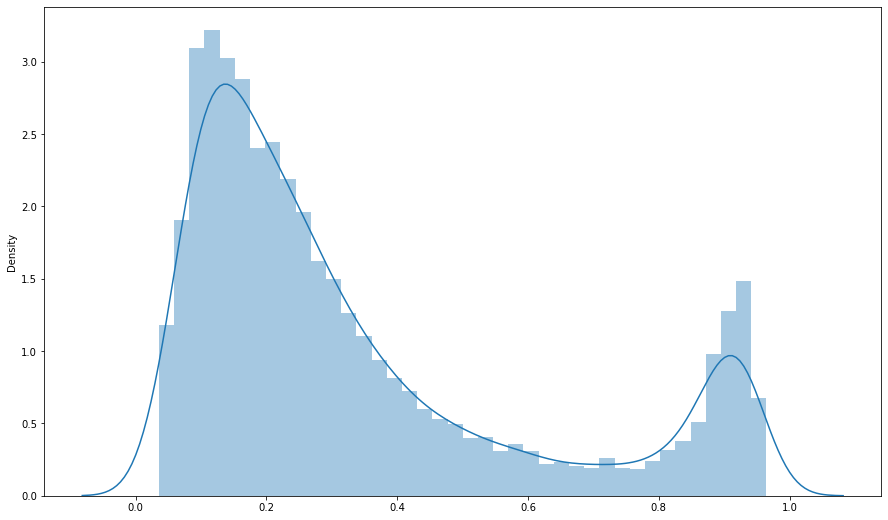

In [202]:
plt.figure(figsize=(15,9))
sns.distplot(pred_ensemble)

In [204]:
file1 = pd.read_csv(default_path+'/result/auc_0.84198/result_new17.csv')

<AxesSubplot:xlabel='problem', ylabel='Density'>

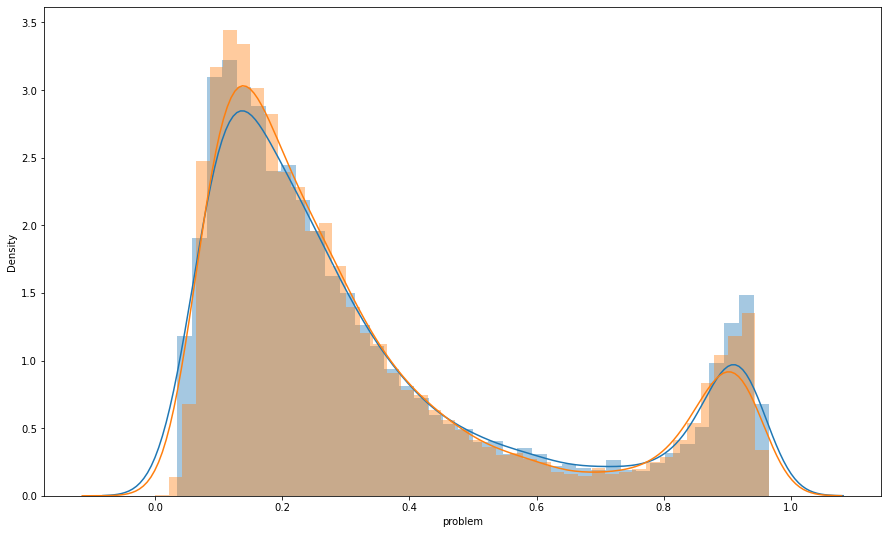

In [213]:
plt.figure(figsize=(15,9))
sns.distplot(pred_ensemble)
sns.distplot(file1['problem'])

In [101]:
sample_sub

,user_id,problem
0,30000,0.950160
1,30001,0.344976
2,30002,0.535445
3,30003,0.834899
4,30004,0.942371
...,...,...
14994,44994,0.326146
14995,44995,0.266059
14996,44996,0.636539
14997,44997,0.895332


In [ ]:
plt.figure(figsize=(15,9))
sns.distplot(pred_ensemble)

In [206]:
sample_sub = pd.read_csv(data_path+'/sample_submission.csv')
sample_sub = sample_sub.drop('problem', axis=1)

In [207]:
pred_y = pd.DataFrame({'user_id':test_data['user_id'], 'problem':pred_ensemble[:,0]})

In [208]:
sample_sub = pd.merge(sample_sub, pred_y, on='user_id', how='left')
sample_sub['problem'] = sample_sub['problem'].fillna(0)

In [209]:
sample_sub.to_csv("result_new27.csv", index = False)

In [69]:
sample_sub

,user_id,problem
0,30000,0.942449
1,30001,0.356814
2,30002,0.526604
3,30003,0.825048
4,30004,0.946660
...,...,...
14994,44994,0.256225
14995,44995,0.280256
14996,44996,0.653727
14997,44997,0.896408


In [ ]:
sample_sub

In [ ]:
plt.figure(figsize=(15,9))
sns.distplot(pred_ensemble)

In [ ]:
a['fwver'].tolist()

In [ ]:
a = [1,2,3]

In [ ]:
a[:1] + [5] + a[1:]